## Курс Профессия Data Science
# Итоговый проект. Бриф “Агентство недвижимости”

### Легенда!!!
К вам обратился представитель крупного агентства недвижимости со
следующей проблемой:  
«Мои риелторы тратят катастрофически много времени на сортировку
объявлений и поиск выгодных предложений. Поэтому их скорость реакции, да
и, сказать по правде, качество анализа не дотягивают до уровня конкурентов.
Это сказывается на наших финансовых показателях.
Ваша задача — разработать модель, которая позволила бы обойти
конкурентов по скорости и качеству совершения сделок. Вот датасет для
работы».  
Что необходимо сделать: разработать сервис для предсказания стоимости
домов на основе истории предложений.  
Ваша задача — разработать модель, которая позволила бы обойти
конкурентов по скорости и качеству совершения сделок.

<img src="picture\PIC.png">


Powered by DALL·E 3

Описание данных:  

    'status' - статус продажи  
    'private pool’ и 'PrivatePool' - наличие частного бассейна,  
    'propertyType' - тип недвижимости, поместья, свойства,  
    'street' - адрес дома  
    'baths' - количество ванных комнат  
    'homeFacts' - сведения о строении дома, содержит несколько отдельных данных, имеющих влияние на оценку недвижимости, дома, квартиры  
    'fireplace' - сведения о наличии камина (ов) в доме  
    'city' - город  
    'schools' - сведения о школах в районе. Название школ, расстояние до школ, рейтинг школ.  
    'sqft' - площадь дома в футах  
    'zipcode' - почтовый индекс  
    'beds' - количество спален в доме  
    'state' - государство/штаты  
    'stories' - этажность недвижимости  
    'mls-id' и 'MlsId' - идентификатор MLS (Multiple Listing Service - Служба множественного листинга). Нашла на просторах интернета - MLS обычно это идентификатор, который вы используете в качестве «имени пользователя» или «логина» для вашей системы MLS, и он может включать буквы, цифры или их комбинацию.  
    'target' - целевой признак, который необходимо спрогнозировать - цена недвижимости  


Важные примечания о данных:  
Признаки 'homeFacts' и 'schools' представляют собой словари и содержат несколько отдельных сведений. Необходимо десериализовать содержимое этих признаков. Если имеются полезные данные, то необходимо из них создать новые признаки.

In [ ]:
# %pip install pandas
# %pip install uszipcode
# %pip install plotly
# %pip install scipy
# %pip install scikit-learn
# %pip install SQLAlchemy==2.0.0
# %pip install sqlalchemy_mate==1.4.28.4
# %pip install Cython
# %pip install geopy
# %pip install tqdm
# %pip install selenium
# %pip install category_encoders


# %pip install catboost
# %pip install optuna
# %pip install xgboost
# %pip install lightgbm

# %conda install -c conda-forge ipywidgets
# %pip install nbformat>=4.2.0
# %pip install python-Levenshtein
# %pip install lxml
# %pip install -U kaleido

# %pip install Flask
# %pip install isort

In [1]:
import sys
sys.path.append('../')

In [2]:
import pickle

import pandas as pd
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)
pd.options.mode.copy_on_write = True

import ast

import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import scipy.stats as stats
from Cython.Build import cythonize
from plotly.subplots import make_subplots
from scipy.stats import jarque_bera, kstest, mode, shapiro
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import PowerTransformer
from uszipcode import SearchEngine

from func import *

%load_ext Cython

In [3]:
n_jobs = -1
random_state = 42
contamination=0.1

In [4]:
url = 'https://www.bu.edu/brand/guidelines/editorial-style/us-state-abbreviations/'
tables = pd.read_html(url)

short_state_name =dict(zip(tables[0][0][1:],tables[0][2][1:]))
print(short_state_name)

# сохранение
with open('data/short_state_name.pkl', 'wb') as output:
    pickle.dump(short_state_name, output)


{'Alabama': 'AL', 'Alaska': 'AK', 'Arkansas': 'AR', 'Arizona': 'AZ', 'California': 'CA', 'Colorado': 'CO', 'Connecticut': 'CT', 'Delaware': 'DE', 'District of Columbia': 'DC', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID', 'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA', 'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN', 'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH', 'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND', 'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI', 'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT', 'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'}


In [5]:
df = pd.read_csv('data/real estate.csv')
df = df.drop_duplicates()
df.head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"


Мой план работ:  
- посмотреть на данные, заполнить пропуски  
- провести разведочный анализ данных.  


Давайте начинать!

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 377135 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337218 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342402 non-null  object
 3   street        377133 non-null  object
 4   baths         270827 non-null  object
 5   homeFacts     377135 non-null  object
 6   fireplace     103112 non-null  object
 7   city          377101 non-null  object
 8   schools       377135 non-null  object
 9   sqft          336585 non-null  object
 10  zipcode       377135 non-null  object
 11  beds          285881 non-null  object
 12  state         377135 non-null  object
 13  stories       226462 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40310 non-null   object
 16  MlsId         310266 non-null  object
 17  target        374655 non-null  object
dtypes: object(18)
memory usa

In [7]:
df.describe()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
count,337218,4181,342402,377133,270827,377135,103112,377101,377135,336585,377135,285881,377135,226462,24942,40310,310266,374655
unique,159,1,1280,337076,229,321009,1653,2026,297365,25405,4549,1184,39,348,24907,2,232944,43939
top,for sale,Yes,single-family home,Address Not Disclosed,2 Baths,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",yes,Houston,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,32137,3 Beds,FL,1.0,No MLS#,yes,NO MLS,"$225,000"
freq,156058,4181,92199,672,52458,7174,50353,24441,4204,11854,2141,53454,115434,67451,3,28792,24,1462


Ни одного числового столбца, модели машинного обучения любят числа. Надо будет провести предобработку и по-возможности перевети текст в цифры. Далее достаточно много пропусков - надо будет либо удальть часть данных, либо заполнить недостающие значения.  

Приведу таргет в числовой вид.

In [8]:
# df['target'].sort_values()

In [9]:
df[df['target']==1]['target'].count()

0

Сразу вижу, что есть значения NaN в таргете. Без  реальных значений цены  мы не сможем обучать модель, поэтому сразу удалю эти строки. Цена в 1 бакс смущает, это значит, что продавцы хотят показать обьявление, но цена по запросу. Таких обьявлений всего 15 - удалю их.

In [10]:
df = df.dropna(subset=['target'])
df = df[df['target']!=1]

Проверим, что интересного зашито в цене

In [11]:
df['target'] = df['target'].str.replace('$','').str.replace(',','').str.replace(' ','').str.replace('+','')
temp = []
df['target'].apply(lambda x: x if x.isdigit() else temp.append(x))
print(len(temp),temp, sep='\n')

C:\Users\olgas\AppData\Local\Temp\ipykernel_10476\9642939.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df['target'] = df['target'].str.replace('$','').str.replace(',','').str.replace(' ','').str.replace('+','')


398
['5500/mo', '10500/mo', '6390/mo', '1200/mo', '3600/mo', '5500/mo', '1200/mo', '1200/mo', '3250/mo', '1400/mo', '4999/mo', '1250/mo', '2900/mo', '2250/mo', '1495/mo', '5000/mo', '3950/mo', '1095/mo', '3800/mo', '4500/mo', '3500/mo', '3000/mo', '35000/mo', '6000/mo', '32500/mo', '2699/mo', '6900/mo', '1600/mo', '1000/mo', '950/mo', '1070/mo', '1395/mo', '8500/mo', '2800/mo', '1100/mo', '800/mo', '1400/mo', '1950/mo', '12500/mo', '1100/mo', '950/mo', '1400/mo', '4200/mo', '2300/mo', '2200/mo', '3999/mo', '1200/mo', '1950/mo', '2250/mo', '1790/mo', '2490/mo', '1000/mo', '1300/mo', '1550/mo', '1800/mo', '2250/mo', '3500/mo', '2400/mo', '7000/mo', '2600/mo', '1400/mo', '1750/mo', '3900/mo', '4295/mo', '3100/mo', '3000/mo', '4600/mo', '2100/mo', '1695/mo', '2200/mo', '1800/mo', '2600/mo', '1895/mo', '4100/mo', '2500/mo', '1350/mo', '600/mo', '2300/mo', '4200/mo', '1300/mo', '4200/mo', '1700/mo', '1895/mo', '3300/mo', '3500/mo', '1495/mo', '1200/mo', '900/mo', '2800/mo', '6000/mo', '2800/

Некоторые цены указаны с пометкой "/mo" - это явное указание на аренду. Эти данные для предсказания цены продажи нам не помогут, их следует удалить.

In [12]:
df['rent'] = df['target'].apply(lambda x: True if '/mo' in x else False)
df['target'] = df['target'].apply(lambda x: float(str(x).replace('/mo','').replace('1215-1437','0')) if '/mo' in x else x)

In [13]:
df[df['rent'] ==1]['target'].sort_values()

330468        0.0
73310       600.0
328863      700.0
127456      750.0
363582      750.0
           ...   
97552     19750.0
302818    27500.0
23823     32500.0
22947     35000.0
182116    72500.0
Name: target, Length: 398, dtype: object

In [14]:
df = df[df['rent']==False]

In [15]:
df['target'] = df['target'].astype('int')
df['target']

0          418000
1          310000
2         2895000
3         2395000
4            5000
           ...   
377180    1249000
377181     674999
377182     528000
377183      34500
377184     204900
Name: target, Length: 374257, dtype: int32

Выдерну блок из второй части, чтобы уменьшить количество данных на обработке

In [16]:
# ищем выбросы в обучающей выборке
iso = IsolationForest(contamination=0.1,
                    n_jobs=n_jobs,
                    random_state=random_state)
y_predicted = iso.fit_predict(df[['target']])

# выберем все строки, которые не являются выбросами
mask = y_predicted != -1
df = df[mask]
df = df[df['target']>10000]

px.histogram(df['target'],
             marginal='box',
             orientation='v',
             text_auto=True,)#.show('png')

'mls-id' и 'MlsId' - идентификатор MLS (Multiple Listing Service - Служба множественного листинга). Нашла на просторах интернета - MLS обычно это идентификатор, который вы используете в качестве «имени пользователя» или «логина» для вашей системы MLS, и он может включать буквы, цифры или их комбинацию.

In [17]:
df= df.drop(['mls-id','MlsId'],axis=1)

Поработаю со State.

Хочу проверитьесть ли ошибки в названиях штатов. Для этого возьму какой-нибудь сайт и извлеку из него данные о сокращенном названии штатов.
Если будут ошибки, то исправлю, с использованием zipcode.

In [19]:
df['state'] = df['state'].str.upper()
df['state_st'] = df['state'].apply(lambda x: False if x in short_state_name.values() else True)
print(df['state_st'].sum())
df[df['state_st']==1]

3


,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,PrivatePool,target,rent,state_st
172273,Active,NaN,NaN,"Mar Grande SE Quadra A, Lotes 9,10, 11 & 12",NaN,"{'atAGlanceFacts': [{'factValue': '1900', 'fac...",NaN,,"[{'rating': [], 'data': {'Distance': [], 'Grad...","7,728",33179,NaN,BA,NaN,NaN,225000,False,True
193466,Active,NaN,NaN,55 E 1476 Land W,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Other,"[{'rating': [], 'data': {'Distance': [], 'Grad...",NaN,11210,NaN,OT,NaN,NaN,50000,False,True
308229,Active,NaN,NaN,435 pescador,NaN,"{'atAGlanceFacts': [{'factValue': '1972', 'fac...",NaN,Foreign Country,"[{'rating': [], 'data': {'Distance': [], 'Grad...","1,100",00000,NaN,OS,NaN,NaN,125000,False,True


В этих данных много пропусков, поэтому лучше их удалить.

In [20]:
df = df[df['state_st']!=1]

Zipcode.  
Возможно эти данные не пригодятся, но узнаю об этом позже, когда начну обучать модель, а сейчас  обработаю данные.  

Zip code может просто отсутствовать или вместо значения указана белиберда. Исправим это.  
В основном у нас данные из США. обычный zipcode в США - 5 значный, расширенный (для почтовых служб *****-****), но нас интересует только первые 5 цифр.  
Может быть несколько вариантов - нет zipcode или не стандартный (больше или меньше 5 цифр). Отсутствие zipcode заполню с помощью адреса, а не стандартный проверю в чем причина.

In [21]:
df.zipcode.isnull().sum()

0

In [22]:
df['zipcode'] = df['zipcode'].astype('str')
df.zipcode = df.zipcode.apply(lambda x: str(x).split(sep='-')[0])

In [23]:
df[['street','city','zipcode','state']].sort_values('zipcode')[:7]

,street,city,zipcode,state
235207,1744 N Dixie Hwy # 1744,Fort Lauderdale,,FL
30261,Gates Canyon Rd,Vacaville,0,CA
83522,Cornejo Ricardo Descalzi,Quito Ecuador,0,NY
177402,49 Beacon St UNIT 1,Boston,02108,MA
231252,88 Mount Vernon St APT 31,Boston,02108,MA
336274,97 Mount Vernon St UNIT 24,Boston,02108,MA
106587,43 Winter St SUITE 3,Boston,02108,MA


In [24]:
# Плюс нашлись такие значения - названия городов!
a = list(df['city'].sort_values().unique())
a[1320:1330]

['Pensacola',
 'Peoria',
 'Pepper Pike',
 'Perdido Key',
 'Perrine',
 'Perrysburg',
 'Pete Beach',
 'Petersburg',
 'Pfafftown',
 'Pflugerville']

пропущенных значений всего 5 можно заполнить руками  
Если есть сомнения, то сайт https://tools.usps.com/zip-code-lookup.htm?byaddress в помощь  
Так как вся наша база основана на гордах США, то города из других стран удалю.  

In [25]:
df = df[df['city']!='Foreign Country']

In [26]:
# 231282	0 N Gopher Canyon Rd	Bonsall		CA
# print(find_zip('Bonsall','CA'))
df.loc[231282, 'zipcode'] = find_zip('Bonsall', 'CA')[0]


#  235207	1744 N Dixie Hwy # 1744	Fort Lauderdale		FL
# print(find_zip('Fort Lauderdale','FL'))
# print(find_zip_usps_from_adress('1744 N Dixie Hwy # 1744','Fort Lauderdale','FL'))
df.loc[235207, 'zipcode'] = find_zip_usps_from_adress(
                        '1744 N Dixie Hwy # 1744', 'Fort Lauderdale', 'FL')


#   305572	000 U.S. Hwy 359	Laredo	0	TX
# print(find_zip('Laredo','TX'))
# print(find_zip_usps_from_adress('Hwy 359','Laredo','TX'))
df.loc[305572, 'zipcode'] = find_zip_usps_from_adress(
                        'Hwy 359', 'Laredo', 'TX')


#   83522	Cornejo Ricardo Descalzi	Quito Ecuador	0	NY
# print(find_zip('Quito Ecuador','NY'))
df.loc[83522, 'zipcode'] = find_zip('Quito Ecuador', 'NY')[0]


# 30261 Gates Canyon Rd Vacaville	0	CA
# print(find_zip('Vacaville','CA'))
# print(find_zip_usps_from_adress('Gates Canyon Rd','Vacaville','CA'))
df.loc[30261, 'zipcode'] = find_zip_usps_from_adress(
                        'Gates Canyon Rd', 'Vacaville', 'CA')

In [27]:
df[['street','city','zipcode','state']].sort_values('zipcode')

,street,city,zipcode,state
106587,43 Winter St SUITE 3,Boston,02108,MA
231252,88 Mount Vernon St APT 31,Boston,02108,MA
336274,97 Mount Vernon St UNIT 24,Boston,02108,MA
177402,49 Beacon St UNIT 1,Boston,02108,MA
207262,357 Commercial St APT 008,Boston,02109,MA
...,...,...,...,...
23597,1161 S Harrison St,Kennewick,99338,WA
306609,108133 E 217th Pr SE,Kennewick,99338,WA
62713,Nka S Clodfelter #1,Kennewick,99338,WA
87450,1125 S Harrison St,Kennewick,99338,WA


In [28]:
df['len_zip'] = df['zipcode'].apply(lambda x: len(x))
print('варианты длины zipcode', df['len_zip'].unique())

варианты длины zipcode [5 4 6]


Приведу zipcode  к пятизначному виду

In [29]:
df['perd_zip'] = None
a = df[df['len_zip']==4].index


for i in a[:10]:
    df.loc[i,'perd_zip'] = str(find_zip(str(df.loc[i,'city']),str(df.loc[i,'state'])))


df[df['len_zip']==4][['zipcode','perd_zip']][:10]

,zipcode,perd_zip
69,8701,['08701']
78,2127,"['02108', '02109', '02110', '02111', '02113']"
129,1604,"['01602', '01603', '01604', '01605', '01606']"
344,5488,['05488']
410,5445,['05445']
809,2128,['02128']
920,5450,['05450']
928,5452,[]
1321,1128,"['01103', '01104', '01105', '01107', '01108']"
1942,7004,['07004']


Путем проверки части zipcode пришла к выводу, что 4х значные коды это просто не хватает 0 перед значащими цифрами! Добавлю его

In [30]:
df['zipcode'] = df['zipcode'].apply(lambda x: '0' + x if len(x)==4 else x)

Проверим случаи, когда zipcode > 5 цифр 

In [31]:
df[df['len_zip']>5][['street','city','zipcode','state']]

,street,city,zipcode,state
85581,6789 White River Home,Other City Value - Out Of Area,123456,NY
133901,2315 Gerritsen Ave Unit 3A,Brooklyn,112229,NY
161389,301 Altara #402,Coral Gables,331446,FL


Таких вариантов всего три и на лицо - один неизвестный город. Я его удалю (предсказания с такими данными как в карточке сложно делать). В двух других случаях - ошибка пользоваталя, исправлю.

In [32]:
#   133901	2315 Gerritsen Ave Unit 3A	Brooklyn	112229	NY
print(find_zip('Brooklyn','NY'))
print(find_zip_usps_from_adress('2315 Gerritsen Ave Unit 3A','Brooklyn','NY'))
df.loc[133901,'zipcode'] = find_zip_usps_from_adress('2315 Gerritsen Ave Unit 3A','Brooklyn','NY')


#161389	301 Altara #402	Coral Gables	331446	FL  33146
print(find_zip('Coral Gables','FL'))
print(find_zip_usps_from_adress('301 Altara #402','Coral Gables','FL'))
df.loc[161389,'zipcode'] = find_zip_usps_from_adress('301 Altara #402','Coral Gables','FL')

# 85581	6789 White River Home	Other City Value - Out Of Area	123456	NY
df = df[df.zipcode!='123456']

['11201', '11203', '11204', '11205', '11206']
11229
[]
33146


In [33]:
df['predict_state'] = df['zipcode'].apply(find_state)

In [34]:
df['compare_state'] = df.apply(lambda row: (True if pd.isna(row['zipcode']) or (row['predict_state']!=row['state']) else False),axis=1)
df[(df['compare_state']==True)][['zipcode','predict_state','state','city']]

,zipcode,predict_state,state,city
8268,99338,None,WA,Kennewick
9083,99338,None,WA,Kennewick
19124,99338,None,WA,Kennewick
23597,99338,None,WA,Kennewick
24403,90109,None,WA,Seattle
...,...,...,...,...
371888,17238,PA,TN,Needmore
373281,99338,None,WA,Kennewick
374153,37620,TN,VA,Bristol
231282,92003,CA,NaN,NaN


In [35]:
# United States
# Durham, Arkansas
# Durham, California
# Durham, Colorado, a place in Mesa County
# Durham, Connecticut, a New England town
# Durham (CDP), Connecticut, the central village in the town
# Durham, Florida, a place in Calhoun County
# Durham, Georgia
# Durham Township, Hancock County, Illinois
# Durham, Gibson County, Indiana, a place in Union Township
# Durham, La Porte County, Indiana, a place in New Durham Township
# Durham, Kansas
# Durham, Maine
# Durham, Missouri
# Durham, New Hampshire, a New England town
# Durham (CDP), New Hampshire, the main community in the town
# Durham, New York
# Durham, Oklahoma
# Durham, Oregon
# Durham, Pennsylvania


# Lakewood

# United States
# Lakewood, California, a city in Los Angeles County
# Lakewood, Colorado, a city in Jefferson County
# Lakewood, Illinois, a village in McHenry County
# Lakewood Balmoral Historic District, Chicago, Illinois
# Lakewood, Indiana, a census-designated place
# Lakewood, Iowa, a ghost town in Lyon County
# Lakewood Township, New Jersey, a township
# Lakewood, New Orleans, Louisiana
# Lakewood, Michigan, an unincorporated community and abandoned summer resort by Long Lake
# Lakewood (CDP), New Jersey, a census-designated place in Lakewood Township, New Jersey
# Lakewood, New York, a village in Chautauqua County
# Lakewood, Ohio, a large city in Cuyahoga County, and part of the Greater Cleveland Metropolitan area
# Lakewood, Oregon
# Lakewood, Pennsylvania, a village in Wayne County
# Lakewood, South Carolina, a census-designated place in Sumter County
# Lakewood, Tennessee, a neighborhood of Nashville, once a small city
# Lakewood, Dallas, Texas, a neighborhood
# Lakewood, Washington, a city in Pierce County
# Lakewood, Wisconsin, a town in Oconto County
# Lakewood (CDP), Wisconsin, an unincorporated census-designated place in Oconto County

In [36]:
# Spring, Texas
# Колора́до-Спрингс, Колорадо

# 169554	77380	TX	TN	Spring
df.loc[169554,'state'] = find_state(77380)

In [37]:
# Бристол (англ. Bristol) — город в округе Салливан штата Теннесси (США). Вместе с городом Бристол в штате Виргиния образует единый город,
# Это не ошибка, это формальность раз город сразу на ва штата!
# 161877	37620	TN	VA	Bristol
df.loc[161877,'state'] = find_state(37620)

# 374153	37620	TN	VA	Bristol
df.loc[374153,'state'] = find_state(37620)

In [38]:
# 200457	78501	TX	FL	Other City Not In the State of Florida
# 325918	78501	TX	FL	--
# 231282	92003	CA	NaN	NaN
# 130563	20003	DC	MA	NaN
# 332895	05940	None	FL	Other City Value - Out Of Area
# Неизвестный город в неизвестном штате!!!
df = df[df.index != 200457]
df = df[df.index != 325918]
df = df[df.index != 231282]
df = df[df.index != 130563]
df = df[df.index != 332895]

In [39]:
# Playa del Rey, Los Angeles
# Playa Vista, Los Angeles
# La Playa, San Diego
# Beach City, Texas

print(find_city(77710))
# ['Beaumont']

# 86503	77710	TX	DE	Playa
# 101135	77720	TX	DE	Playa
# 122666	77720	TX	DE	Playa
# 143930	77710	TX	DE	Playa
# 336631	77710	TX	DE	Playa

# Название штата, города и zip, пожалуй удалю эти данные!

df = df[df.index != 86503]
df = df[df.index != 101135]
df = df[df.index != 122666]
df = df[df.index != 143930]
df = df[df.index != 336631]

['Beaumont', 'Beaumont']


In [40]:
# Needmore может означать:

# Нидмор, Арканзас
# Нидмор, округ Брэнтли, штат Джорджия , вдоль трассы штата Джорджия 32
# Нидмор, округ Эколс, Джорджия
# Нидмор, округ Браун, штат Индиана
# Нидмор, округ Лоуренс, штат Индиана
# Нидмор, округ Вермиллион, Индиана
# Нидмор, округ Баллард, Кентукки
# Нидмор, округ Оуэн, Кентукки
# Нидмор, Миссури
# Нидмор, Пенсильвания
# Нидмор, округ Бейли, Техас
# Нидмор, округ Терри, Техас
# Нидмор, Вирджиния
# Нидмор, Западная Вирджиния
# Нидмор, дом Уильяма Овертона Каллиса в Вирджинии


# TN - штат Теннеси - противоречие, буду считать что это Пенсельвания


# 54590	17238	PA	TN	Needmore
df.loc[54590,'state'] = find_state(17238)

# 357391	17238	PA	TN	Needmore
df.loc[357391,'state'] = find_state(17238)

# 371888	17238	PA	TN	Needmore
df.loc[371888,'state'] = find_state(17238)

# 216102	17238	PA	TN	Needmore
df.loc[216102,'state'] = find_state(17238)

# 231581	17238	PA	TN	Needmore
df.loc[231581,'state'] = find_state(17238)

# 265907	17238	PA	TN	Needmore
df.loc[265907,'state'] = find_state(17238)

# 300581	17238	PA	TN	Needmore
df.loc[300581,'state'] = find_state(17238)

In [41]:
# Санта-Ана, Калифорния
# Город Санта-Анна, округ ДеВитт, Иллинойс , тауншип
# Санта-Ана Пуэбло, Нью-Мексико
# Санта-Анна, Техас — город в округе Коулман в Центральном Техасе, США.
# Санта-Анна, округ Старр, Техас
# Сент-Анна, Висконсин

# TN - штат Теннеси - противоречие, буду считать что это Калифорния

# 110102	92703	CA	TN	Santa Ana
df.loc[110102,'state'] = find_state(92703)

# 356815	92703	CA	TN	Santa Ana
df.loc[356815,'state'] = find_state(92703)

Опечатки с zipcode исправила.

In [42]:
url = 'https://www.bu.edu/brand/guidelines/editorial-style/us-state-abbreviations/'
tables = pd.read_html(url)

short_state_name =dict(zip(tables[0][0][1:],tables[0][2][1:]))
print(short_state_name)

{'Alabama': 'AL', 'Alaska': 'AK', 'Arkansas': 'AR', 'Arizona': 'AZ', 'California': 'CA', 'Colorado': 'CO', 'Connecticut': 'CT', 'Delaware': 'DE', 'District of Columbia': 'DC', 'Florida': 'FL', 'Georgia': 'GA', 'Hawaii': 'HI', 'Idaho': 'ID', 'Illinois': 'IL', 'Indiana': 'IN', 'Iowa': 'IA', 'Kansas': 'KS', 'Kentucky': 'KY', 'Louisiana': 'LA', 'Maine': 'ME', 'Maryland': 'MD', 'Massachusetts': 'MA', 'Michigan': 'MI', 'Minnesota': 'MN', 'Mississippi': 'MS', 'Missouri': 'MO', 'Montana': 'MT', 'Nebraska': 'NE', 'Nevada': 'NV', 'New Hampshire': 'NH', 'New Jersey': 'NJ', 'New Mexico': 'NM', 'New York': 'NY', 'North Carolina': 'NC', 'North Dakota': 'ND', 'Ohio': 'OH', 'Oklahoma': 'OK', 'Oregon': 'OR', 'Pennsylvania': 'PA', 'Rhode Island': 'RI', 'South Carolina': 'SC', 'South Dakota': 'SD', 'Tennessee': 'TN', 'Texas': 'TX', 'Utah': 'UT', 'Vermont': 'VT', 'Virginia': 'VA', 'Washington': 'WA', 'West Virginia': 'WV', 'Wisconsin': 'WI', 'Wyoming': 'WY'}


В процессе заполнения пропусков в городах обнаружила '02105','03316','05642','05940','22703','27000','33000','33249','38818','44037','78697','90109','98489','98798', инвалидных zip code.
Проверю, какие города или удалю эти строки данных.  
Проблема со строками 
204239 ('33000'),
267586('02105'),
330500('38818'),
332895('05940'),



In [43]:
temp = df[['street','city','state','zipcode']].query("zipcode in ['03316','05642','22703','27000','33249','44037','90109','98489','98798']")
for i in temp.index:
    print(i,'df.zip',df.loc[i,'zipcode'])
    print(find_zip_usps_from_adress(df.loc[i,'street'] ,df.loc[i,'city'],df.loc[i,'state']))
    df.loc[i,'zipcode'] = find_zip_usps_from_adress(df.loc[i,'street'] ,df.loc[i,'city'],df.loc[i,'state'])
    print()

24403 df.zip 90109
98109

50596 df.zip 03316
33169

76370 df.zip 98489
98498

99909 df.zip 05642
05462

104961 df.zip 33249
33149

181900 df.zip 22703
27703

287583 df.zip 27000
30310

328278 df.zip 44037
44139

357176 df.zip 98798
98198



In [44]:
df[['street','city','state','zipcode']].query("zipcode in ['33000','02105','38818','05940']")

,street,city,state,zipcode
204239,80 SW 177 Ave,Miami,FL,33000
267586,0 Airport Rd,Winston Salem,NC,02105
330500,0 American Way Rd,Memphis,TN,38818


In [45]:
temp = df[['street','city','state','zipcode']].query("zipcode in ['33000','02105','38818','05940']")
for i in temp.index:
    print(i,'df.zip',df.loc[i,'zipcode'])
    print(find_zip(df.loc[i,'city'],df.loc[i,'state']))
    print()

204239 df.zip 33000
['33122', '33125', '33126', '33127', '33128']

267586 df.zip 02105
['27101', '27103', '27104', '27105', '27106']

330500 df.zip 38818
['38103', '38104', '38105', '38106', '38107']



Вероятно в адресе ошибка. Поправим

In [46]:
# 267586	Airport Rd	Winston Salem	NC	02105
i = 267586 
df.loc[i,'street'] = 'Airport Rd'
print(find_zip_usps_from_adress(df.loc[i,'street'] ,df.loc[i,'city'],df.loc[i,'state']))
df.loc[i,'zipcode'] = find_zip_usps_from_adress(df.loc[i,'street'] ,df.loc[i,'city'],df.loc[i,'state'])

27105


In [47]:
# 330500	0 American Way Rd	Memphis	TN	38818

i = 330500 
df.loc[i,'street'] = 'American Way Rd'
print(find_zip_usps_from_adress('American Way Rd' ,'Memphis' ,'TN'))
df.loc[i,'zipcode'] = 38118

38118


In [48]:
# 204239	80 SW 177 Ave	Miami	FL	33000
df = df[df.zipcode!='33000']

City

Среди странных названий городов - были замечены, 
 'Other',  
 'Other City - In The State Of Florida',  
 'Other City Not In the State of Florida',  
 'Other City Value - Out Of Area',  
 'Other City Value Out Of Area',  
 'Outside Area (Outside Ca)',  
 'Other city value - out of area'
 Other City Value - Out Of Area


Сравню название города и название найденное с помощью zipcode. Возможно найду несоответствия

In [49]:
df['city_predict'] = df.zipcode.apply(find_city)

In [50]:
df['city'] = df['city'].str.title()

In [51]:
df['compare'] = df.apply(lambda row: compare_city(row),axis=1 )
df['compare'].mean()

0.9721259283332732

In [52]:
df[df['compare']==0][['street','city','city_predict',
                    'zipcode',#'state',
                    ]]

,street,city,city_predict,zipcode
32,2043 SE New York St,Pt Saint Lucie,"[Port Saint Lucie, Port Saint Lucie, Fort Pier...",34952
43,2713 Oakmont Ct,Weston,"[Fort Lauderdale, Fort Lauderdale, Davie, Ft L...",33332
58,4146 Diaz Ct,Hernando Beach,"[Spring Hill, Spring Hill, Brooksville, Hernan...",34607
99,2649 NW 48th Ter #431,Lauderdale Lakes,"[Fort Lauderdale, Fort Lauderdale, City Of Sun...",33313
103,4174 Inverrary Dr #704,Lauderhill,"[Fort Lauderdale, Fort Lauderdale, Ft Lauderda...",33319
...,...,...,...,...
377020,3690 Inverrary Dr Unit 3T,Lauderhill,"[Fort Lauderdale, Fort Lauderdale, Ft Lauderda...",33319
377047,3330 Spanish Moss Ter #408,Lauderhill,"[Fort Lauderdale, Fort Lauderdale, Ft Lauderda...",33319
377063,1901 NE 186th Dr,North Miami Beach,"[Miami, Miami, Miami Gardens, N Miami Beach, N...",33179
377172,2210 NW 70th Ave,Sunrise,"[Fort Lauderdale, Fort Lauderdale, City Of Sun...",33313


некторые города легко исправить вручную

In [53]:
temp = {'Pt Saint Lucie':'Port Saint Lucie',
        'Saint Lucie':'Port Saint Lucie',
        'East Pt':'East Point',
        'Olmsted Township':'Olmsted Twp',
        'Fairfield Twp':'Fairfield',
        'High Pt':'High Point',
        'St. Albans City':'Saint Albans',
        'East Los Angeles':'Los Angeles',
        'Manhattan':'New York',
        'St. George':'Saint George',
        'College Pt':'College Point',
        'Pt Isabel':'Port Isabel',
        'Soddy-daisy':'Soddy Daisy',
        'St. Petersburg':'Saint Petersburg',
        'Cherryhillsvillage':'Cherry Hills Village',
        'Commercecity':'Commerce City',
        'Wheatridge':'Wheat Ridge',
        'Hideaway Hills':'Hideaway Hls',
        'Piney Pt Village':'Piney Point Village',
        'Yarrow Pt':'Yarrow Point',
        'Valley Glen':'Valley Glen',
        'Federalheights':'Federal Heights',
        'Ft. Worth':'Fort Worth',
        'North Pt':'North Port',
        'St. Johns':'Saint Johns',
        'Opa-locka':'Opa Locka',
        'Redford Township':'Redford',
        'Saint Pete Beach':'St Pete Beach',
        'Mcdowell':'Mc Dowell',
        'Poughkeepsie City':'Poughkeepsie',
        'County Los Angeles':'Los Angeles',
        'Toluca Lake': 'Toluca Terrace',
        'Boston (dorchester)':'Boston',
        'Hide A Way Hills':'Hideaway Hls',
        'Jackson Township': 'Jacksn Belden',
        'Hollywood Hills': 'West Hollywood',
        'Jc':'Johnson City',
        'West Panama City Beach':'Panama City Beach',
        "Town 'n' Country": 'Twn N Cntry',
        'Old Brooklyn':'Brooklyn',
        'Saint Albans City':'Saint Albans',
        'Saint Albans Town':'Saint Albans',
        'St Pete Beach':'Saint Pete Beach',
        'Mc Allen':'Mcallen',
        'South Houston':'Houston',
        'Town North Country':'Twn N Cntry',
        'North Miami': 'North Miami Beach',
        'Downtown Pgh':	'Pittsburgh',
        'Oklawaha':'Ocklawaha',
        'Enosburg':'Enosburg Falls',
        'Silver Lake':'Los Angeles',
        'New York City':'New York',
        'El Sereno':'Los Angeles',
        'Soddy-Daisy':'Soddy Daisy',
        'St. Albans Town':'Saint Albans',
        'Fairfield Twp.':'Fairfield',
        'St Pete':'Saint Petersburg',
        'St Louis':'Saint Louis',
        'Asheville City':'Asheville',
        'Oak':'Live Oak',
        'Belllingham':'Bellingham',
        'Saranac Vlg':'Saranac',
        'Vegas':'Las Vegas',
        'Opa-Locka':'Opa Locka', 
        'Unincorporated':'Memphis',
        'St Albans City':'Saint Albans',
        'Pt Arthur':'Port Arthur',
        'E. New York':'Brooklyn',
        'Allentown City':'Allentown',
        'Jamaica Est':'Jamaica',
        'East Durham':'Durham',
        'Nassau Bay':'Houston',
        'Nyc':'New York',
        'Mem':'Memphis',
        'S.A.':'San Antonio',
        'Yarmouth Pt':'Yarmouth Port',
        'Sa':'San Antonio',
        }

df.city = df.city.replace(temp)

In [54]:
df['compare'] = df.apply(lambda row: compare_city(row),axis=1 )
df['compare'].mean()

0.9734499693063229

In [55]:
df[df['compare']==0][['street','city','city_predict',
                    'zipcode',#'state',
                    ]]

,street,city,city_predict,zipcode
43,2713 Oakmont Ct,Weston,"[Fort Lauderdale, Fort Lauderdale, Davie, Ft L...",33332
58,4146 Diaz Ct,Hernando Beach,"[Spring Hill, Spring Hill, Brooksville, Hernan...",34607
99,2649 NW 48th Ter #431,Lauderdale Lakes,"[Fort Lauderdale, Fort Lauderdale, City Of Sun...",33313
103,4174 Inverrary Dr #704,Lauderhill,"[Fort Lauderdale, Fort Lauderdale, Ft Lauderda...",33319
105,9715 Charles Dr,Valley View,"[Cleveland, Cleveland, Garfield Heights, Garfi...",44125
...,...,...,...,...
377059,1465 NE 123rd St #808,North Miami Beach,"[Miami, Miami, Biscayne Park, Miami Shores, No...",33161
377063,1901 NE 186th Dr,North Miami Beach,"[Miami, Miami, Miami Gardens, N Miami Beach, N...",33179
377078,Undisclosed Address,North Miami Beach,"[Miami, Miami, Biscayne Park, Miami Shores, No...",33161
377172,2210 NW 70th Ave,Sunrise,"[Fort Lauderdale, Fort Lauderdale, City Of Sun...",33313


In [56]:
df[df['compare']==0][['street','city','city_predict',
                    'zipcode',#'state',
                    ]].head()

,street,city,city_predict,zipcode
43,2713 Oakmont Ct,Weston,"[Fort Lauderdale, Fort Lauderdale, Davie, Ft L...",33332
58,4146 Diaz Ct,Hernando Beach,"[Spring Hill, Spring Hill, Brooksville, Hernan...",34607
99,2649 NW 48th Ter #431,Lauderdale Lakes,"[Fort Lauderdale, Fort Lauderdale, City Of Sun...",33313
103,4174 Inverrary Dr #704,Lauderhill,"[Fort Lauderdale, Fort Lauderdale, Ft Lauderda...",33319
105,9715 Charles Dr,Valley View,"[Cleveland, Cleveland, Garfield Heights, Garfi...",44125


In [57]:
df['city_predict_usps'] = df.apply(lambda row: change_city_name(row),axis=1 )

In [58]:
# # Производим сериализацию и записываем результат в файл формата pkl
with open('data/df_1_1.pkl', 'wb') as output:
    pickle.dump(df, output)

df.to_csv('data/df_1_1.csv',
          index_label=False
          )

In [85]:
# # # Производим десериализацию и извлекаем из файла формата pkl
with open('data/df_1_1.pkl', 'rb') as pkl_file:
    df = pickle.load(pkl_file)

# df = pd.read_csv('data/df_1.csv',
#                  low_memory=False)
df.head()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,PrivatePool,target,rent,state_st,len_zip,perd_zip,predict_state,compare_state,city_predict,compare,city_predict_usps
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,418000.0,False,False,5,None,NC,False,"[Southern Pines, Southern Pines, Southern Pnes]",True,Southern Pines
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,310000.0,False,False,5,None,WA,False,"[Spokane, Spokane, Spokane Valley, Spokane Vly]",True,Spokane Valley
5,for sale,NaN,townhouse,1624 S Newkirk St,NaN,"{'atAGlanceFacts': [{'factValue': '1920', 'fac...",NaN,Philadelphia,"[{'rating': [], 'data': {'Distance': [], 'Grad...",897 sqft,19145,2 Beds,PA,2.0,NaN,209000.0,False,False,5,None,PA,False,"[Philadelphia, Philadelphia, Phila]",True,Philadelphia
6,Active,NaN,Florida,552 Casanova Ct,NaN,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",NaN,Poinciana,"[{'rating': ['3', '3', '1', 'NR'], 'data': {'D...","1,507",34759,NaN,FL,One,NaN,181500.0,False,False,5,None,FL,False,"[Kissimmee, Kissimmee, Poinciana]",True,Poinciana
7,Active,NaN,NaN,6094 Mingle Dr,NaN,"{'atAGlanceFacts': [{'factValue': '1976', 'fac...",NaN,Memphis,"[{'rating': ['4', '2', '2'], 'data': {'Distanc...",NaN,38115,NaN,TN,NaN,NaN,68000.0,False,False,5,None,TN,False,"[Memphis, Memphis, Hickory Hill]",True,Memphis


In [86]:
df['city'] = df.apply(lambda row: change_city_predict_usps(row),axis=1)
df['compare'] = df.apply(lambda row: compare_city_usps(row),axis=1 )
df[df['compare']==0][['compare','street','city','city_predict_usps',
                    'zipcode','state',
                    ]]

,compare,street,city,city_predict_usps,zipcode,state
509,False,3211 SW 44th St APT 103,Dania Beach,"[Fort Lauderdale, Davie, Ft Lauderdale, Lauder...",33312,FL
566,False,2573 E Wyandotte Ct,Chino,"[Ontario, Montclair]",91762,CA
985,False,24411 Sunny Glen Ct,Houston,[Huffman],77336,TX
1737,False,695 NE 130th St,North Miami Beach,"[Miami, Biscayne Park, Miami Shores, North Miami]",33161,FL
1971,False,34 Nantucket Row #34,Middleburg Heights,"[Rocky River, Cleveland]",44116,OH
...,...,...,...,...,...,...
376771,False,445 NE 131st St,North Miami Beach,"[Miami, Biscayne Park, Miami Shores, North Miami]",33161,FL
376879,False,2036 Sailfish Pl,Lauderdale By The Sea,"[Pompano Beach, Hillsboro Bch, Hillsboro Beach]",33062,FL
376902,False,9024 216th St,Queens,"[Queens Village, Bellerose Manor, Bellrs Manor...",11428,NY
377059,False,1465 NE 123rd St #808,North Miami Beach,"[Miami, Biscayne Park, Miami Shores, North Miami]",33161,FL


При таких несоответствиях возможно несколько вариантов. Либо неточно указали город либо неправильно указали zipcode  
Можно удалить эти строки, но пока оставлю

In [87]:
df['street'].value_counts(dropna=0)[:50]

Address Not Disclosed            622
Undisclosed Address              459
(undisclosed Address)            354
Address Not Available            167
Unknown Address                   71
2103 E State Hwy 21               57
11305 Gulf Fwy                    54
17030 Youngblood Rd.              38
NE 58th Cir                       34
9470 Lancaster Rd. SW             32
1 Palmer Dr                       27
9845 Basil Western Rd NW          25
8426 Terrace Valley Circle        25
6320 SW 89th Court Road           24
8447 SW 99th Street Rd            22
5221 S. Zapata Hwy                20
Whitetail Trail                   19
Stone Bluff Drive                 18
1727 Opal Field Lane              17
2005 West Happy Valley Road       17
24423 Ferdossa Drive              17
Boncher Blvd                      17
3435 Heather Garden Trail         17
3423 Heather Garden Trail         17
1365 Neihart Way                  17
11 Pheasant Drive                 16
50 Leanni Way                     16
6

In [88]:
temp = []
df['street'].apply(lambda x:temp.append(str(x)) if 'unknow' in str(x).lower() else x)
df['street'] = df['street'].apply(lambda x:np.NaN if 'unknow' in str(x).lower() else x)
set(temp)

{'Unknown', 'Unknown Address', 'Unknown Rd #Lot Port'}

In [89]:
temp = []
df['street'].apply(lambda x:temp.append(str(x)) if 'undis' in str(x).lower() else x)
df['street'] = df['street'].apply(lambda x: np.NaN if 'undis' in str(x).lower() else x)
set(temp)

{'(undisclosed Address)', 'Undisclosed Address'}

In [90]:
temp = []
df['street'].apply(lambda x:temp.append(str(x)) if 'not available' in str(x).lower() else x)
df['street'] = df['street'].apply(lambda x: np.NaN if 'not available' in str(x).lower() else x)
set(temp)

{'Address Not Available'}

In [91]:
temp = []
df['street'].apply(lambda x:temp.append(str(x)) if 'disclos' in str(x).lower() else x)
df['street'] = df['street'].apply(lambda x: np.NaN if 'disclos' in str(x).lower() else x)
set(temp)

{'Address Not Disclosed'}

In [92]:
df['street'] = df['street'].replace({' ':np.NaN,'':np.NaN,})

In [93]:
df['street'].value_counts()[:50]

2103 E State Hwy 21              57
11305 Gulf Fwy                   54
17030 Youngblood Rd.             38
NE 58th Cir                      34
9470 Lancaster Rd. SW            32
1 Palmer Dr                      27
8426 Terrace Valley Circle       25
9845 Basil Western Rd NW         25
6320 SW 89th Court Road          24
8447 SW 99th Street Rd           22
5221 S. Zapata Hwy               20
Whitetail Trail                  19
Stone Bluff Drive                18
24423 Ferdossa Drive             17
3423 Heather Garden Trail        17
1727 Opal Field Lane             17
Boncher Blvd                     17
2005 West Happy Valley Road      17
1365 Neihart Way                 17
3435 Heather Garden Trail        17
11 Pheasant Drive                16
606 Vineyard Hollow Court        16
50 Leanni Way                    16
1024 Dali Blvd.                  16
1009 Rio De Janeiro Ave          15
9915 Camellia Gardens Drive      15
13410 Canterbury Castle Drive    15
3 Hemingway Avenue          

In [94]:
# # # Производим десериализацию и извлекаем из файла формата pkl
with open('data/capital_state.pkl', 'rb') as pkl_file:
    capital_state = pickle.load(pkl_file)

display(capital_state.head())


df = df.merge(capital_state, how='left',on='state')
df.loc[:,'city_is_capital'] = df.apply(lambda row: (True if row['city'] == row['capital'] else False),axis=1)


# # # Производим десериализацию и извлекаем модель из файла формата pkl
with open('data/mln_city.pkl', 'rb') as pkl_file:
    mln_city = pickle.load(pkl_file)


# # # Производим десериализацию и извлекаем модель из файла формата pkl
with open('data/bg_city.pkl', 'rb') as pkl_file:
    bg_city = pickle.load(pkl_file)


# # # Производим десериализацию и извлекаем модель из файла формата pkl
with open('data/lg_city.pkl', 'rb') as pkl_file:
    lg_city = pickle.load(pkl_file)


mln_city.columns = ['million_city','state','lat_million_city','long_million_city']
mln_city['lat_million_city'] = mln_city['lat_million_city'].astype(np.float64)
mln_city['long_million_city'] = mln_city['long_million_city'].astype(np.float64)


bg_city.columns = ['big_city','state','lat_big_city','long_big_city']
bg_city['lat_big_city'] = bg_city['lat_big_city'].astype(np.float64)
bg_city['long_big_city'] = bg_city['long_big_city'].astype(np.float64)


lg_city.columns = ['large_city','state','lat_large_city','long_large_city']
lg_city['lat_large_city'] = lg_city['lat_large_city'].astype(np.float64)
lg_city['long_large_city'] = lg_city['long_large_city'].astype(np.float64)


size = mln_city['million_city'].unique()
df.loc[:,'city_is_million'] = df['city'].apply(lambda x: compare_city_major(x,size=size))


size = bg_city['big_city'].unique()
df.loc[:,'city_is_big'] = df['city'].apply(lambda x: compare_city_major(x,size=size))


size = lg_city['large_city'].unique()
df.loc[:,'city_is_large'] = df['city'].apply(lambda x: compare_city_major(x,size=size))


# # # Производим десериализацию и извлекаем модель из файла формата pkl
with open('data/city_center.pkl', 'rb') as pkl_file:
    city_center = pickle.load(pkl_file)

city_center['zipcode'] = city_center['zipcode'].astype('str')
df = df.merge(city_center, how='left',on=['zipcode','state','city'])



df['lat'] = df['lat'].astype(np.float64)
df['long'] = df['long'].astype(np.float64)

df['lat_capital'] = df['lat_capital'].astype(np.float64)
df['long_capital'] = df['long_capital'].astype(np.float64)

,state,capital,lat_capital,long_capital
0,AL,Montgomery,32.34379895,-86.2460375
1,AK,Juneau,58.38502345,-134.197786
2,AZ,Phoenix,33.6054149,-112.125051
3,AR,Little Rock,34.723749,-92.336122
4,CA,Sacramento,38.56173395,-121.46143


In [95]:
df['distance_capital'] = df.apply(lambda row: length_city_capital(row) ,axis=1)
df['distance_million'] = df.apply(lambda row: length_city_million(row) ,axis=1)

In [96]:
sorted(df.columns,key=str.lower)

['baths',
 'beds',
 'capital',
 'city',
 'city_is_big',
 'city_is_capital',
 'city_is_large',
 'city_is_million',
 'city_predict',
 'city_predict_usps',
 'claster',
 'compare',
 'compare_state',
 'distance_capital',
 'distance_million',
 'fireplace',
 'homeFacts',
 'lat',
 'lat_capital',
 'len_zip',
 'long',
 'long_capital',
 'perd_zip',
 'predict_state',
 'private pool',
 'PrivatePool',
 'propertyType',
 'rent',
 'schools',
 'sqft',
 'state',
 'state_st',
 'status',
 'stories',
 'street',
 'target',
 'zipcode']

In [97]:
df = df.drop([
            'state_st',
            'len_zip',
            'perd_zip',
            'predict_state',
            'compare_state',
            'capital',
            'lat_capital',
            'long_capital',
            'lat',
            'long',
            'city_predict',
            'compare',
            'city_predict_usps',
            'rent',
            'perd_zip', 

         ],axis=1)

Обрабработка городов это очень долго, сохраню промежуточный результат

In [98]:
# # Производим сериализацию и записываем результат в файл формата pkl
with open('data/df_1.pkl', 'wb') as output:
    pickle.dump(df, output)

df.to_csv('data/df_1.csv',
          index_label=False
          )

In [5]:
# # # Производим десериализацию и извлекаем из файла формата pkl
with open('data/df_1.pkl', 'rb') as pkl_file:
    df = pickle.load(pkl_file)

# df = pd.read_csv('data/df_1.csv',
#                  low_memory=False)
# df.head()

In [6]:
df = df[df['target']>10000]

Если нет данных о камине, то буду считать, что его нет.
В данных о камине присетствуют данные о площади, спальнях, ванных, охлаждении, нагреве и т.д. Из-за этого может быть неразбериха, например, 'one' - может быть и один камин и одна спальня и одна ванна!. Так что получается тычем пальцем в небо!!!  

In [7]:
temp = []
df['fireplace'].apply(lambda x:temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'# fireplaces - artificial',
 '# fireplaces - freestanding',
 '# fireplaces - gas',
 '# fireplaces - pellet',
 '# fireplaces - woodburning',
 '# fireplaces - woodstoves',
 '0',
 '1',
 '1 fireplace',
 '1,134',
 '10',
 '1000+ sq. ft.',
 '2',
 '2 fireplace',
 '2 fireplaces',
 '2 or more fireplaces',
 '2 sided fire place',
 '2 sided fireplace',
 '2 story',
 '2+ baths',
 '2+ fireplaces',
 '2/more baths',
 '3',
 '3 bedrooms',
 '3 fireplaces',
 '3+',
 '3+ fireplace',
 '3/more bedrooms',
 '4',
 '4+',
 '4+ fireplaces',
 '5',
 '6',
 '7',
 '8',
 'air filter',
 'attached doors',
 'attached fireplace doors/screen',
 'attached screens',
 'auto sprinkler',
 'balcony',
 'balcony access',
 'baseboard',
 'basement',
 'basement - finished',
 'basement - partially finished',
 'basement fireplace',
 'bath',
 'bath features',
 'bed room fireplace',
 'bedroom downstairs',
 'bedroom features',
 'blinds',
 'blower',
 'bonus room',
 'brick',
 'brick fireplace',
 'built-ins',
 'cable tv',
 'cable tv available',

'1000+ sq. ft.',  '1,134',

'2/more baths','2+ baths', 'bath','bath features',

'2 story',

'attached doors',

'garages',

'recording studio'

'heat pump',

'central furnace','central heat'

'central air',

'central furnace',

'central heat',

In [8]:
# зашит признак потолочного вентилятора,  обогрева ванной и тд.
# 'fan'
df.loc[:,'fan_f'] = df['fireplace'].apply(lambda x: True if 'fan' in str(x).lower() else False)

# 'heat pump'
df.loc[:,'heat_pump_f'] = df['fireplace'].apply(lambda x: True if 'heat pump' in str(x).lower() else False)


# '3 bedrooms','3/more bedrooms',
df.loc[:,'beds_frpl'] = df['fireplace'].apply(lambda x: 3 if '3 bedrooms' in str(x).lower() or '3/more bedrooms'in str(x).lower() else None)

# '2/more baths','2+ baths',
df.loc[:,'baths_frpl'] = df['fireplace'].apply(lambda x: 2 if '2/more baths' in str(x).lower() or '2+ baths' in str(x).lower()  else None)

# '2 story',
df.loc[:,'2_level_frpl'] = df['fireplace'].apply(lambda x: True if '2 story' in str(x).lower() else False)

In [9]:
df['beds_frpl'].value_counts(dropna=False)

NaN    332422
3.0         2
Name: beds_frpl, dtype: int64

In [10]:
df['baths_frpl'].value_counts(dropna=False)

NaN    332422
2.0         2
Name: baths_frpl, dtype: int64

In [11]:
fplace_change = {np.NaN:'no fireplace','nan':'no fireplace','decorative':'no fireplace','decorative only':'no fireplace','':'no fireplace',
                 'no':'no fireplace','0':'no fireplace', None:'no fireplace','False':'no fireplace',
                'yes':'fireplac','1':'fireplac','2':'fireplac','3':'fireplac','3+':'fireplac','4':'fireplac','5':'fireplac','6':'fireplac','7':'fireplac',
                '12':'fireplac', 'fireplace': 'fireplac', 'wood burning':'fireplac','True':'fireplac','one':'fireplac','fireplaces':'fireplac',
                'Family Room, Gas, Decorative':'fireplac'}
df.fireplace = df.fireplace.replace(fplace_change)

sign = ['fireplac','one','propane','yes','woodburning','True','gas', 'wood', 'log',  'electric',  'two',
        'fp in', '4+', '8', 'flue', 'four or more', '9', '10', '11', 'other','free standing','three','coal',
        'fp in family room','fp in living room', 'fp in master br','free-standing', 'freestanding','frplc-fam rm/den/gr',
        'heat-o-later','heatilater','heatilator','in bedroom', 'in den', 'in den/family room', 'in den/great room', 'in family room',
        'in great room', 'in kitchen/dining room', 'in living area', 'in living room', 'in master bedroom','in rec room',
        'in study', 'in-law apt', 'in-law quarters', 'in-law suite', 'in-unit laundry','location (living room)','outdoor','rec room',
        'master','lp gas','wall','w/d'
        ]
notsign=['fireplaces - artificial','decorative','not applicable','no fireplace','non-functional','False',]
df.loc[:,'firepl'] = df['fireplace'].apply(lambda x: find_x_exc(x=x,sign=sign,notsign=notsign))

In [12]:
df[df['fireplace']=='1,134'][['sqft']]

,sqft
213789,NaN


In [13]:
df['sqft'] = df.apply(lambda row:( 1134 if row['fireplace'] == '1,134' else row['sqft']),axis=1)
df[df['fireplace']=='1,134'][['sqft',]]

,sqft
213789,1134


Рассмотрю данные stories. Даже число этажей не могут указать правильно!!!

In [14]:
print(df.stories.isnull().sum())
print(round(df.stories.isna().mean() *100,1),'%')

127261
38.3 %


149388 пропусков! из 377185! + много сырых данных. Почти 40% Уму непостижимо! по хорошему эти данные надо удалить.

In [15]:
temp = []
df['stories'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 '0',
 '0.0',
 '1',
 '1 1/2 levels',
 '1 1/2 story',
 '1 level',
 '1 leveland + loft',
 '1 story',
 '1 story basement',
 '1 story/f.r.o.g.',
 '1 story/ranch',
 '1-2 stories',
 '1.0',
 '1.00',
 '1.000',
 '1.0000',
 '1.2',
 '1.30',
 '1.3000',
 '1.5',
 '1.5 level',
 '1.5 stories',
 '1.5 story',
 '1.5 story/basement',
 '1.50',
 '1.500',
 '1.5000',
 '1.7',
 '1.70',
 '1.7000',
 '1.75',
 '10',
 '10.0',
 '1002.0',
 '11',
 '11.0',
 '11.00',
 '1120.0',
 '12',
 '12.0',
 '13',
 '13.0',
 '14',
 '14.0',
 '15',
 '15.0',
 '15.00',
 '16',
 '16.0',
 '16.00',
 '17',
 '17.0',
 '18',
 '18.0',
 '19',
 '19.0',
 '2',
 '2 level',
 '2 levels',
 '2 or more stories',
 '2 stories',
 '2 story',
 '2 story or 2 level',
 '2 story/basement',
 '2.0',
 '2.00',
 '2.000',
 '2.0000',
 '2.20',
 '2.5',
 '2.5 story',
 '2.50',
 '2.5000',
 '20',
 '20.0',
 '21',
 '21.0',
 '22',
 '22.0',
 '23',
 '23.0',
 '24',
 '24.0',
 '25',
 '25.0',
 '26',
 '26.0',
 '27',
 '27.0',
 '28',
 '28.0',
 '29',
 '29.0',
 '3',
 '3 - 5 stories',
 '3 

'1120.0',  
'1002.0',
Это sqft или lotsize

In [16]:
df.loc[:,'stories_sqft'] = df['stories'].apply(lambda x: x if '1120.0' in str(x) or '1002.0'in str(x) else None)
df[df['stories_sqft'].notna()][['sqft','stories_sqft','beds','baths']]

,sqft,stories_sqft,beds,baths
196353,Total interior livable area: 425 sqft,1120.0,-- bd,Bathrooms: 1
279007,"Total interior livable area: 1,497 sqft",1002.0,3 bd,Bathrooms: 3


In [17]:
notsign = ['1 1/2 levels', '1 1/2 story','one and one half']
sign = ['1 level','1 stor','one level','one stor','one','1 leveland','one',]
df.loc[:,'1_level'] = df['stories'].apply(lambda x: find_x_exc(x=x, sign=sign,notsign=notsign))
df.loc[:,'1_level -'] = df['stories'].apply(lambda x: True if str(x)=='1' else False)
df.loc[:,'1_level'] = df['1_level'] + df['1_level -']


sign = ['1 1/2 levels', '1 1/2 story', '1.5 level', '1.5 stories', '1.5 story','1.5 story/basement',
        '1.50', '1.500', '1.5000','one and one half', 'one level', 'one story',]
df.loc[:,'1,5_level'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))


sign = ['2 level', '2 or more stories','2 stor','two','bi-level','two stories', 'two story or more']
df.loc[:,'2_level'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))
df.loc[:,'2_level -'] = df['stories'].apply(lambda x: True if str(x)=='2' else False)
df.loc[:,'2_level'] = df['2_level'] + df['2_level -'] + df['2_level_frpl']


sign = ['3 level','3 stor','3+','3+ story','3-4 stories','three','3.0', '3.00', '3.000', '3.0000',
        'three or more','tri level','tri-level', 'tri/multi level',]
df.loc[:,'3_level'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))
df.loc[:,'3_level -'] = df['stories'].apply(lambda x: True if str(x)=='3' else False)
df.loc[:,'3_level'] = df['3_level'] + df['3_level -']

sign = ['4 stor', '4.0', '4.00', '4.0000','four','quad level',]
df.loc[:,'4_level'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))
df.loc[:,'4_level -'] = df['stories'].apply(lambda x: True if str(x)=='4' else False)
df.loc[:,'4_level'] = df['4_level'] + df['4_level -']


sign = ['multi level', 'multi-level', 'multi-story', 'multi/split','10','10.0','11', '12', '12.0', '13', '13.0', '14', '14.0', '15', '15.0',
        '15.00', '16', '16.0', '16.00', '17', '17.0', '18', '18.0', '19', '19.0', '11.0', '11.00', '20',  '20.0', '21', '21.0', '22', '22.0',
        '23', '23.0', '24', '24.0', '25', '25.0', '26', '26.0', '3 - 5 stories',  '27', '27.0', '28', '28.0', '29', '29.0', '30', '30.0',
        '30.00', '31', '31.0', '32', '32.0', '33', '33.0', '34', '34.0', '35', '35.0', '36', '36.0', '37', '37.0', '38', '38.0', '39', '39.0',
        '40', '40.0', '41', '41.0', '42', '42.0', '43', '43.0', '44', '45', '45.0', '46', '46.0', '47', '47.0', '48', '48.0', '49.0', '5',
        '5.0', '5.00', '50', '52.0', '54.0', '55.0', '56', '56.0', '57', '57.0', '58', '6', '6+ stories', '6.0', '6.00', '60.0', '62.0', '63.0',
        '64.0', '66.0', '7', '7.0', '7.00', '70', '75', '8', '8.0', '9', '9.0', '91','5+ stories','mid-rise','other', 'other multi-unit',
        'split level','stories/levels',]

notsign = ['1 level','1 stor','one level','one stor','one','1 leveland','one','1 1/2 levels', '1 1/2 story', '1.5 level', '1.5 stories', '1.5 story',
           '1.5 story/basement','1.50', '1.500', '1.5000','one and one half', 'one level', 'one story','2 level', '2 or more stories','2 stor','two',
           'bi-level','two stories', 'two story or more','3 level','3 stor','3+','3+ story','3-4 stories','three','3.0', '3.00', '3.000', '3.0000',
           'three or more','tri level','tri-level', 'tri/multi level','4 stor', '4.0', '4.00', '4.0000','four','quad level',]
df.loc[:,'multi_level'] = df['stories'].apply(lambda x: find_x_exc(x=x, sign=sign,notsign=notsign))

C:\Users\olgas\AppData\Local\Temp\ipykernel_14824\3717628812.py:5: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:,'1_level'] = df['1_level'] + df['1_level -']
C:\Users\olgas\AppData\Local\Temp\ipykernel_14824\3717628812.py:16: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:,'2_level'] = df['2_level'] + df['2_level -'] + df['2_level_frpl']
C:\Users\olgas\AppData\Local\Temp\ipykernel_14824\3717628812.py:23: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of alway

есть признаки недвижимости выделю их

In [18]:
sign = ['triplex','townhouse','duplex','fourplex','townhome','multiplex','4-plex','sixplex']
df['Townhouse_s'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['condo','co-op','tudor','penthouse','coop','studio']
df['Condo_s'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['farm','ranch',]
df['Farms/Ranches__s'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['home','bungal','cabin/cottage','chalet','mobile','manufactur ','log']
notsign = ['multi-family home']
df['home_s'] = df['stories'].apply(lambda x: find_x_exc(x=x, sign=sign,notsign=notsign))


sign = ['commerc']
df['land_s'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['multi-family home']
df['multi_family_s'] = df['stories'].apply(lambda x: find_x(x=x, sign=sign))


df['apartment_s'] = df['stories'].apply(lambda x : True if 'apart' in str(x) else False)

propertyType  
Типы домов, жилищ, и их основные характеристики (может пригодиться при обработке признаки propertyType)  



Apartment - апартаменты (в них нельзя прописаться)  
Condo - квартира (кондоминиум)  
Co-Op - совместная (кооперативная квартира)  
Single-Family (Detached, Tiny Home) - односемейный (маленький, отдельный)  
Townhome, Townhouse - таунхауз  


Cape Cod - черепица, деревянный сайдинг, центральная дверь с окнами по бокам, 1-2 этаж.  
Colonial home - два этажа с лишним, симметричный, центральная лестница, формальный вид.  
Contemporary - основные характеристики: Чистые, простые линии; нейтральные цвета; натуральные текстуры  
Cottage - уютная, небольшая веранда; небольшие жилые помещения; индивидуальный характер.  
Craftsman - "ремесленник" элементы ручной работы из дерева, выступающие балки, большие колонны.  
Greek Revival - большие белые колонны, украшения в греческом стиле, парадный вход.  


Farmhouse - деревенское, прямоугольное, большое крыльцо, крыши в стиле сарая и особенности.  
French Country - влияние прованса, каменный внешний вид, состаренный вид.  
Mediterranean - белая штукатурка, теплое дерево и камень, черепичные крыши, есть элементы испанских и итальянских вилл.  
Midcentury Modern - сочетание органики и геометрии, гладкий, лаконичный, большие окна.  


Ranch - один этаж, низкая крыша, открытые жилые помещения, задний двор.  
Split-Level - жилые помещения разделены короткими лестничными пролетами.  
Tudor - деревянный каркас, каменная кладка, ассимметричные, крутые двускатные крыши.  
Victorian (Queen Anne Houses) - два-три этажа, богато украшенные крутые двускатные крыши, небольшие башни, яркие фасады.  
Europian Houses style - часто используют кирпич или камень и включают в себя высокие крутые крыши, высокие окна, часто со ставнями, и традиционные декоративные детали, такие как фронтоны и замковые камни.  
log home - деревянный дом  



Некоторые жаргонные сокращения, для исправления дублирования (может пригодиться при обработке признака propertyType):  


'manufactured home (house)' = 'mobile' = 'prefab' = 'modular'  
'mobile' = 'mo2 le' = 'mo2le'  
'cabin' = 'ca2 n' = 'ca2n'  
midcentury = mid century = mid-century  
single family = single-family home  


In [19]:
temp = []
df['propertyType'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{' ',
 '1 1/2 story',
 '1 1/2 story with basement',
 '1 story',
 '1 story traditional',
 '1 story with basement',
 '1 story/ranch',
 '2 stories',
 '2 stories with basement',
 '2 story',
 '2 story condo',
 '2 unit condo',
 '2-story',
 '2.5 story',
 '3 story',
 '3+ stories',
 '30x40 building',
 '4+ floors',
 '4-plex',
 'a-frame',
 'airlite',
 'american 4-square',
 'antique',
 'apartment',
 'apartment building',
 'art deco',
 'arts & crafts',
 'attached',
 'attached duplex',
 'attached or 1/2 duplex',
 'attached/row',
 'back-to-back',
 'beaux arts',
 'bi-level',
 'bilevel',
 'bungalow',
 'cabin',
 'cabin/lodge',
 'camp',
 'cape',
 'cape cod',
 'carriage',
 'carriage house',
 'center hall',
 'chalet',
 'charleston',
 'cluster home',
 'co-op',
 'coach/carriage',
 'coastal',
 'coastal beach home',
 'coastal ii',
 'coastal modern',
 'coastal two story',
 'colonial',
 'commercial/industrial',
 'condo',
 'condo/townhome',
 'condo/townhome/row home/co-op',
 'condo/unit',
 'condominium',
 'condom

In [20]:
notsign=['1 1/2 levels', '1 1/2 story','one and one half']
sign = ['1 level','1 story,''one level','one story','one','1 leveland','one']
df['1_level_t'] = df['propertyType'].apply(lambda x: find_x_exc(x=x, sign=sign,notsign=notsign))
df['1_level-t'] = df['propertyType'].apply(lambda x: True if str(x)=='1' else False)
df['1_level_t'] = df['1_level_t'] + df['1_level-t']


sign = ['1 1/2 levels', '1 1/2 story', '1.5 level', '1.5 stor', '1.5 story','1.5 story/basement','1.50', '1.500', '1.5000','one and one half',
        'one level', 'one story',]
df['1,5_level_t'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))


sign = ['2 level', '2 or more stor','2 stor','two','bi-level','two stor', 'two story or more','2-stor','2.5 stor']
df['2_level_t'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))
df['2_level-t'] = df['propertyType'].apply(lambda x: True if str(x)=='2' else False)
df['2_level_t'] = df['2_level_t'] + df['2_level-t']


sign = ['3 level','3 stor','3+','3+ story','3-4 stor','three','3.0', '3.00', '3.000', '3.0000','three or more','tri level','tri-level'
        'tri/multi level',]
df['3_level_t'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))
df['3_level-t'] = df['propertyType'].apply(lambda x: True if str(x)=='3' else False)
df['3_level_t'] = df['3_level_t'] + df['3_level-t']

sign = ['4 stor', '4.0', '4.00', '4.0000','quad level',]
df['4_level_t'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))
df['4_level-t'] = df['propertyType'].apply(lambda x: True if str(x)=='4' else False)
df['4_level_t'] = df['4_level_t'] + df['4_level-t']

sign = ['4+ floors','split (5+ level)','multi-level','mid-level','mid-rise','hi-rise',  'high rise', 'high-rise', 'high-rise (8+ stories)',
        'split-level','split level',]
df['multi_level_t'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))

In [21]:
df['1_level'] = df.apply(lambda row: (True if row['1_level']==True else  row['1_level_t']) ,axis=1)
df['1,5_level'] = df.apply(lambda row: (True if row['1,5_level']==True else  row['1,5_level_t']) ,axis=1)
df['2_level'] = df.apply(lambda row: (True if row['2_level']==True else  row['2_level_t']) ,axis=1)
df['3_level'] = df.apply(lambda row: (True if row['3_level']==True else  row['3_level_t']) ,axis=1)
df['4_level'] = df.apply(lambda row: (True if row['4_level']==True else  row['4_level_t']) ,axis=1)
df['multi_level'] = df.apply(lambda row: (True if row['multi_level']==True else  row['multi_level_t']) ,axis=1)

In [22]:
df['2_level'] = df['2_level'] + df['1,5_level']

Все равно, даже для заполненных столбцов, часто не указано число этажей, например: Traditional, Townhouse, Total Floors in Bldg и другие. обучать модель фиктивных данных не оч хорошая идея. Если из других колонок смогу получить этажность, то ок эти данные использую. А так только удалять. 

In [23]:
# 'condo/townhome/row home/co-op'
df[df['propertyType'] == 'Condo/Townhome/Row Home/Co-Op'][['stories','status','propertyType','beds','baths','fireplace','sqft','target',]]

,stories,status,propertyType,beds,baths,fireplace,sqft,target
45,1,Active/Contingent,Condo/Townhome/Row Home/Co-Op,2,2,no fireplace,0,166500.0
135,3.00,Active,Condo/Townhome/Row Home/Co-Op,2.0,2.5,fireplac,1996,140000.0
194,2,Active,Condo/Townhome/Row Home/Co-Op,3,2,no fireplace,1300,240000.0
251,NaN,Active Under Contract,Condo/Townhome/Row Home/Co-Op,2,3,no fireplace,1560,999000.0
281,3+,Active,Condo/Townhome/Row Home/Co-Op,4,3.5,no fireplace,2042,799950.0
...,...,...,...,...,...,...,...,...
332104,2,Active,Condo/Townhome/Row Home/Co-Op,3.0,2.5,no fireplace,1800,299900.0
332295,NaN,Active,Condo/Townhome/Row Home/Co-Op,2,2,fireplac,917,335000.0
332312,3.0,Active,Condo/Townhome/Row Home/Co-Op,5.0,3.5,no fireplace,3170,569900.0
332331,2,Active,Condo/Townhome/Row Home/Co-Op,2,2,no fireplace,1102,165000.0


In [24]:
df['propertyType'] = df['propertyType'].replace({ 'Single Family Home':'single-family home',
                                                 'Single Family':'single-family home',
                                                 'Tiny Home':'single-family home',
                                                 'SingleFamilyResidence':'single-family home',
                                                 'Townhouse':'townhouse',
                                                 'Townhome':'townhouse',
                                                 'Condo':'condo','Co-Op':'condo',
                                                 'ca2 n':'cabin','ca2n':'cabin',
                                                 'mo2le':'mobile','mo2 le':'mobile',
                                                 'Condo/Townhome/Row Home/Co-Op':'None_Type',

                                                })

In [25]:
df['multiple_occupancy'] = df['propertyType'].apply(lambda x: True if 'multiple occupancy' in str(x).lower() else False)

sign = ['multi-family','multi family']
df['multi_family'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))

df['apartment'] = df['propertyType'].apply(lambda x : True if 'apart' in str(x).lower() else False)

sign = ['condo','tudor','penthouse','coop','co-op','studio']
df['condo'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))


sign = ['farm','ranch',]
df['Farms/Ranches'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))


sign = ['townhouse','townhome','duplex','fourplex','multiplex','4-plex','stilt house']
df['Townhouse'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))


sign = ['single family','single-family','detach','tiny home','cluster home','manufactured home', 'mobile', 'prefab',
        'modular', 'mo2 le', 'mo2le','bungalow','villa','garden home','houseboat','chalet',
        'log','familyresidence','yurt','house','single-wide','cottage']
notsign=['multi-family','multi family','stilt house',]
df['Single Family Home'] = df['propertyType'].apply(lambda x: find_x_exc(x=x, sign=sign,notsign=notsign))


sign = ['land']
df['land'] = df['propertyType'].apply(lambda x: find_x(x=x, sign=sign))

In [26]:
df[df['multi_family']==True][['stories','status','propertyType','beds','baths','fireplace','sqft','target',]]

,stories,status,propertyType,beds,baths,fireplace,sqft,target
14,1.0,for sale,multi-family,4 Beds,4 Baths,no fireplace,"1,612 sqft",626000.0
23,NaN,Active,Multi-Family Home,4,2,no fireplace,1736,1195000.0
154,NaN,for sale,multi-family,6 Beds,4 Baths,no fireplace,"1,136 sqft",799999.0
169,2.0,for sale,multi-family,5 Beds,3 Baths,no fireplace,"2,072 sqft",799000.0
199,2.0,for sale,multi-family,3 Beds,2 Baths,no fireplace,"2,220 sqft",139000.0
...,...,...,...,...,...,...,...,...
332252,NaN,for sale,multi-family,6 Beds,4 Baths,no fireplace,NaN,370000.0
332269,NaN,foreclosure,multi-family,8 Beds,4 Baths,no fireplace,"1,600 sqft",109000.0
332298,2.0,for sale,multi-family,NaN,20 Baths,no fireplace,"13,870 sqft",749000.0
332306,2,for sale,multi-family,4 Beds,2 Baths,no fireplace,"2,231 sqft",169900.0


In [27]:
df['condo'] = df['condo'] + df['Condo_s']
df['Farms/Ranches'] = df['Farms/Ranches'] + df['Farms/Ranches__s']
df['Townhouse'] = df['Townhouse'] + df['Townhouse_s']
df['Single Family Home'] = df['Single Family Home'] + df['home_s']
df['land'] = df['land'] + df['land_s']

Рассмотрю данные df['sqft']

In [28]:
df['sqft_copy'] = df['sqft'].copy()

In [29]:
temp = []
df['sqft'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'768',
 '4,161',
 '2938',
 '523 sqft',
 '4800',
 '1,264',
 'total interior livable area: 693 sqft',
 '229,084 sqft',
 '5,064',
 '2,658',
 'total interior livable area: 5,048 sqft',
 '1069',
 'total interior livable area: 1,392 sqft',
 '3925',
 '6012',
 '2,742',
 'total interior livable area: 1,069 sqft',
 'total interior livable area: 3,541 sqft',
 '2189',
 '1,177',
 'total interior livable area: 5,081 sqft',
 '1,499',
 '541 sqft',
 '1,570',
 '3,007',
 '1,129',
 '3,607 sqft',
 'total interior livable area: 1,844 sqft',
 '1283',
 '3,819 sqft',
 'total interior livable area: 3,599 sqft',
 '2,276 sqft',
 'total interior livable area: 11,563 sqft',
 'total interior livable area: 3,799 sqft',
 '2,868',
 '3,981',
 '5630',
 'total interior livable area: 4,195 sqft',
 '2,791',
 '3,032',
 '321 sqft',
 'total interior livable area: 2,103 sqft',
 '5363',
 '1564',
 '4,071',
 '4,061',
 'total interior livable area: 2,116 sqft',
 '437 sqft',
 '1,611 sqft',
 '3,730',
 'total interior livable area: 2

In [30]:
df['sqft'] = df['sqft'].replace({'--':np.NaN,'-- sqft':np.NaN,'0':np.NaN,0:np.NaN,})
df['sqft'].value_counts(dropna=False).tail(50)

4,256                                      1
5237                                       1
3845                                       1
Total interior livable area: 4,305 sqft    1
Total interior livable area: 4,342 sqft    1
129,320 sqft                               1
4,330                                      1
Total interior livable area: 4,833 sqft    1
4094                                       1
6,434 sqft                                 1
Total interior livable area: 3,459 sqft    1
Total interior livable area: 5,765 sqft    1
5,436                                      1
3837                                       1
Total interior livable area: 6,820 sqft    1
Total interior livable area: 4,701 sqft    1
Total interior livable area: 6,210 sqft    1
6,413                                      1
23,999                                     1
16,950                                     1
4,234                                      1
6,762 sqft                                 1
Total inte

Встречается интереснная фраза Total interior livable area: - удалю ее.  
размерность - sqft - удалю ее

In [31]:
df['sqft'] = df['sqft'].apply(lambda x: str(x).replace('Total interior livable area:','') if 'Total interior livable area:' in str(x) else x)
df['sqft'] = df['sqft'].apply(lambda x: str(x).replace('sqft','') if 'sqft' in str(x) else x)
df['sqft'] = df['sqft'].apply(lambda x: str(x).replace(',','')  if ',' in str(x) else x)
df['sqft'] = df['sqft'].apply(lambda x: float(x)  if x is not np.NaN else x)

In [32]:
df['strange_sqft'] = df['sqft'].apply(lambda x:x if x>10000 else None )
df['strange_sqft'].median()

62379.5

In [33]:
df[df['strange_sqft'].notna()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,PrivatePool,target,city_is_capital,city_is_million,city_is_big,city_is_large,claster,distance_capital,distance_million,fan_f,heat_pump_f,beds_frpl,baths_frpl,2_level_frpl,firepl,stories_sqft,1_level,1_level -,"1,5_level",2_level,2_level -,3_level,3_level -,4_level,4_level -,multi_level,Townhouse_s,Condo_s,Farms/Ranches__s,home_s,land_s,multi_family_s,apartment_s,1_level_t,1_level-t,"1,5_level_t",2_level_t,2_level-t,3_level_t,3_level-t,4_level_t,4_level-t,multi_level_t,multiple_occupancy,multi_family,apartment,condo,Farms/Ranches,Townhouse,Single Family Home,land,sqft_copy,strange_sqft
75,for sale,NaN,coop,8470 129th St #4A,2 Baths,"{'atAGlanceFacts': [{'factValue': '1969', 'fac...",no fireplace,Kew Gardens,"[{'rating': ['3/10', '6/10', '7/10'], 'data': ...",107250.0,11415,2 Beds,NY,NaN,NaN,319000.0,False,False,False,False,131.0,217.626370,12.951131,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,"107,250 sqft",107250.0
114,for sale,NaN,single-family home,20910 41st Ave #3C,NaN,"{'atAGlanceFacts': [{'factValue': '1963', 'fac...",no fireplace,Bayside,"[{'rating': ['9/10', '5/10', '10/10'], 'data':...",109200.0,11361,NaN,NY,NaN,NaN,270000.0,False,False,False,False,131.0,211.544483,19.059907,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,"109,200 sqft",109200.0
172,for sale,NaN,coop,345 W 145th St #2C2,NaN,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",no fireplace,New York,"[{'rating': ['2/10', '1/10', '2/10'], 'data': ...",225667.0,10031,NaN,NY,14.0,NaN,455000.0,False,True,False,False,131.0,204.773511,14.613659,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,"225,667 sqft",225667.0
270,for sale,NaN,coop,21015 23rd Ave #6B,NaN,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",no fireplace,Bayside,"[{'rating': ['9/10', '5/10', '9/10'], 'data': ...",373772.0,11360,NaN,NY,1,NaN,239000.0,False,False,False,False,131.0,209.703353,19.275362,False,False,NaN,NaN,False,False,None,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,"373,772 sqft",373772.0
337,for sale,NaN,coop,6837 108th St #4F,NaN,"{'atAGlanceFacts': [{'factValue': '1939', 'fac...",no fireplace,Forest Hills,"[{'rating': ['5/10', '8/10', '10/10'], 'data':...",71838.0,11375,NaN,NY,NaN,NaN,440000.0,False,False,False,False,131.0,216.028224,11.939386,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,"71,838 sqft",71838.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331846,Active,NaN,Multi-Family Home,5382 S Dixie Hwy,NaN,"{'atAGlanceFacts': [{'factValue': '2012', 'fac...",no fireplace,Glendale,"[{'rating': ['5', '7', '7', 'NR', 'NR', 'NR'],...",456602479.0,42740,NaN,KY,NaN,NaN,198000.0,False,False,False,True,176.0,112.592926,495.252312,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,Fals

In [34]:
df['sqft'].value_counts(dropna=False)

NaN        42079
1200.0      1352
1000.0       978
1500.0       968
1800.0       924
           ...  
7884.0         1
71838.0        1
6457.0         1
61956.0        1
13870.0        1
Name: sqft, Length: 7331, dtype: int64

Как мне кажется очень простые столбецы - наличие камина и наличие бассейна. Если нет данных по бассейну, то буду считать, что бассейна нет.

In [35]:
temp = []
df['PrivatePool'].apply(lambda x: temp.extend(str(x).split(sep=', ')))
set(temp)

{'Yes', 'nan', 'yes'}

In [36]:
temp = []
df['private pool'].apply(lambda x: temp.extend(str(x).split(sep=', ')))
set(temp)

{'Yes', 'nan'}

In [37]:
# pd.set_option('future.no_silent_downcasting', True)
df.loc[:,'private pool'] = df['private pool'].replace({'Yes':True,
                                                       'yes':True,
                                                        np.NaN:False,
                                                        None:False
                                                        })
print(df['private pool'].value_counts(dropna=False))

df.loc[:,'PrivatePool'] = df['PrivatePool'].replace({'yes':True,
                                           'Yes':True,
                                            np.NaN:False,
                                            None:False})

print(df['PrivatePool'].value_counts(dropna=False))

False    328801
True       3623
Name: private pool, dtype: int64
False    300619
True      31805
Name: PrivatePool, dtype: int64


C:\Users\olgas\AppData\Local\Temp\ipykernel_14824\79768941.py:2: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:,'private pool'] = df['private pool'].replace({'Yes':True,
C:\Users\olgas\AppData\Local\Temp\ipykernel_14824\79768941.py:9: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:,'PrivatePool'] = df['PrivatePool'].replace({'yes':True,


In [38]:
df['pool'] = df['PrivatePool'] + df['private pool']
df['pool'].sum()

35428

In [39]:
df = df.drop(['PrivatePool','private pool'],axis=1).copy()

Займусь статусом

In [40]:
print(df.status.isna().sum())
print(df.status.isna().mean())

35617
0.10714328688662672


In [41]:
temp = []
df['status'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{' / auction',
 'a active',
 'accepted offer',
 'accepting backups',
 'active',
 'active - auction',
 'active - contingent',
 'active backup',
 'active contingency',
 'active contingent',
 'active option',
 'active option contract',
 'active under contract',
 'active with contingencies',
 'active with contract',
 'active with offer',
 'active/contingent',
 'auction',
 'auction - active',
 'back on market',
 'backup',
 'backup contract',
 'c',
 'c continue show',
 'closed',
 'coming soon: dec 1.',
 'coming soon: dec 10.',
 'coming soon: dec 11.',
 'coming soon: dec 12.',
 'coming soon: dec 13.',
 'coming soon: dec 14.',
 'coming soon: dec 15.',
 'coming soon: dec 16.',
 'coming soon: dec 18.',
 'coming soon: dec 2.',
 'coming soon: dec 20.',
 'coming soon: dec 23.',
 'coming soon: dec 24.',
 'coming soon: dec 25.',
 'coming soon: dec 27.',
 'coming soon: dec 3.',
 'coming soon: dec 4.',
 'coming soon: dec 5.',
 'coming soon: dec 6.',
 'coming soon: dec 7.',
 'coming soon: dec 9.',
 'com

148 вариантов статуса. Это просто взрыв мозга!. надо попытаться извлечь полезную информацию.  
Часто встречается coming soon с различными датами. Оставлю только coming soon.  
Много различных pending. Оставлю только слово pending.  

На интересуют позиции на продажу. Если это ареда, то эти данные нужно удалить.

In [42]:
# lease это тоже может означать аренду. Но пожоже, что это все-таки продажа
df['lease'] = df['status'].apply(lambda x: True if 'leas' in str(x).lower() and 'release' not in str(x).lower() else False)
df[df['lease']==1].sort_values('target')

,status,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,target,city_is_capital,city_is_million,city_is_big,city_is_large,claster,distance_capital,distance_million,fan_f,heat_pump_f,beds_frpl,baths_frpl,2_level_frpl,firepl,stories_sqft,1_level,1_level -,"1,5_level",2_level,2_level -,3_level,3_level -,4_level,4_level -,multi_level,Townhouse_s,Condo_s,Farms/Ranches__s,home_s,land_s,multi_family_s,apartment_s,1_level_t,1_level-t,"1,5_level_t",2_level_t,2_level-t,3_level_t,3_level-t,4_level_t,4_level-t,multi_level_t,multiple_occupancy,multi_family,apartment,condo,Farms/Ranches,Townhouse,Single Family Home,land,sqft_copy,strange_sqft,pool,lease
199411,Lease/Purchase Pending,single-family home,5160 Gold Pointe Dr NE,1.5,"{'atAGlanceFacts': [{'factValue': '1971', 'fac...",no fireplace,Cleveland,"[{'rating': ['7', '5', '8', '6', '5', '7', 'NR...",1608.0,37312,3.0,TN,NaN,99900.0,False,False,True,False,145.0,203.118277,774.476512,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,1608,NaN,False,True
133105,Lease/Purchase Pending,single-family home,2328 Laurelton Creek Ln,2.5,"{'atAGlanceFacts': [{'factValue': '1994', 'fac...",Gas,Chattanooga,"[{'rating': ['2', '5', '3', 'NR', '3', '3', 'N...",2822.0,37421,3.0,TN,2 Or More Stories,270000.0,False,False,False,True,145.0,194.696369,786.318834,False,False,NaN,NaN,False,True,None,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,2822,NaN,False,True
11089,Lease/Purchase Pending,single-family home,3407 Edgewood Cir NW,3.5,"{'atAGlanceFacts': [{'factValue': '1964', 'fac...","Wood Burning, Gas",Cleveland,"[{'rating': ['5', '5', '5', '5', 'NR', 'NR'], ...",3658.0,37312,4.0,TN,NaN,299900.0,False,False,True,False,145.0,203.118277,774.476512,False,False,NaN,NaN,False,True,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,3658,NaN,False,True
176666,Lease/Purchase,single-family home,393 Teel Mountain Dr,4.5,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",Factory Built,Cleveland,"[{'rating': ['7', '7', '8', '9', '9'], 'data':...",3050.0,30528,4.0,GA,1,364900.0,False,False,True,False,189.0,110.445601,875.181512,False,False,NaN,NaN,False,False,None,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,3050,NaN,False,True


Очень интересный параметр - аукцион. Выделю его в отдельный признак.

In [43]:
df['auction'] = df['status'].apply(lambda x: True if 'auction' in str(x).lower() else False)
df['auction'].sum()

2560

Достаточно много слов синонимов или в одно слово в разных формах, приведу к единому виду.

In [44]:
df.status = df.status.apply(lambda x: 'for sale'  if 'sale' in str(x).lower() else x)

In [45]:
# Foreclosure
temp = []
df.status.apply(lambda x: temp.append(x)  if 'foreclos' in str(x).lower() or 'pf' in str(x).lower() else x)
set(temp)

{'Contingent   Foreclosure',
 'Foreclosed',
 'Foreclosure',
 'Pf',
 'Pre-foreclosure',
 'Pre-foreclosure / auction',
 'foreclosure'}

In [46]:
df.status = df.status.replace({'Contingent   Foreclosure':'foreclosure',
                                            'Foreclosed':'foreclosure',
                                            'Foreclosure':'foreclosure',
                                            'Pre-foreclosure':'pre-foreclosure',
                                            'Pre-foreclosure / auction':'pre-foreclosure',
                                            'foreclosure':'foreclosure',})

Foreclosure  достаточно интересный признак, пожалуй стоит выделить его отдельно.

In [47]:
df['foreclosure'] = df.status.apply(lambda x: True if 'foreclos' in str(x).lower() or 'pf' in str(x).lower() else False)
df['foreclosure'].sum()

8491

In [48]:
# pending
temp = []
df.status.apply(lambda x: temp.append(str(x).lower())  if 'pending' in str(x).lower() else x)
print(set(temp))
df.status = df.status.apply(lambda x: 'pending'  if 'pending' in str(x).lower() else x)

{'offer pending signature', 'pending w/ cont.', 'pending ab', 'pending w/backup wanted', 'pending offer approval', 'pending with contingencies', 'lease/purchase pending', 'pending taking backups', 'pending', 'pending backups wanted', 'pending - backup offer requested', 'pending take backups', 'pending w/escape clause', 'pending - continue to show', 'pending, continue to show', 'pending continue to show', 'pending in', 'pending inspection', 'pending fe', 'pending w/insp finance', 'pending (do not show)', 'pending - taking backups', 'pending   continue to show', 'pending   continue to show   financing', 'option pending', 'pending bring backup'}


In [49]:
# New
temp = []
df.status.apply(lambda x: temp.append(x)  if 'new' in str(x).lower() else x)
df['new'] = df.status.apply(lambda x: True  if 'new' in str(x).lower() else False)
set(temp)

{'New', 'New construction'}

In [50]:
# New
temp = []
df.status.apply(lambda x: temp.append(x)  if 'new' in str(x).lower() else x)
set(temp)

{'New', 'New construction'}

In [51]:
df.status = df.status.apply(lambda x: 'coming soon' if 'coming soon' in str(x).lower() else x)
df.status.str.lower().value_counts(dropna=False)[:50]

for sale                             177557
active                                91772
NaN                                   35617
foreclosure                            5233
pending                                4977
new construction                       4823
pre-foreclosure                        3254
p                                      1349
under contract show                    1132
 / auction                              764
under contract   showing                762
under contract                          672
new                                     606
contingent                              574
active under contract                   567
price change                            511
auction                                 487
a active                                426
under contract backups                  252
contingent finance and inspection       243
back on market                          109
coming soon                             103
contingent show                 

Абсолютно не понятны некоторые обозначения. Например "P" - 1488 - что это? pending? Многие примечания ничего не значат - это пометки риэлторов для себя, в которых уже сами запутались. Самое правильное это выделить отдельные признаки и удалить столбец status.

Столбцы bath и beds

In [52]:
#сделаю копию столбцов, тк в иногда в спальнях -ванны иногда наоборот
df['beds_copy'] = df['beds'].copy()
df['bath_copy'] = df['baths'].copy()

In [53]:
temp = []
df['beds'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'63.05 acres',
 '0.37 acres',
 '1.82 acres',
 '1.14 acres',
 '1.29 acres',
 '16 acres',
 '3.48 acres',
 '7,562 sqft',
 '0.7 acres',
 '4,665 sqft',
 '0.62 acres',
 '10,454 sqft',
 '1.76 acres',
 '9,391 sqft',
 '3,698 sqft',
 '2.5 acres',
 '6.24 acres',
 '2.93 acres',
 '0.85 acres',
 '4,748 sqft',
 '1.26 acres',
 '4,312 sqft',
 '7,862 sqft',
 '1.36 acres',
 '3.59 acres',
 '6,237 sqft',
 '0.32 acres',
 '0.67 acres',
 '11.7 acres',
 '13',
 '7,039 sqft',
 '5,898 sqft',
 '18 bd',
 '2,787 sqft',
 '3,768 sqft',
 '8,398 sqft',
 '1.7 acres',
 '9,365 sqft',
 '0.43 acres',
 '1.32 acres',
 '7,457 sqft',
 '8,585 sqft',
 '16.84 acres',
 '9.93 acres',
 '0.3 acres',
 '28 beds',
 '1.65 acres',
 '6,599 sqft',
 '5.64 acres',
 '3.97 acres',
 '10,881 sqft',
 '2,025 sqft',
 '0.86 acres',
 '7,013 sqft',
 '3,009 sqft',
 '6,377 sqft',
 '3 acres',
 '4,647 sqft',
 '9,025 sqft',
 '6.31 acres',
 '1.92 acres',
 '8.2 acres',
 '4,351 sqft',
 '0.48 acres',
 '3,149 sqft',
 '3,968 sqft',
 '1.58 acres',
 '2.63 acres',
 '

Заменю Baths и Bath на NaN - при заполнении - просто ошиблись.  
Много строк с данными по площади, но не количеством комнат 

In [54]:
df.beds = df.beds.replace({'baths':np.NaN,'bath':np.NaN,' ':np.NaN,'':np.NaN,'baths':np.NaN})

In [55]:
df['sqft_beds'] = df.beds.apply(lambda x: str(x) if 'sqft' in str(x).lower() else None)
df['acres_beds'] = df.beds.apply(lambda x: str(x) if  'acr' in str(x).lower() else None)
df.beds = df.beds.apply(lambda x: x if x is pd.isna(x) else str(x).strip().replace('-','').lower() )
df.beds = df.beds.apply(lambda x: str(x).replace('beds','').replace('bd','') if 'beds' in str(x) or 'bd' in str(x) else x )
df.beds = df.beds.apply(lambda x: str(x) if str(x).isdigit() else x )
df.beds = df.beds.apply(lambda x: np.NaN if 'sqft' in str(x) or  'acr' in str(x) else x)

In [56]:
df['sqft_beds'] = df['sqft_beds'].str.partition(sep=' ')[0].replace('--',None)
df['sqft_beds'] = df['sqft_beds'].apply(lambda x: str(x).replace(',','') if ',' in str(x) else str(x))
df['sqft_beds'] = df['sqft_beds'].apply(lambda x: None if str(x)== 'None'  else float(x))
df['sqft_beds'].value_counts()

5000.0     87
10001.0    27
2874.0     24
6098.0     18
7405.0     18
           ..
6285.0      1
3519.0      1
3354.0      1
4599.0      1
8479.0      1
Name: sqft_beds, Length: 532, dtype: int64

In [57]:
df['acres_beds'] = df['acres_beds'].apply(acr_in_sqft)
df['acres_beds'].value_counts()

43560.0     41
14810.4     34
12196.8     33
44866.8     30
11325.6     29
            ..
207781.2     1
72309.6      1
116740.8     1
112384.8     1
118483.2     1
Name: acres_beds, Length: 370, dtype: int64

Осталось несколько строковых значений. Исправим это.

In [58]:
temp = ['3 or more bedroom','2 bedroom', 'based on', '#' ]
df.beds = df.beds.apply(lambda x:  '3' if temp[0] in str(x) else x)
df.beds = df.beds.apply(lambda x:  '2' if temp[1] in str(x) else x)
df.beds = df.beds.apply(lambda x:  np.NaN if temp[2] in str(x) else str(x))
df.beds = df.beds.apply(lambda x:  np.NaN if temp[3] in str(x) else str(x))

In [59]:
df.beds = df.beds.replace({'baths':np.NaN,'bath':np.NaN,' ':np.NaN,'':np.NaN,})

In [60]:
df.beds = df.beds.apply(lambda x: x if pd.isna(x)  else float(str(x)))
df['str_number_beds'] = df.beds.apply(lambda x: x if  float(str(x))>10 else None)
df.beds.value_counts(dropna=0)

3.0     99075
NaN     95412
4.0     61826
2.0     46987
5.0     15930
1.0      5945
6.0      3860
0.0      1244
7.0       898
8.0       623
9.0       251
10.0      127
12.0       67
11.0       45
64.0       38
16.0       19
13.0       18
14.0       13
18.0        9
15.0        8
24.0        7
20.0        6
17.0        3
28.0        3
30.0        2
22.0        1
44.0        1
23.0        1
19.0        1
29.0        1
39.0        1
46.0        1
34.0        1
Name: beds, dtype: int64

In [61]:
df[df['str_number_beds']==144][['stories','status','propertyType','beds','baths','fireplace',]] #похоже на опечатку заменю на 4
df.loc[df['str_number_beds']==144,'beds'] = 4
display(df[df['str_number_beds']==44][['stories','status','propertyType','beds','baths','fireplace',]]) #похоже на опечатку  заменю на 4
df.loc[df['str_number_beds']==44,'beds'] = 4
display(df[df['str_number_beds']==42][['stories','status','propertyType','beds','baths','fireplace',]]) #похоже на опечатку  заменю на 4
df.loc[df['str_number_beds']==42,'beds'] = 4

,stories,status,propertyType,beds,baths,fireplace
57613,2.0,for sale,single-family home,44.0,3 Baths,fireplac


,stories,status,propertyType,beds,baths,fireplace


In [62]:
df.beds.isna().mean()

0.2870189877987149

In [63]:
df[['beds_frpl']].value_counts(dropna=False)

beds_frpl
NaN          332422
3.0               2
dtype: int64

In [64]:
df[df['beds_frpl'].notna()][['beds','beds_frpl']]

,beds,beds_frpl
64741,3.0,3.0
282083,4.0,3.0


In [65]:
temp = []
df['baths'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'-- baths',
 '0',
 '0 / 0',
 '0.0',
 '0.00',
 '0.5 baths',
 '0.75 baths',
 '1',
 '1 / 1 / 1 / 1',
 '1 ba',
 '1,000',
 '1,250',
 '1,500',
 '1,750',
 '1-0 / 1-0 / 1',
 '1.0',
 '1.1 baths',
 '1.25 baths',
 '1.5',
 '1.5 ba',
 '1.5 baths',
 '1.5+',
 '1.75 ba',
 '1.75 baths',
 '10',
 '10 baths',
 '10.0',
 '10.5+',
 '11',
 '11 ba',
 '11 baths',
 '12',
 '12 ba',
 '12 baths',
 '12.0',
 '12.5',
 '13',
 '13 baths',
 '13.0',
 '14 baths',
 '15',
 '15 baths',
 '15.0',
 '16',
 '16 baths',
 '17 baths',
 '18 baths',
 '18.0',
 '19 baths',
 '2',
 '2 ba',
 '2 baths',
 '2,000',
 '2,250',
 '2,500',
 '2,750',
 '2.0',
 '2.1 baths',
 '2.2 baths',
 '2.25 ba',
 '2.25 baths',
 '2.5',
 '2.5 ba',
 '2.5 baths',
 '2.5+',
 '2.75 baths',
 '20',
 '20 baths',
 '22 baths',
 '22.0',
 '24 baths',
 '24.0',
 '25 baths',
 '28 baths',
 '3',
 '3 ba',
 '3 baths',
 '3,000',
 '3,500',
 '3.0',
 '3.1 baths',
 '3.2 baths',
 '3.25 baths',
 '3.5',
 '3.5 ba',
 '3.5 baths',
 '3.5+',
 '3.75 baths',
 '30',
 '30 baths',
 '4',
 '4 ba',
 '4 b

Действую аналогично как в спальнях.  

In [66]:
df.baths = df.baths.apply(lambda x: x if x is pd.isna(x) else str(x).strip().replace('--','').replace('~','').replace('+','').replace(',','.').replace('semimod','').lower() )
df.baths = df.baths.apply(lambda x: str(x).replace('baths','').replace('bathrooms:','').replace('ba','') if 'bath' in str(x) or 'ba' in str(x) else x )

# df['sqft_bath_'] = df.baths.apply(lambda x: str(x) if 'sq' in str(x) or  'ft' in str(x) else None)
df.baths = df.baths.apply(lambda x: np.NaN if 'sq' in str(x) or  'ft' in str(x) else x)

In [67]:
# df['sqft_bath_'].value_counts(dropna=0)

# sqft_bath_
# None       349264
# sq. ft.       196
# Name: count, dtype: int64

In [68]:
# '1 / 1 / 1 / 1'
df[df.baths == '1 / 1 / 1 / 1'][['baths','beds_frpl', 'baths_frpl','beds_copy', 'bath_copy', 'str_number_beds',]]

,baths,beds_frpl,baths_frpl,beds_copy,bath_copy,str_number_beds
97018,1 / 1 / 1 / 1,NaN,NaN,3.0,1 / 1 / 1 / 1,NaN


In [69]:
# '116 / 116 / 116'
df[df.baths == '116 / 116 / 116'][['baths','beds_frpl', 'baths_frpl','beds_copy', 'bath_copy', 'str_number_beds',]]

,baths,beds_frpl,baths_frpl,beds_copy,bath_copy,str_number_beds


In [70]:
# '1-0 / 1-0 / 1'
df[df.baths == '1-0 / 1-0 / 1'][['baths','beds_frpl', 'baths_frpl','beds_copy', 'bath_copy', 'str_number_beds',]]

,baths,beds_frpl,baths_frpl,beds_copy,bath_copy,str_number_beds
21834,1-0 / 1-0 / 1,NaN,NaN,3.0,1-0 / 1-0 / 1,NaN


In [71]:
# В данном случае, буду считать, что 1 ванна 
df[df.baths == '3-1 / 2-2'][['beds_copy','baths']]

,beds_copy,baths


Встречаюстся интересные элементы '3-1 / 2-2', '1 / 1-0 / 1-0 / 1-0', '2-1 / 2-1 / 1-1 / 1-1' и '116 / 116 / 116'.  
Значение "0 / 0" буду считать как пропущенное и заменю на np.NaN  
'116 / 116 / 116' - заменю на np.NaN  
'1 / 1-0 / 1-0 / 1-0', '2-1 / 2-1 / 1-1 / 1-1', '3-1 / 2-2'- одна ванна

In [72]:
df.baths = df.baths.replace({
                            '116 / 116 / 116':np.NaN,
                             '0 / 0':np.NaN,
                             '1 / 1-0 / 1-0 / 1-0':1,
                             '1-0 / 1-0 / 1':1,
                             '2-1 / 2-1 / 1-1 / 1-1':1,
                             '1 / 1 / 1 / 1':1,
                             '3-1 / 2-2':1,
                             '—':np.NaN,
                             ' ':np.NaN,
                             '':np.NaN,
                             })
df.baths = df.baths.apply(lambda x: 1 if 'semimod' in str(x).lower()  else x)


df.baths = df.baths.apply(lambda x: x if pd.isna(x) else float(str(x)))

Очень заинтересовали значения 1.1, 2.1, 3.1 Возможно это сокращение от 2+1 или 3+1

Избавлюсь от этой единицы на конце, возможно это опечатка.

In [73]:
display(df[df.baths==1.1][['beds_copy']].head()) # Нет предположение не верно

,beds_copy
6815,NaN
49695,3 Beds
51096,2 Beds
185011,3 Beds
203575,NaN


In [74]:
display(df[df.baths==2.1][['beds_copy']].head()) # Нет предположение не верно

,beds_copy
43,3 Beds
1064,4 Beds
5817,4 Beds
23988,5 Beds
34084,4 Beds


In [75]:
display(df[df.baths==3.1][['beds_copy']].head()) # Нет предположение не верно
df.baths = df.baths.apply(lambda x: x//1 if x%1 == 0.1 else x)

,beds_copy
26612,4 Beds
78323,5 Beds
140511,4 Beds
151497,3 Beds
168362,4 Beds


In [76]:
df.baths.isna().mean()

0.27755817871152505

In [77]:
df[df['baths_frpl'].notna()][['baths_frpl','baths']]

,baths_frpl,baths
64741,2.0,2.0
282083,2.0,3.0


In [78]:
df.baths = df.apply(lambda row: (row['baths_frpl'] if pd.isna(row['baths'])  else row['baths']),axis=1)
df.baths.isna().mean()

0.27755817871152505

Странное количество ванных это судя по всему площадь

In [79]:
df['str_number_baths'] = df.baths.apply(lambda x: float(str(x)) if  float(str(x))>10 else None)

In [80]:
df['baths_sq'] = df.baths.apply(lambda x: float(str(x)) if  float(str(x))>200 else None)
df['baths_sq'].value_counts()

750.0    222
241.0      1
Name: baths_sq, dtype: int64

In [81]:
df[df['str_number_beds']==64][['stories','status','propertyType','beds','baths','firepl','sqft','target','pool']] 

,stories,status,propertyType,beds,baths,firepl,sqft,target,pool
5511,NaN,for sale,lot/land,64.0,NaN,False,NaN,250000.0,False
25427,NaN,for sale,lot/land,64.0,NaN,False,NaN,39900.0,False
30187,NaN,for sale,lot/land,64.0,NaN,False,NaN,23500.0,False
30375,NaN,for sale,lot/land,64.0,NaN,False,NaN,25000.0,False
50977,NaN,for sale,lot/land,64.0,NaN,False,NaN,62600.0,False
57780,NaN,for sale,lot/land,64.0,NaN,False,NaN,270000.0,False
58741,NaN,for sale,lot/land,64.0,NaN,False,NaN,16500.0,False
59141,NaN,for sale,lot/land,64.0,NaN,False,NaN,99000.0,False
60203,NaN,for sale,lot/land,64.0,NaN,False,NaN,265000.0,False
73051,NaN,for sale,lot/land,64.0,NaN,False,NaN,125000.0,False


Это земля где нет построек

In [82]:
df.loc[df['str_number_beds']==64,'beds'] = 0
df.loc[df['str_number_beds']==64,'baths'] = 0
df.loc[df['str_number_beds']==64,'stories'] = 0

In [83]:
df[df['land']==True][['stories','status','propertyType','beds','baths','firepl','sqft','target','pool']]

,stories,status,propertyType,beds,baths,firepl,sqft,target,pool
40,NaN,Active,Land,NaN,NaN,False,NaN,275000.0,False
41,NaN,for sale,lot/land,NaN,NaN,False,NaN,27000.0,False
50,2.0,for sale,lot/land,NaN,NaN,False,1076.0,369900.0,False
89,NaN,for sale,lot/land,NaN,NaN,False,2071.0,30000.0,False
106,1.0,for sale,lot/land,3.0,2.0,False,2493.0,525000.0,True
...,...,...,...,...,...,...,...,...,...
332332,1.0,for sale,lot/land,NaN,NaN,False,NaN,349000.0,False
332366,NaN,for sale,lot/land,NaN,NaN,False,NaN,139000.0,False
332368,NaN,for sale,lot/land,NaN,NaN,False,NaN,80000.0,False
332382,NaN,for sale,lot/land,NaN,NaN,False,NaN,41000.0,False


In [84]:
df.loc[df['land']==True,'beds'] = df.loc[df['land']==True,'beds'].fillna(0)
df.loc[df['land']==True,'baths'] = df.loc[df['land']==True,'baths'].fillna(0)
df.loc[df['land']==True,'stories'] = df.loc[df['land']==True,'stories'].fillna(0)
df.loc[df['land']==True,'sqft'] = df.loc[df['land']==True,'sqft'].fillna(0)

In [85]:
df[(df['land']==True)&(df['baths']!=0)][['stories','status','propertyType','beds','baths','firepl','sqft','target','pool']]

,stories,status,propertyType,beds,baths,firepl,sqft,target,pool
106,1.0,for sale,lot/land,3.0,2.00,False,2493.0,525000.0,True
2067,0,for sale,lot/land,3.0,2.00,True,1344.0,700000.0,False
2257,1.0,for sale,lot/land,4.0,4.00,True,3300.0,710000.0,True
2839,0,for sale,lot/land,3.0,2.00,True,1798.0,900000.0,False
3560,2.0,for sale,lot/land,3.0,1.75,True,1298.0,750000.0,False
...,...,...,...,...,...,...,...,...,...
328466,1.0,for sale,lot/land,2.0,2.00,True,1138.0,650000.0,False
329179,1,for sale,lot/land,4.0,2.00,True,1756.0,280000.0,False
331028,0,for sale,lot/land,3.0,2.00,True,1652.0,899900.0,False
331529,0,for sale,lot/land,3.0,2.00,True,3001.0,1195000.0,False


Земля с постройками это уже не просто земля, а дом, ранчо и тд

Школы! Это список, так что извлеку данные и попытаюсь их обратотать

In [86]:
df['schools'] = df['schools'].apply(lambda x: ast.literal_eval(x)[0] if x is not None else None)

In [87]:
df['school_rating'] = df['schools'].apply(lambda x: x['rating'])
df['school_rating_mean'] = df['school_rating'].apply(school_rating_mean)
df['school_rating_mean'].value_counts(dropna=False)

6.0     20322
4.0     18240
5.0     17584
3.0     16573
3.3     13666
6.3     13199
3.7     12140
4.7     11851
5.3     11754
7.0     11716
4.3     11524
5.7     11471
2.7      9907
2.0      9690
8.0      9340
2.3      7852
6.7      7232
5.5      6810
7.3      6553
7.7      5356
4.5      5340
7.5      5168
6.5      4937
2.5      4737
9.0      4673
NaN      4301
4.2      4095
3.5      3966
5.2      3488
8.7      3309
6.2      3197
4.8      3067
8.3      2996
5.8      2950
3.8      2947
6.8      2847
3.2      2498
1.7      2497
7.2      2399
5.4      2103
1.0      2028
9.3      1994
5.6      1871
1.5      1847
2.8      1424
7.8      1415
8.5      1330
4.6      1104
9.7      1099
1.3      1052
3.6       987
4.4       975
2.2       954
3.4       866
8.2       785
6.6       775
6.4       730
7.4       693
2.9       647
2.6       607
9.5       591
7.6       551
9.2       465
10.0      461
8.8       439
2.4       381
3.1       338
8.4       288
8.6       260
1.8       251
7.9       190
4.9   

In [88]:
df['school_data']  = df['schools'].apply(lambda x: x['data'])
display(df['school_data'][0])
df['school_distance'] = df['school_data'].apply(lambda x: x['Distance'])
df['school_grades'] = df['school_data'].apply(lambda x: x['Grades'])

{'Distance': ['2.7 mi',
  '3.6 mi',
  '5.1 mi',
  '4.0 mi',
  '10.5 mi',
  '12.6 mi',
  '2.7 mi',
  '3.1 mi'],
 'Grades': ['3–5', '6–8', '9–12', 'PK–2', '6–8', '9–12', 'PK–5', 'K–12']}

не знаю,что с 'school_grades'!!! Наверно удалить!

In [89]:
temp = []
df['school_grades'].apply(lambda x: temp.extend(x))
print(set(temp))
len(set(temp))

{'9–12', '1 to 3', '2–2', '11 to 12', 'K–7', 'Pk to 5', '4 to 9', '6-8, 10', 'Preschool to 10', '2–5', '11-12', '3–4', '2–8', '6–12', '6–6', '10–10', '2 to 3', '5–11', '3 to 8', '5 to 8', 'PK–12', '7 to 8', '5–5', '4-8', '11–11', '2-5', '2–7', 'PK, 1-4', '3 to 5', '7–11', '2 to 4', 'PK, 2', 'Preschool to 4', 'K to 10', '1-3', 'PK–4', 'K–12', '3 to 4', '3 to 12', '1 to 2', 'K–K', 'PK, 3-5', '6-9', '6 to 10', 'PK–3', '7 to 11', '1–1', '10–11', '5-6', '7-12', '7–8', '5-8', '10-12', '2–9', '1–10', '5–12', 'K-4, 6-8', '5–9', 'K to 12', 'PK-5', '7–9', '8', 'K to 8', '3-12', 'K–3', 'Preschool to 5', '5–6', '2–12', '5–8', 'K to 6', 'K–2', 'K-10', 'K–9', 'PK–7', 'PK–9', '7-10', 'PK, 9-12', '3–6', '1 to 4', '2-8', 'PK, 6-8', '8–12', '2-6', '2–4', '4-7', '9 to 10', None, '8-10', '2–11', '9-12', 'K-8', '3 to 11', 'K-8, 10', '3 to 6', '6 to 9', 'K', 'K to 9', 'Preschool to 9', 'K-6, 8', '3–8', '9–10', 'PK–10', '4 to 12', '2 to 5', '4–4', '3-8', 'PK-12', '5–7', '4–11', '9–11', '12', '2-4', 'PK, 1-5'

275

In [90]:
df['school_name']  = df['schools'].apply(lambda x: x['name'])
df['school_name'][0]

['Southern Pines Elementary School',
 'Southern Middle School',
 'Pinecrest High School',
 'Southern Pines Primary School',
 "Crain's Creek Middle School",
 'Union Pines High School',
 'Episcopal Day Private School',
 'Calvary Christian Private School']

In [91]:
temp = []
df['school_name'].apply(lambda x: temp.extend(x))
print(set(temp))
len(set(temp))
#почему-то c modin не работает (обычный pandas работает)

{'John B Hood Middle School', 'PS 140 Nathan Straus', 'Ranch View Elementary School', 'Hidden Valley Elementary Satellite School', 'Evangelical Christian Lower School', 'Madison Park High', 'Jhs 52 Inwood', 'Middle School 250 West Side Collaborative Middle School', 'Cheyenne Mountain Junior High School', 'Glendale Acres Elementary', 'Cox Elementary School', 'Denn John Middle School', 'Dan Powell Intermediate School', 'Allesandro Elementary School', 'Pinecrest Private School', 'Pittman Elementary School', 'Susan E Wagner High School', 'Weddington Elementary School', 'Rocky River Middle School', 'Lookout Mountain School', 'Helen M. Lehman Elementary School', 'Mill Plain Elementary School', 'David Daniels Elementary Academy Of Scienc', 'Myers Middle School', 'Fryberger Elementary School', 'Joseph A. Browne School', 'Inglewood High School', 'William Allen High School', 'Bellflower Adult Education Center School', 'Doty Middle School', 'Cynthia Heights Elementary School', 'Damonte Ranch High

23892

In [92]:
df['number_school'] = df['school_name'].apply(lambda x: len(x))
df['number_school']
df[df['number_school']>50].head(1)

,status,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,target,city_is_capital,city_is_million,city_is_big,city_is_large,claster,distance_capital,distance_million,fan_f,heat_pump_f,beds_frpl,baths_frpl,2_level_frpl,firepl,stories_sqft,1_level,1_level -,"1,5_level",2_level,2_level -,3_level,3_level -,4_level,4_level -,multi_level,Townhouse_s,Condo_s,Farms/Ranches__s,home_s,land_s,multi_family_s,apartment_s,1_level_t,1_level-t,"1,5_level_t",2_level_t,2_level-t,3_level_t,3_level-t,4_level_t,4_level-t,multi_level_t,multiple_occupancy,multi_family,apartment,condo,Farms/Ranches,Townhouse,Single Family Home,land,sqft_copy,strange_sqft,pool,lease,auction,foreclosure,new,beds_copy,bath_copy,sqft_beds,acres_beds,str_number_beds,str_number_baths,baths_sq,school_rating,school_rating_mean,school_data,school_distance,school_grades,school_name,number_school
494,for sale,single-family home,2106 Lynbrook Ln,2.0,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",no fireplace,Garland,"{'rating': ['3/10', '3/10', '7/10', '3/10', '3...",1515.0,75041,3.0,TX,1.0,198500.0,False,False,False,True,125.0,303.508665,9.912935,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,"1,515 sqft",NaN,False,False,False,False,False,3 Beds,2 Baths,NaN,NaN,NaN,NaN,NaN,"[3/10, 3/10, 7/10, 3/10, 3/10, 4/10, 4/10, 4/1...",5.3,"{'Distance': ['5.66mi', '2.24mi', '2.92mi', '2...","[5.66mi, 2.24mi, 2.92mi, 2.63mi, 3.6mi, 0.93mi...","[PK-5, PK-5, 6-8, 6-8, PK-5, PK-5, PK-5, 6-8, ...","[Glen Couch Elementary School, Freeman Element...",65


In [93]:
df['number_school'].describe()

count    332424.000000
mean          4.250918
std           4.640638
min           0.000000
25%           3.000000
50%           3.000000
75%           5.000000
max          65.000000
Name: number_school, dtype: float64

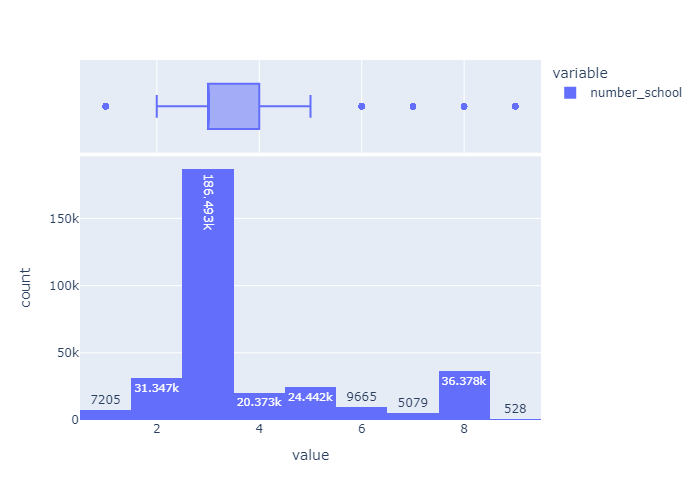

In [94]:
# ищем выбросы в обучающей выборке
iso = IsolationForest(contamination=0.05,
                    n_jobs=n_jobs,
                    random_state=random_state)
y_predicted = iso.fit_predict(df[['number_school']])

# выберем все строки, которые не являются выбросами
mask = y_predicted != -1
temp = df[mask].copy()


px.histogram(temp['number_school'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

In [95]:
# \\
# df = df[df['number_school']<10]
df['number_school'] = df['number_school'].apply(lambda x: 9 if x>9 else x)

In [96]:
temp = []
df['school_distance'].apply(lambda x: temp.extend(x))
print(set(temp))
print(len(set(temp)))

{'13.96mi', '2.4mi', '10.47mi', '15.58mi', '30.88mi', '2.08mi', '26.09mi', '0.08mi', '725.72mi', '19.0 mi', '16.54mi', '28.93mi', '30.53mi', '30.36mi', '17.71mi', '26.78mi', '7.5 mi', '25.4 mi', '31.32mi', '4.27mi', '20.39mi', '1591.06mi', '31.52mi', '18.2mi', '0.63mi', '18.87mi', '7.58mi', '17.74mi', '6.86mi', '32.2mi', '7.57mi', '40.95mi', '28.73mi', '7.0mi', '25.95mi', '11.44mi', '13.63mi', '18.04mi', '19.52mi', '16.9mi', '3.75mi', '28.02mi', '18.4mi', '4.78mi', '24.83mi', '20.94mi', '29.19mi', '35.66mi', '20 mi', '1.86mi', '5.07mi', '2.18mi', '9.51mi', '3.07mi', '29.38mi', '8.8mi', '6.26mi', '6.44mi', '7.93mi', '16.77mi', '25.44mi', '33.05mi', '31.8 mi', '365.58mi', '22.02mi', '32.08mi', '5.3 mi', '18.14mi', '26.71mi', '20.0mi', '19.27mi', '9.75mi', '1.31mi', '8.0 mi', '28.67mi', '18.63mi', '11.32mi', '26.95mi', '10.92mi', '4.56mi', '0.15mi', '14.95mi', '13.0 mi', '23.09mi', '31.72mi', '28.4mi', '34.64mi', '14.84mi', '8.82mi', '27.52mi', '21.97mi', '19.82mi', '9.4 mi', '16.96mi', '

In [97]:
@cython.cfunc
@cython.exceptval(-2, check=True)
def school_distance_mean(x: cython.double) -> cython.double:


    x = str(x).lower().replace('[', '').replace(']', '').replace(
        "'", '').replace(",", '') .replace('mi', '')
    lst = x.split()
    lst = list(filter(None, lst))

    if len(lst) == 0:
        return None
    
    for i in range(len(lst)):
        lst[i] = float(lst[i])    

    else:
        return round(np.mean(lst), 1)

In [98]:
df['school_distance_mean'] = df['school_distance'].apply(school_distance_mean)
df['school_distance_mean'] = df['school_distance_mean'].astype(np.float16)
df['school_distance_mean'].sort_values()

217455    0.0
236249    0.0
45168     0.0
237531    0.0
93030     0.0
         ... 
331776    NaN
331880    NaN
332196    NaN
332271    NaN
332354    NaN
Name: school_distance_mean, Length: 332424, dtype: float16

In [99]:
df['school_distance_mean'].value_counts()

1.000000      14642
1.200195      13887
1.099609      13040
0.799805      12969
0.899902      12916
              ...  
28.796875         1
116.812500        1
26.703125         1
40.906250         1
25.000000         1
Name: school_distance_mean, Length: 279, dtype: int64

In [100]:
df['school_distance_mean'].info()

<class 'pandas.core.series.Series'>
Int64Index: 332424 entries, 0 to 332423
Series name: school_distance_mean
Non-Null Count   Dtype  
--------------   -----  
328900 non-null  float16
dtypes: float16(1)
memory usage: 11.2 MB


In [101]:
display(df[df['school_distance_mean']==1590.8][['state','city','school_distance_mean','zipcode']])

# Такого города нет в штате Теннеси, но есть  в Калифорнии, изменю 
print(find_city(92703))
print(find_state(92703))

# Изменю штат
df.loc[df['school_distance_mean'] == df['school_distance_mean'].max(),'state']='CA'

,state,city,school_distance_mean,zipcode
97022,CA,Santa Ana,1591.0,92703
314445,CA,Santa Ana,1591.0,92703


['Santa Ana', 'Santa Ana']
CA


In [102]:
display(df[df['school_distance_mean']==725.5][['state','city','school_distance_mean','zipcode']])

# # Такого города нет в штате Теннеси, но есть  в PA изменю 
print(find_city(17238))
print(find_state(17238))

# # Изменю штат
df.loc[df['city']=='Needmore','state']='PA'
df.loc[df['city']=='Needmore','school_distance_mean'] = 1.5

,state,city,school_distance_mean,zipcode
190330,PA,Needmore,725.5,17238
204060,PA,Needmore,725.5,17238
264872,PA,Needmore,725.5,17238
314956,PA,Needmore,725.5,17238
327727,PA,Needmore,725.5,17238


['Needmore', 'Needmore']
PA


In [103]:
display(df[df['school_distance_mean'] == 463.5][['state','city','school_distance_mean','zipcode']])

# # Такого города нет в штате Теннеси, но есть  в TX изменю 
print(find_city(77380))
print(find_state(77380))
# # # Изменю штат
df.loc[df['school_distance_mean']==463.5,'state']='TX'

,state,city,school_distance_mean,zipcode
149347,TX,Spring,463.5,77380


['Spring', 'Spring', 'Shenandoah', 'The Woodlands']
TX


In [104]:
display(df[df['school_distance_mean']==157.05][['state','city','school_distance_mean','zipcode']])

# # Такого города нет в штате Теннеси, но есть  в TX изменю 
print(find_city(78545))
print(find_state(78545))
# # # Изменю штат
df.loc[df['school_distance_mean']==157.05,'state']='TX'
df.loc[df['city']=='Falcon Heights','school_distance_mean'] = 1.5

,state,city,school_distance_mean,zipcode


['Falcon Heights', 'Falcon Heights', 'Falcon Hts']
TX


In [105]:
display(df[df['school_distance_mean']==45.1][['state','city','school_distance_mean','zipcode','number_school']])

print(find_city(79837))
print(find_state(79837))

df.loc[df['city']=='Dell City','school_distance_mean'] = 5.1

,state,city,school_distance_mean,zipcode,number_school
6346,TX,Dell City,45.09375,79837,3
32482,TX,Dell City,45.09375,79837,3
73370,TX,Dell City,45.09375,79837,3
102981,TX,Dell City,45.09375,79837,3
110149,TX,Dell City,45.09375,79837,3


['Dell City', 'Dell City']
TX


In [106]:
display(df[df['school_distance_mean'] == df['school_distance_mean'].max()][['state','city','school_distance_mean','zipcode']])

,state,city,school_distance_mean,zipcode
97022,CA,Santa Ana,1591.0,92703
314445,CA,Santa Ana,1591.0,92703


In [107]:
df['school_distance_mean'].describe()

count    328900.000000
mean          2.813568
std           5.023297
min           0.000000
25%           1.099609
50%           1.799805
75%           3.199219
max        1591.000000
Name: school_distance_mean, dtype: float64

In [108]:
temp = df.groupby(by=['state','city',], as_index=False)['school_distance_mean'].agg(my_mode)
temp.columns = 'state'  ,'city','school_distance_mean_city'
# temp['school_distance_mean_city'] = temp['school_distance_mean_city'].astype(np.float16)
temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1943 entries, 0 to 1942
Data columns (total 3 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   state                      1943 non-null   object 
 1   city                       1943 non-null   object 
 2   school_distance_mean_city  1943 non-null   float64
dtypes: float64(1), object(2)
memory usage: 45.7+ KB


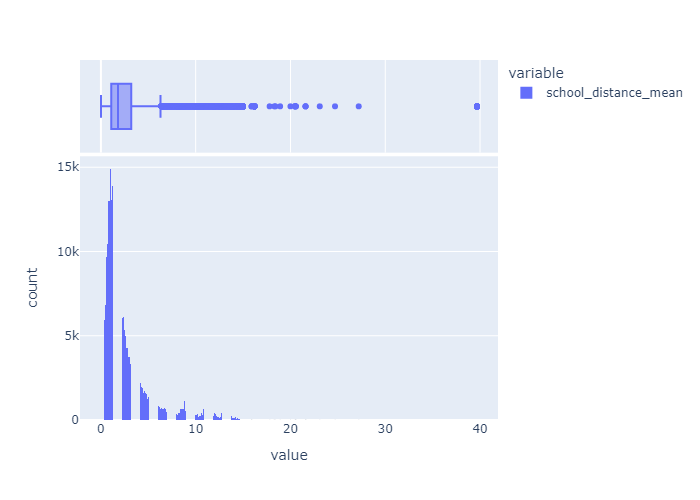

In [109]:
df = df.merge(temp, how='left',on=['state','city',])

df['school_distance_mean'] = df.apply(lambda row: ( row['school_distance_mean_city'] if  row['school_distance_mean']>15
                                                   else row['school_distance_mean']), axis=1)

df = df.drop('school_distance_mean_city',axis=1)

px.histogram(df['school_distance_mean'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

In [110]:
# # ищем выбросы в обучающей выборке
# temp = df[['school_distance_mean']].dropna(subset='school_distance_mean')
# iso = IsolationForest(contamination=0.05,
#                     n_jobs=n_jobs,
#                     random_state=random_state)
# y_predicted = iso.fit_predict(temp)

# # выберем все строки, которые не являются выбросами
# mask = y_predicted != -1
# temp = temp[mask]


# px.histogram(temp['school_distance_mean'],
#              marginal='box',
#              orientation='v',
#              text_auto=True,)#.show('png')

In [111]:
df['school_distance_mean'].info()

<class 'pandas.core.series.Series'>
Int64Index: 332424 entries, 0 to 332423
Series name: school_distance_mean
Non-Null Count   Dtype  
--------------   -----  
328900 non-null  float64
dtypes: float64(1)
memory usage: 5.1 MB


In [112]:
df['school_distance_mean'] = df['school_distance_mean'].astype(np.float16)
df['school_distance_mean'].info()

<class 'pandas.core.series.Series'>
Int64Index: 332424 entries, 0 to 332423
Series name: school_distance_mean
Non-Null Count   Dtype  
--------------   -----  
328900 non-null  float16
dtypes: float16(1)
memory usage: 3.2 MB


In [113]:
df = df.drop([
                'schools', 'school_distance','school_data','school_rating','school_grades', 'school_name',
            ],axis=1).copy()

признак 'homeFacts'

In [114]:
df['homeFacts'] = df['homeFacts'].apply(lambda x: ast.literal_eval(x))
df['atAGlanceFacts'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'])
df['atAGlanceFacts'][0]

[{'factValue': '2019', 'factLabel': 'Year built'},
 {'factValue': '', 'factLabel': 'Remodeled year'},
 {'factValue': 'Central A/C, Heat Pump', 'factLabel': 'Heating'},
 {'factValue': '', 'factLabel': 'Cooling'},
 {'factValue': '', 'factLabel': 'Parking'},
 {'factValue': None, 'factLabel': 'lotsize'},
 {'factValue': '$144', 'factLabel': 'Price/sqft'}]

In [115]:
df = df.drop(['homeFacts'],axis=1).copy()

In [116]:
df['Year_built'] = df['atAGlanceFacts'].apply(lambda x: x[0]['factValue'])
df['Remodeled_year'] = df['atAGlanceFacts'].apply(lambda x: x[1]['factValue'])
df['Heating'] = df['atAGlanceFacts'].apply(lambda x: x[2]['factValue'])
df['Cooling'] = df['atAGlanceFacts'].apply(lambda x: x[3]['factValue'])
df['Parking'] = df['atAGlanceFacts'].apply(lambda x: x[4]['factValue'])
df['lotsize'] = df['atAGlanceFacts'].apply(lambda x: x[5]['factValue'])
# df['Price/sqft'] = df['atAGlanceFacts'].apply(lambda x: x[6]['factValue']) # я считаю,что эти данные - это утечка данных и их следует удалить.

In [117]:
df = df.drop(['atAGlanceFacts'],axis=1).copy()

In [118]:
# Remodeled_year
temp = []
df['Remodeled_year'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 '0',
 '1800',
 '1846',
 '1853',
 '1862',
 '1870',
 '1876',
 '1877',
 '1880',
 '1883',
 '1884',
 '1885',
 '1886',
 '1887',
 '1888',
 '1889',
 '1890',
 '1891',
 '1892',
 '1893',
 '1894',
 '1895',
 '1896',
 '1897',
 '1898',
 '1899',
 '1900',
 '1901',
 '1902',
 '1903',
 '1904',
 '1905',
 '1906',
 '1907',
 '1908',
 '1909',
 '1910',
 '1911',
 '1912',
 '1913',
 '1914',
 '1915',
 '1916',
 '1917',
 '1918',
 '1919',
 '1920',
 '1921',
 '1922',
 '1923',
 '1924',
 '1925',
 '1926',
 '1927',
 '1928',
 '1929',
 '1930',
 '1931',
 '1932',
 '1933',
 '1934',
 '1935',
 '1936',
 '1937',
 '1938',
 '1939',
 '1940',
 '1941',
 '1942',
 '1943',
 '1944',
 '1945',
 '1946',
 '1947',
 '1948',
 '1949',
 '1950',
 '1951',
 '1952',
 '1953',
 '1954',
 '1955',
 '1956',
 '1957',
 '1958',
 '1959',
 '1960',
 '1961',
 '1962',
 '1963',
 '1964',
 '1965',
 '1966',
 '1967',
 '1968',
 '1969',
 '1970',
 '1971',
 '1972',
 '1973',
 '1974',
 '1975',
 '1976',
 '1977',
 '1978',
 '1979',
 '1980',
 '1981',
 '1982',
 '1983',
 '1984',

In [119]:
df['Remodeled_year'] = df['Remodeled_year'].apply(lambda x: None if x=='' or pd.isna(x) else int(str(x)))

In [120]:
df['Remodeled_year'].isna().mean().round(3)

0.596

In [121]:
df['Remodeled_year'] = df['Remodeled_year'].fillna(False)
df['Remodeled'] = df['Remodeled_year'].apply(lambda x: False if x == False else True)
df = df.drop('Remodeled_year',axis=1).copy()
df['Remodeled'].mean()

0.40285298293745336

In [122]:
temp = []
df['lotsize'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 '768',
 '21.66 acres lot',
 '2938',
 '27038',
 '523 sqft',
 '9.47 acres',
 '4800',
 '650 sqft lot',
 '1,634 sq. ft.',
 '10130',
 '10425',
 '2,402 sq. ft.',
 '6,903 sqft',
 '292823',
 '3925',
 '10,563 sq. ft.',
 '7646',
 '2426 sqft',
 '2,153 sq. ft.',
 '8019 sqft',
 '1.92 acres',
 '8665',
 '2,183 sq. ft.',
 '14880',
 '6791',
 '1009 sqft',
 '9,215 sq. ft.',
 '5,745 sqft lot',
 '10,128 sqft',
 '10,405 sq. ft.',
 '15589',
 '7,413 sq. ft.',
 '1929 sqft',
 '2,557 sq. ft.',
 '6,152 sqft',
 '102 sqft',
 '446926',
 '9,814 sq. ft.',
 '6,578 sq. ft.',
 '6619',
 '8,030 sq. ft.',
 '9.99 acres',
 '480 sq. ft.',
 '7,805 sq. ft.',
 '15450',
 '2,170 sq. ft.',
 '8,524 sqft',
 '6636',
 '7,482 sqft',
 '5130',
 '8,189 sq. ft.',
 '6973 sqft',
 '8,064 sq. ft.',
 '3,819 sqft',
 '1.01 acres',
 '15107',
 '2,276 sqft',
 '2.03 acres lot',
 '5,244 sqft lot',
 '8,143 sqft',
 '164705',
 '5630',
 '4,939 sqft lot',
 '8.88 acres',
 '5.13 acres',
 '17032',
 '6,590 sq. ft.',
 '72310',
 '4828',
 '8,564 sqft',
 '7,34

In [123]:
df['lotsize'].value_counts(dropna=False)[:50]

               28732
None           25532
—              20690
No Data         5078
-- sqft lot     3596
0.26 acres      2134
0.25 acres      1849
0.28 acres      1834
0.27 acres      1750
0.29 acres      1616
6,098 sqft      1442
0.34 acres      1400
7,405 sqft      1301
6,534 sqft      1245
0.3 acres       1232
0.31 acres      1152
10,000 sqft     1129
0.32 acres      1092
5,227 sqft      1061
4,356 sqft      1035
5,000 sqft       985
8,712 sqft       967
0.35 acres       961
0.33 acres       961
8,276 sqft       929
0.46 acres       862
0.36 acres       820
0.37 acres       801
3,920 sqft       751
10,019 sqft      750
9,583 sqft       704
4,791 sqft       679
1 acre           676
0.38 acres       668
10,454 sqft      658
10019            651
4,792 sqft       651
0.39 acres       637
0.4 acres        630
7,840 sqft       622
6,969 sqft       617
0.41 acres       607
0.5 acres        563
0.26 Acres       560
7,500 sqft       551
6,970 sqft       545
10000            536
1 Acre       

In [124]:
temp = {'-- sqft lot':np.NaN,
        'No Data':np.NaN,
        '—':np.NaN,
        '--':np.NaN,
        '':np.NaN,
        None:np.NaN
        }

df['lotsize'] = df['lotsize'].replace(temp)
df['lotsize'].value_counts(dropna=False)[:50]

NaN            83628
0.26 acres      2134
0.25 acres      1849
0.28 acres      1834
0.27 acres      1750
0.29 acres      1616
6,098 sqft      1442
0.34 acres      1400
7,405 sqft      1301
6,534 sqft      1245
0.3 acres       1232
0.31 acres      1152
10,000 sqft     1129
0.32 acres      1092
5,227 sqft      1061
4,356 sqft      1035
5,000 sqft       985
8,712 sqft       967
0.33 acres       961
0.35 acres       961
8,276 sqft       929
0.46 acres       862
0.36 acres       820
0.37 acres       801
3,920 sqft       751
10,019 sqft      750
9,583 sqft       704
4,791 sqft       679
1 acre           676
0.38 acres       668
10,454 sqft      658
4,792 sqft       651
10019            651
0.39 acres       637
0.4 acres        630
7,840 sqft       622
6,969 sqft       617
0.41 acres       607
0.5 acres        563
0.26 Acres       560
7,500 sqft       551
6,970 sqft       545
10000            536
1 Acre           534
0.44 acres       530
871 sqft         529
2,500 sqft       527
3,049 sqft   

Есть акры и квадратные футы переведем все в футы. и удалим размерность футов

In [125]:
df['lotsize'] = df['lotsize'].apply(acr_in_sqft)
df['lotsize'] = df['lotsize'].apply(lambda x: None if pd.isna(x) else float(str(x).replace(',','')))

In [126]:
df['lotsize'].value_counts(dropna=False).head(50)

NaN        83628
11325.6     2953
10890.0     2913
6098.0      2604
7405.0      2598
12196.8     2502
11761.2     2456
13068.0     2196
12632.4     2183
6534.0      2167
43560.0     2115
10000.0     2052
5000.0      1946
8712.0      1904
8276.0      1862
5227.0      1858
14810.4     1841
4356.0      1706
13503.6     1619
9583.0      1559
10019.0     1484
13939.2     1461
10454.0     1412
14374.8     1335
15246.0     1291
10018.0     1252
4791.0      1222
3920.0      1210
21780.0     1175
20037.6     1168
6969.0      1145
17424.0     1133
15681.6     1117
7840.0      1100
16117.2     1071
7500.0      1070
4792.0      1041
3049.0       998
5662.0       975
6000.0       963
6970.0       960
7841.0       929
2178.0       918
16552.8      907
16988.4      872
871.0        865
7000.0       846
1742.0       805
17859.6      791
5663.0       788
Name: lotsize, dtype: int64

In [127]:
df['lotsize'] = abs(df['lotsize'] )

In [128]:
df[df['lotsize']<5][['lotsize','sqft','beds','baths','propertyType']].value_counts()[:50]

lotsize  sqft    beds  baths  propertyType      
0.23     0.0     0.0   0.0    Land                  172
1.00     0.0     0.0   0.0    Land                   54
0.24     0.0     0.0   0.0    Land                   26
0.28     0.0     0.0   0.0    Land                   18
0.29     0.0     0.0   0.0    Land                   18
0.31     0.0     0.0   0.0    Land                   17
0.36     0.0     0.0   0.0    Land                   12
0.25     0.0     0.0   0.0    Land                   11
0.27     0.0     0.0   0.0    Land                   11
0.30     0.0     0.0   0.0    Land                   11
0.33     0.0     0.0   0.0    Land                   10
0.26     0.0     0.0   0.0    Land                   10
0.34     0.0     0.0   0.0    Land                    8
0.37     0.0     0.0   0.0    Land                    8
0.41     0.0     0.0   0.0    Land                    8
0.47     0.0     0.0   0.0    Land                    8
0.40     0.0     0.0   0.0    Land                    6

In [129]:
df['lotsize'] = df['lotsize'].apply(lambda x: acr_in_sqft(x) if x<5 else x)

очень похоже это акры, переведу в sqft

In [130]:
temp = []
df['Year_built'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
sorted(set(temp))

['',
 '1',
 '1019',
 '1057',
 '1208',
 '1700',
 '1735',
 '1750',
 '1788',
 '1790',
 '1795',
 '1796',
 '1799',
 '1800',
 '1804',
 '1805',
 '1807',
 '1808',
 '1809',
 '1810',
 '1811',
 '1815',
 '1816',
 '1817',
 '1818',
 '1820',
 '1822',
 '1823',
 '1824',
 '1825',
 '1829',
 '1830',
 '1831',
 '1832',
 '1834',
 '1835',
 '1836',
 '1840',
 '1842',
 '1843',
 '1844',
 '1845',
 '1846',
 '1847',
 '1848',
 '1850',
 '1851',
 '1852',
 '1853',
 '1854',
 '1855',
 '1856',
 '1857',
 '1858',
 '1859',
 '1860',
 '1861',
 '1862',
 '1863',
 '1864',
 '1865',
 '1866',
 '1867',
 '1868',
 '1869',
 '1870',
 '1871',
 '1872',
 '1873',
 '1874',
 '1875',
 '1876',
 '1877',
 '1878',
 '1879',
 '1880',
 '1881',
 '1882',
 '1883',
 '1884',
 '1885',
 '1886',
 '1887',
 '1888',
 '1889',
 '1890',
 '1891',
 '1892',
 '1893',
 '1894',
 '1895',
 '1896',
 '1897',
 '1898',
 '1899',
 '1900',
 '1901',
 '1902',
 '1903',
 '1904',
 '1905',
 '1906',
 '1907',
 '1908',
 '1909',
 '1910',
 '1911',
 '1912',
 '1913',
 '1914',
 '1915',
 '1916',

In [131]:
df['Year_built'].info()

<class 'pandas.core.series.Series'>
Int64Index: 332424 entries, 0 to 332423
Series name: Year_built
Non-Null Count   Dtype 
--------------   ----- 
329253 non-null  object
dtypes: object(1)
memory usage: 13.1+ MB


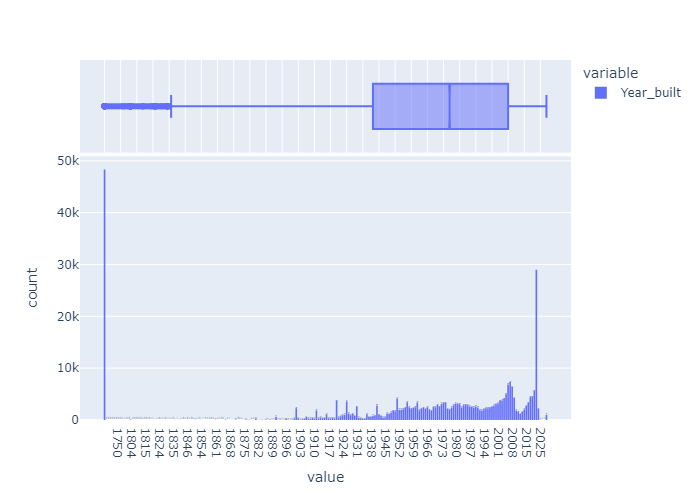

In [132]:
px.histogram(df['Year_built'].sort_values(),
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

Можно предположить, что год постройти NaN это может быть Land. Проверю это.

In [133]:
df[df['Year_built'].isna()]['propertyType'].unique()

array([nan, 'single-family home'], dtype=object)

In [134]:
df[df['Year_built']=='No Data']['propertyType'].unique()

array(['Miscellaneous', 'single-family home', 'townhouse', 'condo',
       'Multi Family', 'Mobile / Manufactured', 'Multiple Occupancy',
       'Cooperative'], dtype=object)

In [135]:
df['Year_built'] = df['Year_built'].apply(lambda x: None if x=='' or pd.isna(x) or x=='No Data' else int(float(str(x))))

In [136]:
df['Year_built'].isna().mean().round(3)

0.158

In [137]:
df = df[df['Year_built'] != 559990649990]
df = df[df['Year_built'] !=1 ]

# буду считать что некоторые года - это опечатки и исправлю на что-то похожее

df['Year_built'] = df['Year_built'].replace({1019:2019,
                                             1057:1957,
                                             1060:1960,
                                             1208:2008,
                                             })

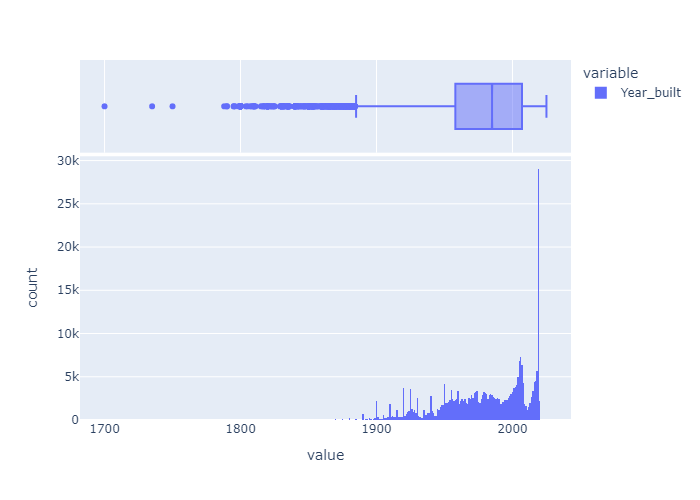

In [138]:
px.histogram(df['Year_built'].sort_values(),
             marginal='box',
             orientation='v',
            #  text_auto=True,
             ).show('png')

In [139]:
df['Year_built'] = df['Year_built'].apply(lambda x: filtr_less(x,2020))
df['Year_built'] = df['Year_built'].apply(lambda x: filtr_more(x,1882))

In [140]:
df['Year_built'].isna().mean().round(3)

0.158

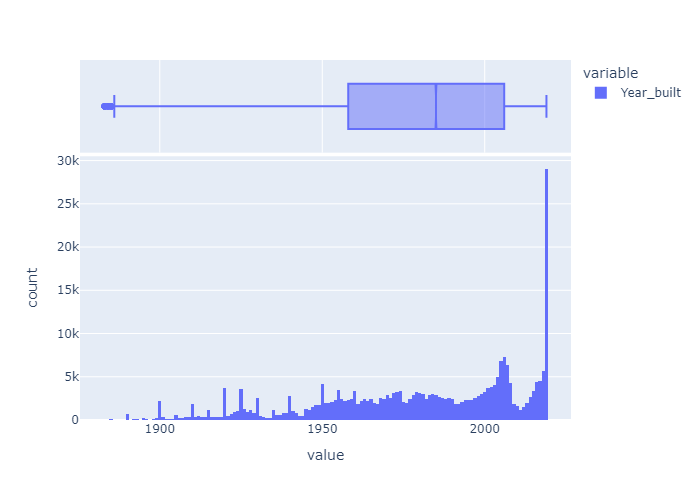

In [141]:
df = df[df['Year_built'] != 'del_data']

px.histogram(df['Year_built'].sort_values(),
             marginal='box',
             orientation='v',
            #  text_auto=True,
             ).show('png')

In [142]:
df['Year_built'].isna().mean().round(3)

0.16

Судя по всему данные собиральсь в 2019 году и в случае отсутствия данных, или это земля и др. непонятные ситуации вводили текущий год - 2019. в результате данные за этот год недостоверные.   В дальнейшем надо будет проверить может без 2019 года качество будет лучше?

In [143]:
df['Year_built'] = 2019 - df['Year_built']

In [144]:
df['Year_built'].describe()

count     276778.0
unique       137.0
top            0.0
freq       28974.0
Name: Year_built, dtype: float64

In [145]:
temp = []
df['Heating'].apply(lambda x: temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 ' apply',
 '/storage closet-electric',
 '1',
 '1 air conditioner',
 '1 central a/c',
 '1 unit',
 '1 window unit incl.',
 '1 window/wall a/c',
 '1 window/wall air conditioning unit',
 '10 air conditioners',
 '14',
 '1st fl',
 '2',
 '2 air conditioners',
 '2 or more h20 heaters',
 '2 or more heat sources',
 '2 or more units',
 '2 units',
 '2 water heaters',
 '2 window unit incl.',
 '2 window/wall a/c',
 '2 window/wall air conditioning units',
 '2nd floor-electric',
 '2nd floor-tankless',
 '2x 50 gallon',
 '3',
 '3 air conditioners',
 '3+ units',
 '3+ window/wall a/c',
 '3+ window/wall air conditioning units',
 '3rd floor bonus room-gas',
 '3rd floor-tank',
 '3rd floor-tankless',
 '3rd level closet-gas',
 '4 air conditioners',
 '5',
 '5 air conditioners',
 '6 air conditioners',
 '90% forced air heating',
 '90% high effic furnace',
 '90% high efficiency furn',
 '96.5',
 'above ground tank',
 'ac (central)',
 'active solar',
 'air cond/heating',
 'air conditioning',
 'air to air heat 

In [146]:
df['Heating'] = df['Heating'].replace({'No Data':None, '':None, 'None':None,'Contact manager':None,})

чтобы проще было анализировать данные чуть-чуть изменю данные и введу новые признаки.

In [147]:
sign = ['forced air', 'hot air']
notsign = ['no heat', 'no heat fuel', 'no heat system', 'no heating',]
df.loc[:,'forced_air_heating'] = df['Heating'].apply(lambda x: find_x_exc(x=x, sign=sign, notsign=notsign))

sign = ['gas', 'propan','has heating','gallon','butane','tank','buried']
df.loc[:,'gas_heating'] = df['Heating'].apply(lambda x: find_x_exc(x=x, sign=sign, notsign=notsign))

sign = ['electric', 'wall','radiant','Radiat']
df.loc[:,'electric_heating'] = df['Heating'].apply(lambda x: find_x_exc(x=x, sign=sign, notsign=notsign))

sign = ['pump', 'window', 'condition','A/C']
df.loc[:,'pump_heating'] = df['Heating'].apply(lambda x: find_x_exc(x=x, sign=sign, notsign=notsign))

sign = ['furnace',]
df.loc[:,'furnace_heating'] = df['Heating'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['central',]
df.loc[:,'central_heating'] = df['Heating'].apply(lambda x: find_x(x=x, sign=sign))

sign=['fireplace']
df.loc[:,'fireplace_heating'] = df['Heating'].apply(lambda x: find_x(x=x, sign=sign))

sign=['fan','ceiling',]
df.loc[:,'fan_h'] = df['Heating'].apply(lambda x: find_x(x=x, sign=sign))


sign=['central air condit','a/c',]
df.loc[:,'aircondi_h'] = df['Heating'].apply(lambda x: find_x(x=x, sign=sign))

df.loc[:,'heat_bool'] = df['Heating'].apply(lambda x: False if 'no heat' in str(x).lower() or  x is None  or 'none' in str(x).lower()  else True )

In [148]:
df[['fireplace_heating','fireplace']].head()

,fireplace_heating,fireplace
0,False,Gas Logs
1,False,no fireplace
2,False,no fireplace
3,False,no fireplace
4,False,no fireplace


In [149]:
temp = []
df['Cooling'].apply(lambda x:temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 ' apply',
 '1',
 '1 (window/wall unit)',
 '1 unit',
 '2',
 '2 (window/wall unit)',
 '2 air conditioners',
 '2 or more units',
 '2 units',
 '2+ separate heating systems',
 '3',
 '3 air conditioners',
 '3+ (window/wall unit)',
 '3+ units',
 '90%+ high efficiency',
 'a/c',
 'a/c units',
 'additional water heater(s)',
 'air conditioning',
 'air conditioning unit(s)',
 'air conditioning-central',
 'air conditioning-individual',
 'air conditioning-room',
 'air purification system',
 'air purifier',
 'appliances',
 'attic fan',
 'attic ventilator',
 'baseboard',
 'baseboard - cast iron',
 'baseboard - electric',
 'baseboard - hotwater',
 'baseboard heat',
 'baseboard heating',
 'baseboard hot water heat',
 'blowers',
 'boiler',
 'both refrig & evap',
 'butane',
 'ceiling fan',
 'ceiling fan(s)',
 'ceiling fan(s),dual cooling',
 'ceiling fans',
 'cenrtal ac',
 'central',
 'central 1 zone a/c',
 'central 2 or 2+ zones a/c',
 'central a/c',
 'central a/c (electric)',
 'central a/c (gas)',


In [150]:
df['Cooling'] = df['Cooling'].replace({'No Data':None, '':None, 'None':None,
                                       })

Очень странный признак. большое желание его удалить.

In [151]:
sign=['a/c','air condit','central air','window unit','central cooling','wall unit','cenrtal ac','mini-split','pump ac','central ac','or more unit',]
notsign = ['no a/c','no air condit',]

df.loc[:,'air_conditioner'] = df['Cooling'].apply(lambda x: find_x_exc(x=x, sign=sign, notsign=notsign))

sign=['fan']
df.loc[:,'ceiling_fan'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['forced air', 'hot air']
df.loc[:,'forced_air_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['gas', 'propan','has heating']
df.loc[:,'gas_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['electric', 'wall','radiant','Radiat']
df.loc[:,'electric_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['pump', 'window', 'condition','A/C']
df.loc[:,'pump_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['furnace',]
df.loc[:,'furnace_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['central',]
df.loc[:,'central_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))

sign=['fireplace']
df.loc[:,'fireplace_heating_c'] = df['Cooling'].apply(lambda x: find_x(x=x, sign=sign))


df.loc[:,'cool_bool'] = df['Cooling'].apply(lambda x: False if 'no cooling/vent' in str(x).lower() or 'no air conditioning' in str(x).lower(
                                    ) or 'no a/c' in str(x).lower() or x is None  or 'none' in str(x).lower()  else True )

In [152]:
df['ceiling_fan'] = df['ceiling_fan'] + df['fan_f'] + df['fan_h']
df['air_conditioner'] = df['air_conditioner'] + df['aircondi_h']


df['forced_air_heating'] = df['forced_air_heating'] + df['forced_air_heating_c']
df['gas_heating'] = df['gas_heating'] + df['gas_heating_c']
df['electric_heating'] = df['electric_heating'] + df['electric_heating_c']
df['pump_heating'] = df['pump_heating'] + df['pump_heating_c'] + df['heat_pump_f']
df['furnace_heating'] = df['furnace_heating'] + df['furnace_heating_c']
df['central_heating'] = df['central_heating'] + df['central_heating_c']

df['apartment'] = df['apartment'] + df['apartment_s']
df['condo'] = df['condo'] + df['apartment'] + df['multiple_occupancy']

# df['Townhouse'] = df['Townhouse']  + df['multi-family home']


df['sqft'] = df.apply(lambda row: (row['baths_sq'] if pd.isna(row['sqft']) else row['sqft']),axis=1 )
df['lotsize'] = df.apply(lambda row: (row['acres_beds'] if pd.isna(row['lotsize']) else row['sqft']),axis=1 )

In [153]:
print(df['firepl'].sum())
print(df['fireplace_heating'].sum())
df['firepl'] = df['firepl'] + df['fireplace_heating'] + df['fireplace_heating_c']
df['firepl'].sum()

82695
265


82710

In [154]:
print(sorted(df.columns,key=str.lower))

df = df.drop(['fireplace_heating', 'fireplace_heating_c','fireplace',
            ],axis=1).copy()

['1,5_level', '1,5_level_t', '1_level', '1_level -', '1_level-t', '1_level_t', '2_level', '2_level -', '2_level-t', '2_level_frpl', '2_level_t', '3_level', '3_level -', '3_level-t', '3_level_t', '4_level', '4_level -', '4_level-t', '4_level_t', 'acres_beds', 'air_conditioner', 'aircondi_h', 'apartment', 'apartment_s', 'auction', 'bath_copy', 'baths', 'baths_frpl', 'baths_sq', 'beds', 'beds_copy', 'beds_frpl', 'ceiling_fan', 'central_heating', 'central_heating_c', 'city', 'city_is_big', 'city_is_capital', 'city_is_large', 'city_is_million', 'claster', 'condo', 'Condo_s', 'cool_bool', 'Cooling', 'distance_capital', 'distance_million', 'electric_heating', 'electric_heating_c', 'fan_f', 'fan_h', 'Farms/Ranches', 'Farms/Ranches__s', 'firepl', 'fireplace', 'fireplace_heating', 'fireplace_heating_c', 'forced_air_heating', 'forced_air_heating_c', 'foreclosure', 'furnace_heating', 'furnace_heating_c', 'gas_heating', 'gas_heating_c', 'heat_bool', 'heat_pump_f', 'Heating', 'home_s', 'land', 'land

In [155]:
sorted(df.columns,key=str.lower)

['1,5_level',
 '1,5_level_t',
 '1_level',
 '1_level -',
 '1_level-t',
 '1_level_t',
 '2_level',
 '2_level -',
 '2_level-t',
 '2_level_frpl',
 '2_level_t',
 '3_level',
 '3_level -',
 '3_level-t',
 '3_level_t',
 '4_level',
 '4_level -',
 '4_level-t',
 '4_level_t',
 'acres_beds',
 'air_conditioner',
 'aircondi_h',
 'apartment',
 'apartment_s',
 'auction',
 'bath_copy',
 'baths',
 'baths_frpl',
 'baths_sq',
 'beds',
 'beds_copy',
 'beds_frpl',
 'ceiling_fan',
 'central_heating',
 'central_heating_c',
 'city',
 'city_is_big',
 'city_is_capital',
 'city_is_large',
 'city_is_million',
 'claster',
 'condo',
 'Condo_s',
 'cool_bool',
 'Cooling',
 'distance_capital',
 'distance_million',
 'electric_heating',
 'electric_heating_c',
 'fan_f',
 'fan_h',
 'Farms/Ranches',
 'Farms/Ranches__s',
 'firepl',
 'forced_air_heating',
 'forced_air_heating_c',
 'foreclosure',
 'furnace_heating',
 'furnace_heating_c',
 'gas_heating',
 'gas_heating_c',
 'heat_bool',
 'heat_pump_f',
 'Heating',
 'home_s',
 'land

In [156]:
temp = []
df['Parking'].apply(lambda x:temp.extend(str(x).lower().split(sep=', ')))
set(temp)

{'',
 ' apply',
 '-carport',
 '0',
 '1',
 '1 - 4 spaces',
 '1 addl parking space',
 '1 assigned',
 '1 assigned space',
 '1 attached carport',
 '1 car',
 '1 car attchd garage',
 '1 car carport',
 '1 car garage',
 '1 car space',
 '1 carport',
 '1 off street',
 '1 space',
 '1 space assigned',
 '1 space/unit',
 '1.00',
 '10',
 '10 car',
 '10 spaces',
 '100',
 '100 spaces',
 '1016',
 '105 spaces',
 '108 spaces',
 '11',
 '11 - 20 spaces',
 '11 spaces',
 '110',
 '110 spaces',
 '111',
 '112 spaces',
 '118 spaces',
 '12',
 '12 spaces',
 '120',
 '120 spaces',
 '126 spaces',
 '13 spaces',
 '131 spaces',
 '14',
 '14 spaces',
 '140',
 '140 spaces',
 '15',
 '15 spaces',
 '150',
 '150 spaces',
 '157 spaces',
 '16 spaces',
 '162 spaces',
 '17 car',
 '17 spaces',
 '171 spaces',
 '179',
 '18',
 '18 spaces',
 '19 spaces',
 '2',
 '2 assigned',
 '2 assigned spaces',
 '2 attached carport',
 '2 car',
 '2 car attached garage',
 '2 car attchd garage',
 '2 car carport',
 '2 car garage',
 '2 car space',
 '2 carp

In [157]:
df['Parking'] = df['Parking'].replace({'No Data':None,
                                       'Parking Desc':None,
                                       'Parking Type':None,
                                       'ParkingType':None,
                                       'Parking YN':None,
                                       '':None,
                                       'None':None,
                                       })

In [158]:
# 'Parking'
sign = ['attach', 'detache', 'garag', 'door', 'attch', 'under building','basement']
df.loc[:,'Garage'] = df['Parking'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['carport', 'cover',]
df.loc[:,'Carport'] = df['Parking'].apply(lambda x: find_x(x=x, sign=sign))

sign = ['parking lot', 'parking pad', 'parking space', 'pkpad','paved parking',
        'guest parking', 'street parkin', 'additional parking', 'secure parking',]
df.loc[:,'Parking_lot'] = df['Parking'].apply(lambda x: find_x(x=x, sign=sign))

In [159]:
temp = df[df['Garage'] == 0].copy()
temp = temp[temp['Carport'] == 0].copy()
temp = temp[temp['Parking_lot'] == 0].copy()
temp = list(temp['Parking'].unique())
temp

[None,
 '2 spaces',
 '0',
 '1 space',
 '2',
 'Off Street',
 '3 spaces',
 'Double Wide Drive, Oversized Drive',
 '1',
 'Asphalt Driveway, Off Street',
 '4 spaces',
 '7 spaces',
 'Off street',
 '4',
 '6 spaces',
 'Assigned',
 'BSMT, GRAVL',
 'On Street',
 '8 spaces',
 'On Street, Off Street',
 'Off Street, On Street',
 '10 spaces',
 '2 Off Street',
 'GRAVL',
 '3 Car Or More',
 'Assigned, Guest',
 'AGGRE',
 '3',
 'DRVWY, GRAVL, On Street',
 '5 spaces',
 'Open',
 '21+ Spaces',
 '6',
 'Driveway',
 'On street',
 'Dirt Driveway, On Street',
 'Alley Access, CONCR, On Street',
 '5',
 'Driveway, Paved',
 'Driveway Paved',
 'No',
 '9 spaces',
 'Off street, On street',
 'On Site, Paved',
 'On Street, Alley, Driveway',
 'Concrete Driveway, Off Street',
 '2+ Spaces, Driveway Paved',
 'Driveway, Off Street',
 '8',
 'Asphalt, Double Wide Drive',
 'No Parking',
 'Under Bldg Open',
 'Gravel',
 'Guest, On Street, Open',
 'Parking/Driveway',
 'On Street, None',
 'Clubhouse, Play Area, Swim Pool-Inground',

In [160]:
# df =df.drop([
#             ],axis=1)

In [161]:
df[df['land'] == 1].sort_values('target')

,status,propertyType,street,baths,city,sqft,zipcode,beds,state,stories,target,city_is_capital,city_is_million,city_is_big,city_is_large,claster,distance_capital,distance_million,fan_f,heat_pump_f,beds_frpl,baths_frpl,2_level_frpl,firepl,stories_sqft,1_level,1_level -,"1,5_level",2_level,2_level -,3_level,3_level -,4_level,4_level -,multi_level,Townhouse_s,Condo_s,Farms/Ranches__s,home_s,land_s,multi_family_s,apartment_s,1_level_t,1_level-t,"1,5_level_t",2_level_t,2_level-t,3_level_t,3_level-t,4_level_t,...,apartment,condo,Farms/Ranches,Townhouse,Single Family Home,land,sqft_copy,strange_sqft,pool,lease,auction,foreclosure,new,beds_copy,bath_copy,sqft_beds,acres_beds,str_number_beds,str_number_baths,baths_sq,school_rating_mean,number_school,school_distance_mean,Year_built,Heating,Cooling,Parking,lotsize,Remodeled,forced_air_heating,gas_heating,electric_heating,pump_heating,furnace_heating,central_heating,fan_h,aircondi_h,heat_bool,air_conditioner,ceiling_fan,forced_air_heating_c,gas_heating_c,electric_heating_c,pump_heating_c,furnace_heating_c,central_heating_c,cool_bool,Garage,Carport,Parking_lot
37154,for sale,lot/land,1134 Elvira St,0.0,San Antonio,2125.0,78207,0.0,TX,0,10001.0,False,True,False,False,18.0,122.981016,4.139085,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,"2,125 sqft",NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,3,0.899902,NaN,None,None,None,2125.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
224593,for sale,lot/land,305 3rd Ln,0.0,Midway Park,0.0,28544,0.0,NC,1.0,10200.0,False,False,False,False,190.0,171.590927,617.781216,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,NaN,NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.5,2,2.900391,NaN,None,None,None,0.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
40451,for sale,lot/land,1308 13th St,0.0,Midway Park,0.0,28544,0.0,NC,1.0,10200.0,False,False,False,False,190.0,171.590927,617.781216,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,NaN,NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.5,2,3.000000,NaN,None,None,None,0.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
34690,Active,Land,SW 75th St Lot 3,0.0,Dunnellon,0.0,34432,0.0,FL,0,10200.0,False,False,False,False,208.0,235.289588,1259.343455,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,0,NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,None,None,None,0.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
207134,for sale,lot/land,1202 12th St,2.0,Midway Park,952.0,28544,3.0,NC,1.0,10200.0,False,False,False,False,190.0,171.590927,617.781216,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,952 sqft,NaN,False,False,False,False,False,3 Beds,2 Baths,NaN,NaN,NaN,NaN,NaN,5.5,2,3.000000,32.0,Other,Central,None,952.0,False,False,False,

Часть из этих данных - опечатки их исправлю, а часть - "общежития" - данные, которые портят картину,можно будет выделить их в отдельный датасет.

In [162]:
df[df['str_number_beds'].notna()]['str_number_beds'].value_counts()

12.0    67
11.0    45
64.0    38
16.0    19
13.0    18
14.0    13
18.0     9
15.0     8
24.0     7
20.0     6
28.0     3
17.0     3
30.0     2
29.0     1
46.0     1
39.0     1
44.0     1
19.0     1
23.0     1
22.0     1
34.0     1
Name: str_number_beds, dtype: int64

In [163]:
df[(df['beds']==44)&(df['multi_family']==12)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','city','state']]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,city,state


в этих случаях похоже на опечатку, исправлю. При этом учту, что 'multi_family' это общежитие и его рассматнивать не буду.

In [164]:
df.loc[(df['str_number_beds']==34)&(df['multi_family']==0)&(df['baths']==2.5),'beds']=4
df.loc[(df['str_number_beds']==14)&(df['multi_family']==0)&(df['baths']==0),'beds']=0
df.loc[(df['str_number_beds']==14)&(df['multi_family']==0)&(df['baths']==4),'beds']=4
df.loc[(df['str_number_beds']==13)&(df['multi_family']==0)&(df['baths']==0),'beds']=0
df.loc[(df['str_number_beds']==11)&(df['multi_family']==0)&(df['baths']==0),'beds']=0
df.loc[(df['str_number_beds']==12)&(df['multi_family']==0)&(df['baths']==0),'beds']=0

In [165]:
df[df['str_number_baths'].notna()]['str_number_baths'].value_counts()

750.0    222
12.0      35
11.0      19
13.0      17
16.0       9
10.5       7
20.0       6
15.0       4
24.0       4
14.0       4
22.0       3
18.0       2
17.0       2
30.0       2
241.0      1
19.0       1
25.0       1
12.5       1
60.0       1
28.0       1
Name: str_number_baths, dtype: int64

In [166]:
display(df[(df['baths']==23)&(df['multi_family']==0)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','city','state']])

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,city,state


в этих случаях похоже на опечатку, исправлю. При этом учту, что 'multi_family' это общежитие и его рассматнивать не буду.

In [167]:
df.loc[(df['str_number_baths']==12)&(df['multi_family']==0)&(df['beds']==4),'baths']=2
df.loc[(df['str_number_baths']==12)&(df['multi_family']==0)&(df['beds']==2),'baths']=1
df.loc[(df['str_number_baths']==12)&(df['multi_family']==0)&(df['beds']==3),'baths']=2
df.loc[(df['str_number_baths']==11)&(df['multi_family']==0)&(df['beds']==3),'baths']=1
df.loc[(df['str_number_baths']==11)&(df['multi_family']==0)&(df['beds']==2),'baths']=1
df.loc[(df['str_number_baths']==11)&(df['multi_family']==0)&(df['beds']==4),'baths']=1
df.loc[(df['str_number_baths']==13)&(df['multi_family']==0)&(df['beds']==4),'baths']=3
df.loc[(df['str_number_baths']==13)&(df['multi_family']==0)&(df['beds']==5),'baths']=3
df.loc[(df['str_number_baths']==13)&(df['multi_family']==0)&(df['beds']==6),'baths']=3
df.loc[(df['str_number_baths']==13)&(df['multi_family']==0)&(df['beds']==3),'baths']=3
df.loc[(df['str_number_baths']==20)&(df['multi_family']==0)&(df['beds']==4),'baths']=2
df.loc[(df['str_number_baths']==14)&(df['multi_family']==0)&(df['beds']==6),'baths']=4
df.loc[(df['str_number_baths']==15)&(df['multi_family']==0)&(df['beds']==2),'baths']=1
df.loc[(df['str_number_baths']==15)&(df['multi_family']==0)&(df['beds']==2),'baths']=1
df.loc[(df['str_number_baths']==19)&(df['multi_family']==0)&(df['beds']==5),'baths']=1
df.loc[(df['str_number_baths']==30)&(df['multi_family']==0)&(df['beds']==4),'baths']=3
df.loc[(df['str_number_baths']==25)&(df['multi_family']==0)&(df['beds']==4),'baths']=2
df.loc[(df['str_number_baths']==25)&(df['multi_family']==0)&(df['beds']==3),'baths']=2
df.loc[df['str_number_baths']==241,'baths']=2

In [168]:
df[(df['str_number_baths']==750) & (df['lotsize'].isna())][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
3119,NaN,Active,NaN,NaN,750.0,False,873.0,NaN,348900.0,False
6600,NaN,Active,NaN,NaN,750.0,False,1864.0,NaN,560000.0,False
6716,3,Active,Condo/Townhome,NaN,750.0,True,1336.0,NaN,285000.0,False
10177,NaN,Active,"Contemporary, Loft",NaN,750.0,False,856.0,NaN,675000.0,False
18291,NaN,Active,Urban Contemporary,NaN,750.0,False,901.0,NaN,409000.0,False
...,...,...,...,...,...,...,...,...,...,...
322952,NaN,Active,"Condo/Townhome, Traditional",NaN,750.0,True,1546.0,NaN,499900.0,False
328350,NaN,Active,NaN,NaN,750.0,False,801.0,NaN,449000.0,False
331049,NaN,Active,"Condo/Townhome, Contemporary/Modern",NaN,750.0,False,832.0,NaN,219500.0,False
331390,NaN,Active,"Condo/Townhome, Other (See Remarks)",NaN,750.0,False,2102.0,NaN,464900.0,False


In [169]:
df.loc[df['str_number_baths']==750,'baths']=None

In [170]:
df[df['stories_sqft'].notna()][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
196353,1120.0,for sale,condo,NaN,1.0,False,425.0,425.0,53000.0,False
279007,1002.0,for sale,townhouse,3.0,3.0,True,1497.0,1497.0,325000.0,False


In [171]:
# sqft_beds 'acres_beds'

df['sqft'] = df.apply(lambda row: ( row['sqft_beds'] if pd.isna(row['sqft']) else row['sqft']),axis=1)

df[df['sqft_beds'].notna()][['sqft_beds','stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']]

,sqft_beds,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
851,8637.0,NaN,NaN,NaN,NaN,NaN,False,8637.0,NaN,350000.0,False
1242,10310.0,NaN,NaN,NaN,NaN,NaN,False,10310.0,NaN,108000.0,False
1284,6250.0,NaN,NaN,NaN,NaN,NaN,False,6250.0,NaN,40500.0,False
1625,5000.0,NaN,NaN,NaN,NaN,NaN,False,5000.0,NaN,300000.0,False
2050,5662.0,NaN,NaN,NaN,NaN,NaN,False,5662.0,NaN,77000.0,False
...,...,...,...,...,...,...,...,...,...,...,...
331765,7405.0,NaN,NaN,NaN,NaN,NaN,False,7405.0,NaN,35000.0,False
331898,3768.0,NaN,NaN,NaN,NaN,NaN,False,3768.0,NaN,65000.0,False
332044,9565.0,NaN,NaN,NaN,NaN,NaN,False,9565.0,NaN,465000.0,False
332285,4922.0,NaN,NaN,NaN,NaN,NaN,False,4922.0,NaN,30000.0,False


In [172]:
df['sqft'] = df.apply(lambda row: ( row['acres_beds'] if pd.isna(row['sqft']) else row['sqft']),axis=1)

df[df['acres_beds'].notna()][['acres_beds','stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']]

,acres_beds,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
237,10890.0,NaN,NaN,NaN,NaN,NaN,False,10890.0,10890.0,46000.0,False
424,19166.4,NaN,NaN,NaN,NaN,NaN,False,19166.4,19166.4,495000.0,False
474,62290.8,NaN,NaN,NaN,NaN,NaN,False,62290.8,62290.8,349900.0,False
638,13939.2,NaN,NaN,NaN,NaN,NaN,False,13939.2,13939.2,75000.0,False
1331,131551.2,NaN,NaN,NaN,NaN,NaN,False,131551.2,131551.2,174000.0,False
...,...,...,...,...,...,...,...,...,...,...,...
331356,43560.0,NaN,NaN,NaN,NaN,NaN,False,43560.0,43560.0,115000.0,False
331435,44866.8,NaN,NaN,NaN,NaN,NaN,False,44866.8,44866.8,99000.0,False
331903,1033243.2,NaN,NaN,NaN,NaN,NaN,False,1033243.2,1033243.2,259000.0,False
332016,118483.2,NaN,NaN,NaN,NaN,NaN,False,118483.2,118483.2,655000.0,False


In [173]:
display(df[(df['Townhouse']==1) & (df['beds']>=7) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['Townhouse']==1) & (df['beds']>=8) , 'multi_family']=True
df.loc[(df['Townhouse']==1) & (df['beds']>=8),'Townhouse']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
32295,3.0,for sale,townhouse,15.0,6.0,False,4800.0,4800.0,1200000.0,False
43574,2.0,for sale,townhouse,8.0,2.0,False,2280.0,2280.0,999000.0,False
60244,3.0,for sale,townhouse,7.0,2.0,False,2289.0,2289.0,194999.0,False
95349,3.0,for sale,townhouse,7.0,2.0,False,3132.0,3132.0,495000.0,False
97508,NaN,for sale,townhouse,19.0,16.0,False,13109.0,13109.0,950000.0,False
100894,3.0,for sale,townhouse,7.0,6.0,False,2043.0,2043.0,385000.0,False
103761,2.0,for sale,townhouse,9.0,6.0,False,1168.0,1168.0,799000.0,False
112456,2.0,for sale,townhouse,10.0,7.0,False,2500.0,2500.0,1199995.0,False
116571,NaN,for sale,townhouse,10.0,3.0,True,2382.0,2382.0,550000.0,False
134747,3.0,for sale,townhouse,9.0,4.0,False,1701.0,1701.0,468000.0,False


In [174]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['Townhouse']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['Townhouse']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['Townhouse']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['Townhouse']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['Townhouse']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['Townhouse']==1]['Year_built'],name='Year_built',)
fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,
                  title_text='Townhouse',).show()

In [175]:
print(df[(df['condo']==1)]['sqft'].max())
display(df[(df['condo']==1) & (df['sqft']==967300.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

# Тут опечатка пожалуй удалю эти данные
df = df[(df['sqft']!=967300.0) ]

967300.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
66377,38.0,for sale,coop,NaN,2.0,False,967300.0,967300.0,825000.0,True


In [176]:
print(df[(df['condo']==1)]['sqft'].max())
display(df[(df['condo']==1) & (df['sqft']==883265.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['condo']==1) & (df['sqft']==883265.0), 'land']=True
df.loc[(df['condo']==1) & (df['sqft']==883265.0),'condo']=False

883265.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
179540,NaN,for sale,coop,NaN,NaN,False,883265.0,883265.0,579000.0,False


In [177]:
print(df[(df['condo']==1)]['sqft'].max())
display(df[(df['condo']==1) & (df['sqft']==743160.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['condo']==1)&(df['sqft']==743160.0)&(df['beds']!=2), 'land']=True
df.loc[(df['condo']==1)&(df['sqft']==743160.0)&(df['beds']!=2),'condo']=False

743160.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
27723,6,for sale,coop,2.0,NaN,False,743160.0,743160.0,439000.0,False
128804,NaN,for sale,coop,NaN,NaN,False,743160.0,743160.0,305000.0,False


In [178]:
display(df[(df['condo']==1) & (df['beds']>=8) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['condo']==1) & (df['beds']>=8), 'multi_family']=True
df.loc[(df['condo']==1) & (df['beds']>=8),'condo']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
25405,NaN,for sale,Apartment,11.0,7.0,False,6950.0,NaN,509900.0,False
52347,1.0,pre-foreclosure,Multiple Occupancy,8.0,3.0,False,2682.0,NaN,630632.0,False
108791,2,/ auction,Multiple Occupancy,8.0,5.0,False,3737.0,NaN,826816.0,False
150821,3.0,pre-foreclosure,Multiple Occupancy,10.0,2.0,True,4139.0,NaN,582276.0,False
163047,4.0,pre-foreclosure,Multiple Occupancy,8.0,4.0,False,2992.0,NaN,295528.0,False
181875,2,/ auction,Multiple Occupancy,12.0,8.0,False,3584.0,NaN,890231.0,False
184703,0,for sale,Apartment,13.0,9.0,False,6602.0,NaN,695000.0,False
194548,4.0,pre-foreclosure,Multiple Occupancy,8.0,8.0,True,3692.0,NaN,303712.0,False
208672,3.0,foreclosure,Multiple Occupancy,9.0,3.0,False,3435.0,NaN,498334.0,False
209223,NaN,for sale,apartment,10.0,4.0,False,NaN,NaN,650000.0,False


In [179]:
display(df[(df['condo']==1) & (df['baths']>=5) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

# df.loc[(df['condo']==1) & (df['beds']>=8), 'multi_family']=True
# df.loc[(df['condo']==1) & (df['beds']>=8),'condo']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
3860,NaN,for sale,condo,4.0,5.0,False,3426.0,NaN,999000.0,False
12935,2,for sale,condo,4.0,5.0,False,2655.0,NaN,950000.0,True
21177,2.0,for sale,apartment,NaN,6.0,True,3948.0,3948.0,980000.0,False
23132,NaN,for sale,condo,4.0,5.0,False,1790.0,NaN,217500.0,False
25348,NaN,for sale,condo,4.0,5.0,False,3581.0,NaN,1189900.0,False
...,...,...,...,...,...,...,...,...,...,...
325718,NaN,NaN,condo,3.0,5.0,False,3300.0,NaN,765000.0,False
328079,NaN,NaN,condo,2.0,7.0,False,2021.0,NaN,1195000.0,True
328551,1.0,NaN,condo,3.0,5.0,True,4069.0,NaN,895000.0,False
331071,NaN,Active,"Condo/Townhome, Other (See Remarks)",NaN,7.5,False,1350.0,NaN,299900.0,False


In [180]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['condo']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['condo']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['condo']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['condo']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['condo']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['condo']==1]['Year_built'],name='Year_built',)


fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,
                  title_text='condo',).show()

In [181]:
display(df[(df['Single Family Home']==1) & (df['sqft']>200000) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['Single Family Home']==1) & (df['sqft']==202118.4), 'land']=True
df.loc[(df['Single Family Home']==1) & (df['sqft']==202118.4),'Single Family Home']=False

df.loc[(df['Single Family Home']==1) & (df['sqft']==287500.0), 'land']=True
df.loc[(df['Single Family Home']==1) & (df['sqft']==287500.0),'Single Family Home']=False


df.loc[(df['Single Family Home']==1) & (df['sqft']==1916640.0), 'land']=True
df.loc[(df['Single Family Home']==1) & (df['sqft']==1916640.0),'Single Family Home']=False

df.loc[(df['Single Family Home']==1) & (df['sqft']==5391856.8), 'land']=True
df.loc[(df['Single Family Home']==1) & (df['sqft']==5391856.8),'Single Family Home']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
50733,NaN,for sale,mobile/manufactured,3.0,2.0,False,484900.0,484900.0,61000.0,False
55424,1.0,for sale,single-family home,2.0,2.0,True,795979430.0,795979430.0,27500.0,False
145002,NaN,foreclosure,single-family home,NaN,NaN,False,202118.4,NaN,500000.0,False
152654,NaN,for sale,single-family home,NaN,NaN,False,1916640.0,1916640.0,660000.0,False
166323,NaN,for sale,single-family home,2.0,NaN,False,332660.0,332660.0,305000.0,False
242347,NaN,foreclosure,single-family home,NaN,NaN,False,5391856.8,NaN,402285.0,False
246406,1.0,for sale,single-family home,3.0,2.0,False,243945.0,NaN,243945.0,False
322861,NaN,for sale,single-family home,3.0,2.0,False,580800.0,580800.0,539888.0,False


In [182]:
print(df[(df['Single Family Home']==1)]['sqft'].max())
display(df[(df['Single Family Home']==1) & (df['sqft']==795979430.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

# Тут явно опечатка удалю эти данные
df = df[df['sqft']!=795979430.0]

795979430.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
55424,1.0,for sale,single-family home,2.0,2.0,True,795979430.0,795979430.0,27500.0,False


In [183]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['Single Family Home']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['Single Family Home']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['Single Family Home']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['Single Family Home']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['Single Family Home']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['Single Family Home']==1]['Year_built'],name='Year_built',)

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,
                  title_text='Single Family Home',).show()

In [184]:
display(df[(df['multiple_occupancy']==1) & (df['baths']>=6) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

df.loc[(df['multiple_occupancy']==1) & (df['beds']>=6) , 'multi_family']=True
df.loc[(df['multiple_occupancy']==1) & (df['beds']>=6),'multiple_occupancy']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
153938,1.0,pre-foreclosure,Multiple Occupancy,6.0,6.0,False,2250.0,NaN,495914.0,False
181875,2,/ auction,Multiple Occupancy,12.0,8.0,False,3584.0,NaN,890231.0,False
194548,4.0,pre-foreclosure,Multiple Occupancy,8.0,8.0,True,3692.0,NaN,303712.0,False


In [185]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['multiple_occupancy']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['multiple_occupancy']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['multiple_occupancy']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['multiple_occupancy']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['multiple_occupancy']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['multiple_occupancy']==1]['Year_built'],name='Year_built',)

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,
                  title_text='multiple_occupancy',).show()

Как я понимаю, если продается земля, то никаких спален, ванных и тд и тп не должно быть. Это просто земля!

In [186]:
display(df[(df['land']==1) & (df['baths']>0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','multi_family',
                                                'Single Family Home','condo','Townhouse']])

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,multi_family,Single Family Home,condo,Townhouse
106,1.0,for sale,lot/land,3.0,2.00,False,2493.0,2493.0,525000.0,True,False,False,False,False
2067,0,for sale,lot/land,3.0,2.00,True,1344.0,1344.0,700000.0,False,False,False,False,False
2257,1.0,for sale,lot/land,4.0,4.00,True,3300.0,3300.0,710000.0,True,False,False,False,False
2839,0,for sale,lot/land,3.0,2.00,True,1798.0,1798.0,900000.0,False,False,False,False,False
3560,2.0,for sale,lot/land,3.0,1.75,True,1298.0,1298.0,750000.0,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
328466,1.0,for sale,lot/land,2.0,2.00,True,1138.0,1138.0,650000.0,False,False,False,False,False
329179,1,for sale,lot/land,4.0,2.00,True,1756.0,1756.0,280000.0,False,False,False,False,False
331028,0,for sale,lot/land,3.0,2.00,True,1652.0,1652.0,899900.0,False,False,False,False,False
331529,0,for sale,lot/land,3.0,2.00,True,3001.0,3001.0,1195000.0,False,False,False,False,False


In [187]:
#В данном случае буду считать, что это multi_family
display(df[(df['land']==1)&(df['baths']>=6)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','multi_family',
                                                'Single Family Home','condo','Townhouse']].head())

df.loc[(df['land']==1)&(df['baths']>=5),'multi_family']=True
df.loc[(df['land']==1)&(df['baths']>=5),'land']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,multi_family,Single Family Home,condo,Townhouse
97666,0,for sale,lot/land,3.0,6.5,False,7005.0,7005.0,899000.0,False,False,False,False,False
251896,2.0,for sale,lot/land,4.0,7.0,False,5172.0,5172.0,1095000.0,False,False,False,False,False
278334,2.0,for sale,lot/land,7.0,8.0,True,22680.0,22680.0,279000.0,True,False,False,False,False


In [188]:
#В данном случае буду считать, что это Single Family Home
display(df[(df['land']==1)&(df['baths']>=3)&(df['beds']==4)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','multi_family',
                                                'Single Family Home','condo','Townhouse']].head())

df.loc[(df['land']==1)&(df['baths']>=3)&(df['beds']==4),'Single Family Home']=True
df.loc[(df['land']==1)&(df['baths']>=3)&(df['beds']==4),'land']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,multi_family,Single Family Home,condo,Townhouse
2257,1.0,for sale,lot/land,4.0,4.0,True,3300.0,3300.0,710000.0,True,False,False,False,False
18224,0,for sale,lot/land,4.0,4.0,True,3589.0,3589.0,1200000.0,True,False,False,False,False
18658,2.0,for sale,lot/land,4.0,3.0,True,4020.0,4020.0,899000.0,True,False,False,False,False
25195,0,for sale,lot/land,4.0,3.0,False,2559.0,2559.0,230000.0,False,False,False,False,False
46005,3.0,for sale,lot/land,4.0,3.0,False,2543.0,2543.0,930000.0,True,False,False,False,False


In [189]:
#В данном случае буду считать, что это Condo
display(df[(df['land']==1)&(df['baths']>0)&(df['beds']==2)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','multi_family',
                                                'Single Family Home','condo','Townhouse']].head())

df.loc[(df['land']==1)&(df['baths']>0)&(df['beds']==2),'condo']=True
df.loc[(df['land']==1)&(df['baths']>0)&(df['beds']==2),'land']=False

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,multi_family,Single Family Home,condo,Townhouse
6660,0,for sale,lot/land,2.0,1.5,False,1171.0,1171.0,159900.0,False,False,False,False,False
12787,0,for sale,lot/land,2.0,2.0,False,1409.0,1409.0,87500.0,False,False,False,False,False
19527,0,for sale,lot/land,2.0,2.0,False,1408.0,1408.0,1150000.0,False,False,False,False,False
24871,1.00,Active,Land,2.0,1.0,False,948.0,948.0,399000.0,False,False,False,False,False
28904,0,for sale,lot/land,2.0,2.0,False,1026.0,1026.0,85000.0,False,False,False,False,False


In [190]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['land']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['land']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['land']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['land']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['land']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['land']==1]['Year_built'],name='Year_built',)

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,
                  title_text='land',).show()

In [191]:
print(df[df['multi_family']==1]['sqft'].max())
display(df[(df['multi_family']==1) & (df['sqft']==456602479.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])

456602479.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
331846,NaN,Active,Multi-Family Home,NaN,NaN,False,456602479.0,456602479.0,198000.0,False


В данной позиции ничего нет, кроме площади! это больше похоже на Land а по значениям на выброс! 

In [192]:
df.loc[(df['multi_family']==1) & (df['sqft']==456602479.0), 'land']=True
df.loc[(df['land']==1) & (df['sqft']==456602479.0),'multi_family']=False
df.loc[(df['land']==1) & (df['sqft']==456602479.0)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','multi_family', 'land']]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,multi_family,land
331846,NaN,Active,Multi-Family Home,NaN,NaN,False,456602479.0,456602479.0,198000.0,False,True


In [193]:
print(df[df['multi_family']==1]['sqft'].max())
display(df[(df['multi_family']==1) & (df['sqft']==126507.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool']])
df.loc[(df['multi_family']==1) & (df['sqft']==126507.0), 'land']=True
df.loc[(df['land']==1) & (df['sqft']==126507.0),'multi_family']=False
df.loc[(df['land']==1) & (df['sqft']==126507.0)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','multi_family', 'land']]

126507.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool
94395,NaN,for sale,multi-family,NaN,NaN,False,126507.0,126507.0,229000.0,False


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,multi_family,land
94395,NaN,for sale,multi-family,NaN,NaN,False,126507.0,126507.0,229000.0,False,True


In [194]:
print(df[df['multi_family']==1]['sqft'].max())
display(df[(df['multi_family']==1) & (df['sqft']==99999.0) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
df.loc[(df['multi_family']==1) & (df['sqft']==99999.0), 'land']=True
df.loc[(df['land']==1) & (df['sqft']==99999.0),'multi_family']=False
df.loc[(df['land']==1) & (df['sqft']==99999.0)][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','multi_family', 'land','Year_built']]

50000.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,multi_family,land,Year_built


In [195]:
display(df[(df['multi_family']==1) & (df['beds']==46) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
df = df[df['beds']!=46]

display(df[(df['multi_family']==1) & (df['beds']==35) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
# df = df[df['beds']!=35]

display(df[(df['multi_family']==1) & (df['beds']==32) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
df = df[df['beds']!=32]

display(df[(df['multi_family']==1) & (df['beds']==30) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
# df = df[df['beds']!=30]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built
264976,NaN,for sale,Multi Family,46.0,16.0,False,3760.0,3760.0,1175000.0,False,102.0


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built


,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built
90839,NaN,Active,Multi-Family Home,30.0,1.0,False,8840.0,8840.0,599000.0,False,NaN
161284,NaN,Active,Multi-Family Home,30.0,16.0,False,10808.0,10808.0,750000.0,False,NaN


In [196]:
display(df[(df['multi_family']==1) & (df['beds']==27) ][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','target','pool','Year_built']])
# df = df[df['beds']!=32]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,target,pool,Year_built


In [197]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=['target', 'beds','baths','sqft','lotsize','Year_built',],
                    )

trace0 = go.Histogram(x=df[df['multi_family']==1]['target'],name='target',)
trace1 = go.Histogram(x=df[df['multi_family']==1]['beds'],name='beds',)
trace2 = go.Histogram(x=df[df['multi_family']==1]['baths'],name='baths',)
trace3 = go.Histogram(x=df[df['multi_family']==1]['sqft'],name='sqft',)
trace4 = go.Histogram(x=df[df['multi_family']==1]['lotsize'],name='lotsize',)
trace5 = go.Histogram(x=df[df['multi_family']==1]['Year_built'],name='Year_built',)

fig.append_trace(trace0, 1, 1)
fig.append_trace(trace1, 1, 2)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 2, 2)
fig.append_trace(trace4, 3, 1)
fig.append_trace(trace5, 3, 2)
fig.update_layout(height=900, width=900,title_text='multi_family',).show()

In [198]:
# Это явный выброс удалю его
df = df[df['sqft']!=456602479.0]

In [199]:
df['lotsize'] = df.apply(lambda row: (row['sqft'] if pd.isna(row['lotsize']) else row['lotsize']), axis=1)
df['sqft'] = df.apply(lambda row: (row['lotsize'] if pd.isna(row['sqft']) else row['sqft']), axis=1)

In [200]:
mask1 = df['condo'] == 1
mask2 = df['Single Family Home'] == 1
mask3 = df['Townhouse'] ==1
df[mask1&mask2][['Single Family Home','condo','Townhouse','beds','baths','Garage','Carport','sqft','lotsize','stories']]

,Single Family Home,condo,Townhouse,beds,baths,Garage,Carport,sqft,lotsize,stories
16,True,True,False,NaN,1.00,False,False,1080.0,1080.0,Multi/Split
1090,True,True,False,NaN,2.00,False,False,1658.0,1658.0,NaN
1706,True,True,False,NaN,1.00,False,False,1271.0,1271.0,NaN
6336,True,True,False,NaN,NaN,False,False,3100.0,3100.0,NaN
11358,True,True,False,NaN,2.00,False,False,1946.0,1946.0,NaN
...,...,...,...,...,...,...,...,...,...,...
320733,True,True,False,NaN,1.75,False,False,1376.0,1376.0,NaN
321485,True,True,False,NaN,NaN,False,False,1562.0,1562.0,NaN
323575,True,True,False,NaN,1.00,False,False,1634.0,1634.0,NaN
327474,True,True,True,NaN,NaN,False,False,1226.0,1226.0,NaN


как-то надо разделять эти данные  
если есть гараж, то это дом  
если площадь меньше 1800 это кондо  
если комната одна, то буду считать что это кондо  
если площадь больше 3000 буду считать, что это дом  
если комнат больше = 4, то это дом

In [201]:
df = df.apply(lambda row: condo_home(row),axis=1)

In [202]:
mask2 = df['Single Family Home'] == 1
mask3 = df['Townhouse'] ==1
df[mask3&mask2][['Single Family Home','Townhouse','beds','baths','Garage','Carport','sqft','lotsize','stories']]

,Single Family Home,Townhouse,beds,baths,Garage,Carport,sqft,lotsize,stories
2,True,True,2.0,NaN,False,False,897.0,897.0,2.0
46,True,True,3.0,2.5,False,False,1681.0,1681.0,2.0
141,True,True,3.0,2.0,True,False,1672.0,1672.0,NaN
147,True,True,3.0,2.5,False,False,2054.0,2054.0,3.0
195,True,True,3.0,NaN,False,False,806.0,806.0,2.0
...,...,...,...,...,...,...,...,...,...
332289,True,True,3.0,2.0,True,False,1191.0,1191.0,2.0
332305,True,True,3.0,1.0,False,False,1064.0,1064.0,2.0
332309,True,True,3.0,3.0,True,False,2798.0,2798.0,2.0
332311,True,True,2.0,2.5,False,False,1925.0,1925.0,2.0


как-то надо разделять эти данные  

In [203]:
mask1 = df['condo'] == 1
mask3 = df['Townhouse'] ==1
df[mask1&mask3][['condo','Townhouse','beds','baths','Garage','Carport','sqft','lotsize','stories']]

,condo,Townhouse,beds,baths,Garage,Carport,sqft,lotsize,stories
1717,True,True,NaN,NaN,False,False,1068.0,1068.0,NaN
2010,True,True,NaN,NaN,False,False,575.0,575.0,2
2373,True,True,NaN,NaN,False,False,2130.0,2130.0,NaN
3117,True,True,NaN,NaN,False,False,1775.0,1775.0,NaN
3691,True,True,NaN,3.0,False,False,1777.0,1777.0,NaN
...,...,...,...,...,...,...,...,...,...
331514,True,True,NaN,NaN,False,False,837.0,837.0,22
331943,True,True,NaN,NaN,False,False,2150.0,2150.0,NaN
332061,True,True,NaN,NaN,False,False,2785.0,2785.0,NaN
332217,True,True,NaN,NaN,False,False,851.0,851.0,NaN


если площадь меньше 1500 это точно кондо  
если площадь больше 3000 буду считать, что это Townhouse  
если есть гараж, то это Townhouse  
если комната одна, то буду считать что это кондо  
если комнат больше = 4, то это Townhouse

In [204]:
df = df.apply(lambda row: condo_tounhome(row),axis=1)

In [205]:
mask1 = df['condo'] == 1
mask3 = df['Townhouse'] ==1
df[mask1&mask3][['condo','Townhouse','beds','baths','Garage','Carport','sqft','lotsize','stories']].sort_values('lotsize')

,condo,Townhouse,beds,baths,Garage,Carport,sqft,lotsize,stories
63521,True,True,NaN,2.25,False,False,1500.0,1500.0,NaN
239616,True,True,NaN,NaN,False,False,1512.0,1512.0,4
278874,True,True,NaN,NaN,False,False,1512.0,1512.0,NaN
215032,True,True,NaN,NaN,False,False,1512.0,1512.0,NaN
41538,True,True,NaN,2.00,False,False,1515.0,1515.0,NaN
...,...,...,...,...,...,...,...,...,...
318764,True,True,NaN,NaN,False,False,2837.0,2837.0,NaN
192705,True,True,NaN,NaN,False,False,2855.0,2855.0,20
313797,True,True,NaN,NaN,False,False,2860.0,2860.0,24
222699,True,True,NaN,NaN,False,False,2943.0,2943.0,NaN


Удалю позиции где и дом и таунхаус и квартира одновременно.

In [206]:
print(df.shape)
mask1 = df['condo'] == 1
mask2 = df['Single Family Home'] == 1
mask3 = df['Townhouse'] ==1
df = df.drop(df[mask1&mask2&mask3].index,axis=0)
df.shape

(329303, 104)


(329302, 104)

In [207]:
public_school_rankings = pd.read_csv("data\public-school-rankings-by-state-2024.csv",
                                     usecols=['state','PublicSchoolOverallRanking'])
public_school_rankings.head()

public_school_rankings.state = public_school_rankings.state.replace(short_state_name)
public_school_rankings.head()

# сохранение
with open('data/public_school_rankings.pkl', 'wb') as output:
    pickle.dump(public_school_rankings, output)


url = 'https://en.wikipedia.org/wiki/List_of_U.S._states_and_territories_by_Human_Development_Index_score'
tables = pd.read_html(url)
life_level = tables[0].drop('Rank',axis=1).copy()
life_level.columns = ['state','HDI (2021)']
life_level.state = life_level.state .replace(short_state_name)
life_level['len_st'] = life_level['state'].apply(lambda x: len(x))
life_level= life_level[life_level['len_st']==2][['state', 'HDI (2021)']].reset_index(drop=True)
print(life_level.head())
life_level['HDI (2021)'] = life_level['HDI (2021)'].astype('float')


# сохранение
with open('data/life_level.pkl', 'wb') as output:
    pickle.dump(life_level, output)


life_level.to_csv('data/life_level.csv',
          index_label=False
          )


df = df.merge(public_school_rankings, how='left',on='state')
df = df.merge(life_level, how='left',on='state')

  state HDI (2021)
0    MA      0.949
1    CT      0.948
2    MN      0.947
3    NH      0.943
4    NJ      0.943


In [208]:
df['PublicSchoolOverallRanking'].isna().mean()

0.011363429314125028

In [209]:
display(df[df['PublicSchoolOverallRanking'].isna()]['state'])
df['PublicSchoolOverallRanking'] = df['PublicSchoolOverallRanking'].fillna(df['PublicSchoolOverallRanking'].median())

281       DC
457       DC
540       DC
560       DC
639       DC
          ..
329046    DC
329072    DC
329114    DC
329235    DC
329296    DC
Name: state, Length: 3742, dtype: object

In [210]:
df['PublicSchoolOverallRanking'].isna().mean()

0.0

In [211]:
# Производим сериализацию и записываем результат в файл формата pkl
with open('data/df_2.pkl', 'wb') as output:
    pickle.dump(df, output)

df.to_csv('data/df_2.csv',
          index_label=False
          )

In [212]:
# # # Производим десериализацию и извлекаем модель из файла формата pkl
with open('data/df_2.pkl', 'rb') as pkl_file:
    df = pickle.load(pkl_file)

# # df = pd.read_csv('data/df_2.csv',low_memory=False)
# # df.head()

In [213]:
df.shape

(329302, 106)

In [214]:
sorted(df.columns,key=str.lower)

['1,5_level',
 '1,5_level_t',
 '1_level',
 '1_level -',
 '1_level-t',
 '1_level_t',
 '2_level',
 '2_level -',
 '2_level-t',
 '2_level_frpl',
 '2_level_t',
 '3_level',
 '3_level -',
 '3_level-t',
 '3_level_t',
 '4_level',
 '4_level -',
 '4_level-t',
 '4_level_t',
 'acres_beds',
 'air_conditioner',
 'aircondi_h',
 'apartment',
 'apartment_s',
 'auction',
 'bath_copy',
 'baths',
 'baths_frpl',
 'baths_sq',
 'beds',
 'beds_copy',
 'beds_frpl',
 'Carport',
 'ceiling_fan',
 'central_heating',
 'central_heating_c',
 'city',
 'city_is_big',
 'city_is_capital',
 'city_is_large',
 'city_is_million',
 'claster',
 'condo',
 'Condo_s',
 'cool_bool',
 'Cooling',
 'distance_capital',
 'distance_million',
 'electric_heating',
 'electric_heating_c',
 'fan_f',
 'fan_h',
 'Farms/Ranches',
 'Farms/Ranches__s',
 'firepl',
 'forced_air_heating',
 'forced_air_heating_c',
 'foreclosure',
 'furnace_heating',
 'furnace_heating_c',
 'Garage',
 'gas_heating',
 'gas_heating_c',
 'HDI (2021)',
 'heat_bool',
 'heat_

In [215]:
df[(df['land']==True)
                        # & (df['baths']>0)
                        ]

,status,propertyType,street,baths,city,sqft,zipcode,beds,state,stories,target,city_is_capital,city_is_million,city_is_big,city_is_large,claster,distance_capital,distance_million,fan_f,heat_pump_f,beds_frpl,baths_frpl,2_level_frpl,firepl,stories_sqft,1_level,1_level -,"1,5_level",2_level,2_level -,3_level,3_level -,4_level,4_level -,multi_level,Townhouse_s,Condo_s,Farms/Ranches__s,home_s,land_s,multi_family_s,apartment_s,1_level_t,1_level-t,"1,5_level_t",2_level_t,2_level-t,3_level_t,3_level-t,4_level_t,...,Farms/Ranches,Townhouse,Single Family Home,land,sqft_copy,strange_sqft,pool,lease,auction,foreclosure,new,beds_copy,bath_copy,sqft_beds,acres_beds,str_number_beds,str_number_baths,baths_sq,school_rating_mean,number_school,school_distance_mean,Year_built,Heating,Cooling,Parking,lotsize,Remodeled,forced_air_heating,gas_heating,electric_heating,pump_heating,furnace_heating,central_heating,fan_h,aircondi_h,heat_bool,air_conditioner,ceiling_fan,forced_air_heating_c,gas_heating_c,electric_heating_c,pump_heating_c,furnace_heating_c,central_heating_c,cool_bool,Garage,Carport,Parking_lot,PublicSchoolOverallRanking,HDI (2021)
40,Active,Land,23443 N 65th Ave,0.0,Glendale,0.0,85310,0.0,AZ,0,275000.0,False,False,False,True,191.0,11.031131,11.031131,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,0,NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,8,1.799805,NaN,None,None,None,0.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,50.0,0.908
41,for sale,lot/land,29 Sederholm Path,0.0,Palm Coast,0.0,32164,0.0,FL,0,27000.0,False,False,False,True,212.0,313.514834,1292.467020,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,NaN,NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.3,3,5.800781,NaN,None,None,None,0.0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,42.0,0.911
50,for sale,lot/land,4851 Adams Rd,0.0,Atlanta,1076.0,30338,0.0,GA,2.0,369900.0,True,False,True,False,9.0,21.706587,925.600904,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,"1,076 sqft",NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.3,3,0.600098,45.0,Electric,None,None,1076.0,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,31.0,0.904
89,for sale,lot/land,9715 Charles Dr,0.0,Valley View,2071.0,44125,0.0,OH,0,30000.0,False,False,False,False,25.0,194.357668,512.372145,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,"2,071 sqft",NaN,False,False,False,False,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.0,3,3.300781,58.0,Forced Air,None,Detached Garage,2071.0,True,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,18.0,0.914
106,for sale,lot/land,119 Bayshore Dr,2.0,Cape Coral,2493.0,33904,3.0,FL,1.0,525000.0,False,False,False,True,136.0,487.808917,1368.889766,False,False,NaN,NaN,False,False,None,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,"2,493 sqft",NaN,True,False,False,False,False,3 Beds,2 Baths,NaN,NaN,NaN,NaN,NaN,5.5,9,7.199219,51.0,Forced Air,C

In [216]:
# df.stories.info()

In [217]:
df.shape

(329302, 106)

In [218]:
df.loc[(df['land']==True) & (df['baths']>0),'land'] = False
df.loc[(df['land']==True) & (df['beds']>0),'land'] = False

In [219]:
land_df = df[df['land']==True]
df = df[df['land']!=True]

In [220]:
df.shape

(305300, 106)

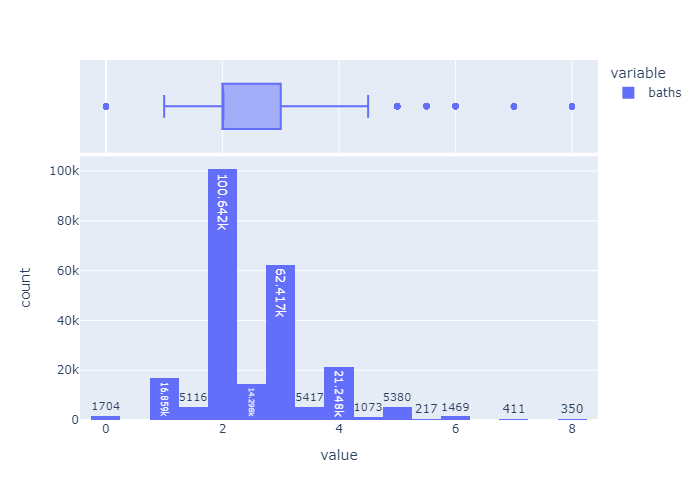

In [221]:
df.loc[df['baths']>8,'baths'] = 8
df['baths'] = df['baths'].apply(round_baths)
df['baths'] = df['baths'].apply(lambda x: np.round(x) if x>6 else x)
df['baths'] = df['baths'].apply(lambda x: 1 if x==0.5 else x)
px.histogram(df['baths'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

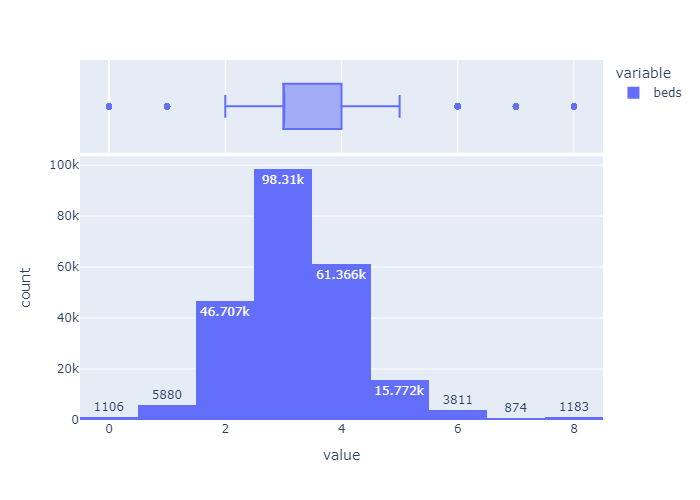

In [222]:
df.loc[df['beds']>8,'beds'] = 8
px.histogram(df['beds'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

In [223]:
df[df['sqft']>9*10**5][['stories','status','propertyType','beds','baths','firepl','sqft','lotsize','pool','Year_built','target']]

,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,pool,Year_built,target
9398,NaN,NaN,NaN,NaN,NaN,False,2746458.0,2746458.0,False,NaN,900000.0
78470,NaN,NaN,NaN,NaN,NaN,False,1366477.2,1366477.2,False,NaN,170000.0
132471,NaN,NaN,NaN,NaN,NaN,False,1039777.2,1039777.2,False,NaN,293500.0
139392,NaN,NaN,NaN,NaN,NaN,False,1154340.0,1154340.0,False,NaN,370000.0
144810,NaN,NaN,NaN,NaN,NaN,False,2565684.0,2565684.0,False,NaN,1199000.0
158819,NaN,NaN,NaN,NaN,NaN,False,4443120.0,4443120.0,False,NaN,900000.0
180316,NaN,NaN,NaN,NaN,NaN,False,980100.0,980100.0,False,NaN,378000.0
208249,NaN,NaN,NaN,NaN,NaN,False,1026273.6,1026273.6,False,NaN,149900.0
209667,NaN,NaN,NaN,NaN,NaN,False,989683.2,989683.2,False,NaN,35000.0
221614,NaN,Active,NaN,NaN,2.5,False,2585006.0,2585006.0,False,NaN,138000.0


Большей частью это бесполезные данные сплошь из NaN

In [224]:
df = df[df['sqft']<9*10**5]

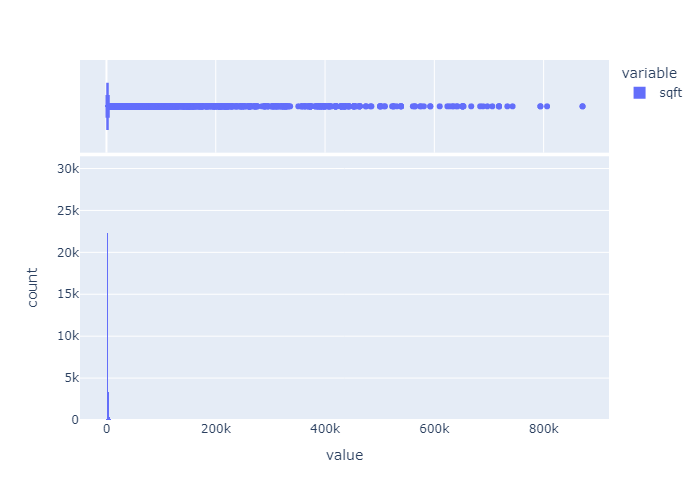

In [225]:
px.histogram(df['sqft'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

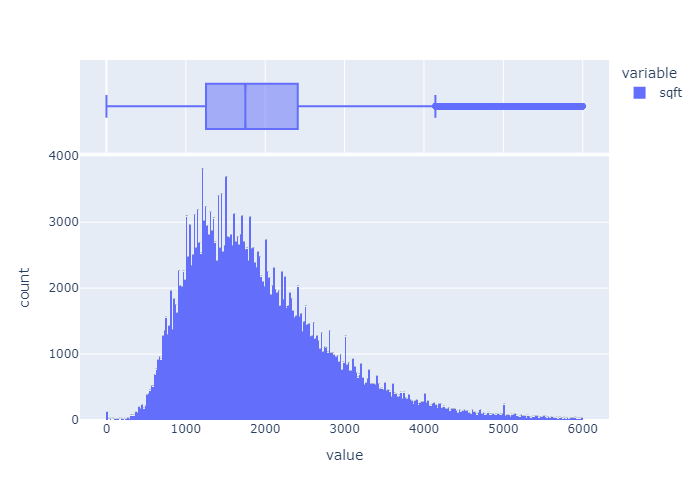

In [226]:
df = df[df['sqft']<6000]
px.histogram(df['sqft'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

In [227]:
temp = df[df['sqft']>5*10**5 ]

temp = temp[temp['stories'].notna() & temp['beds'].notna() & temp['baths'].notna()][['state','city',
                        'stories','status','propertyType','beds','baths','firepl','sqft','lotsize','pool','Year_built','target']]
temp

,state,city,stories,status,propertyType,beds,baths,firepl,sqft,lotsize,pool,Year_built,target


Впечатление, что неправильно поставили запятую. 

In [228]:
df[['street','city', 'state','zipcode',	]][:1]

,street,city,state,zipcode
0,240 Heather Ln,Southern Pines,NC,28387


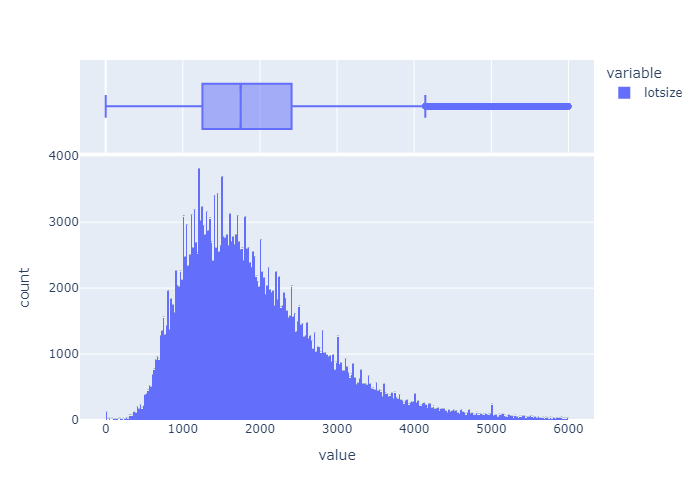

In [229]:
df = df[df['lotsize']<1*10**5]

px.histogram(df['lotsize'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

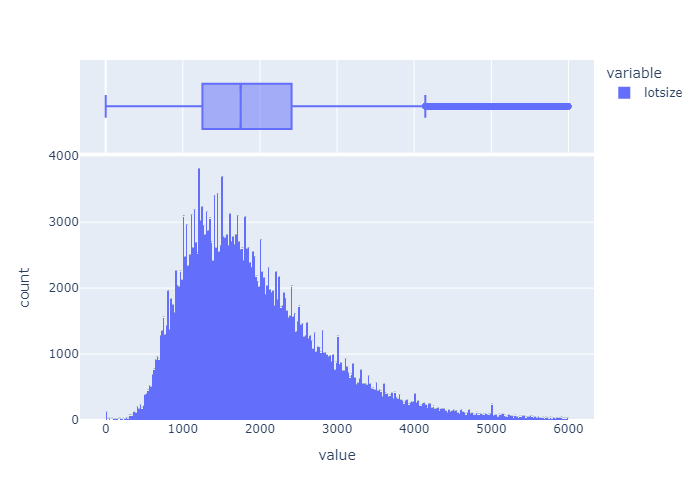

In [230]:
df = df[df['lotsize']<6000]

px.histogram(df['lotsize'],
             marginal='box',
             orientation='v',
             text_auto=True,).show('png')

In [231]:
crime = pd.read_table(r"data\Crime Rate.txt")
crime.columns = ['state','Crime Rate']
crime.state = crime.state.replace(short_state_name)
crime['Crime Rate'] = crime['Crime Rate'].str.replace(',','.')
crime['Crime Rate'] = crime['Crime Rate'].astype(np.float32)
rows_to_append = [{'state':  'DC', 'Crime Rate': crime['Crime Rate'].median()}]
crime = pd.concat([crime,pd.DataFrame(rows_to_append)],axis=0,ignore_index=True)

# сохранение
with open('data/crime.pkl', 'wb') as output:
    pickle.dump(crime, output)


crime

,state,Crime Rate
0,AL,4.727
1,AK,5.359
2,AZ,4.940
3,AR,5.899
4,CA,4.720
5,CO,6.091
6,CT,3.312
7,DE,4.355
8,FL,3.922
9,GA,4.415


In [232]:
df = df.merge(crime, how='left',on='state')

In [233]:
# df = pd.get_dummies(df, columns=['baths','beds'])

In [234]:
df =df.drop(['Heating', 'land', 'Parking','Cooling','stories', 'beds_copy','bath_copy','status','propertyType',
            'Townhouse_s', 'Condo_s', 'Farms/Ranches__s', 'home_s', 'land_s','fan_f', 'sqft_beds','acres_beds',
            'street','aircondi_h','central_heating_c','electric_heating_c','fan_f','fan_h', 'central_heating_c',
            'forced_air_heating_c','furnace_heating_c','gas_heating_c','pump_heating_c', '1_level -','2_level -',
            '3_level -','4_level -','1_level_t', '1_level-t', '1,5_level_t','2_level_t', '2_level-t', '3_level_t',
            '3_level-t', '4_level_t', '4_level-t','2_level_frpl','baths_frpl','beds_frpl','fan_f','heat_pump_f',
            'baths_sq','sqft_copy', 'strange_sqft','apartment_s','apartment','str_number_baths','str_number_beds',
            'furnace_heating','stories_sqft','multi_level_t','lease','multi_family_s','1,5_level','multiple_occupancy',
            'zipcode','state','city'
              ],axis=1).copy()

In [235]:
sorted(df.columns,key=str.lower)

['1_level',
 '2_level',
 '3_level',
 '4_level',
 'air_conditioner',
 'auction',
 'baths',
 'beds',
 'Carport',
 'ceiling_fan',
 'central_heating',
 'city_is_big',
 'city_is_capital',
 'city_is_large',
 'city_is_million',
 'claster',
 'condo',
 'cool_bool',
 'Crime Rate',
 'distance_capital',
 'distance_million',
 'electric_heating',
 'Farms/Ranches',
 'firepl',
 'forced_air_heating',
 'foreclosure',
 'Garage',
 'gas_heating',
 'HDI (2021)',
 'heat_bool',
 'lotsize',
 'multi_family',
 'multi_level',
 'new',
 'number_school',
 'Parking_lot',
 'pool',
 'PublicSchoolOverallRanking',
 'pump_heating',
 'Remodeled',
 'school_distance_mean',
 'school_rating_mean',
 'Single Family Home',
 'sqft',
 'target',
 'Townhouse',
 'Year_built']

In [236]:
df.shape

(284051, 47)

In [237]:
df = df.reset_index(drop=True)

In [238]:
# задаём уровень значимости
alpha = 0.01

# проводим тест Шапиро — Уилка
_, p = shapiro(df['target'])

print('p-value = %.3f' % (p))

# интерпретируем результат
if p <= alpha:
    print('Распределение не нормальное')
else:
    print('Распределение нормальное')



p-value = 0.000
Распределение не нормальное


c:\Users\olgas\anaconda3\envs\py_virt\lib\site-packages\scipy\stats\_morestats.py:1816: UserWarning:

p-value may not be accurate for N > 5000.



In [239]:
# проводим тест Колмогорова-Смирнова
_, p = kstest(df['target'], 'norm')

print('p-value = %.3f' % (p))

# интерпретируем результат
if p <= alpha:
    print('Распределение не нормальное')
else:
    print('Распределение нормальное')

p-value = 0.000
Распределение не нормальное


In [240]:
# И еще один тест на нормальность! Тест Жарка-Бера
_, p = jarque_bera(df['target'])

print('p-value = %.3f' % (p))

# интерпретируем результат
if p <= alpha:
    print('Распределение не нормальное')
else:
    print('Распределение нормальное')

p-value = 0.000
Распределение не нормальное


Приведем к нормальному виду, заодно проведем нормализацию с нулевым средним и единичной дисперсией

In [241]:
# trans_target = PowerTransformer()
# df['target'] = trans_target.fit_transform(df[['target']].to_numpy())
# px.histogram(df['target'],
#              marginal='box',
#              orientation='v',
#              text_auto=True,).show('png')

# # обратная трансформация
# trans_target.inverse_transform(X=df[['target']].to_numpy())

In [242]:
# # Производим сериализацию и записываем в файл формата pkl
# with open(r'web\app\models\trans_target.pkl', 'wb') as output:
#     pickle.dump(trans_target, output)

In [243]:
# сохранение
# Производим сериализацию и записываем результат в файл формата pkl
with open('data/df.pkl', 'wb') as output:
    pickle.dump(df, output)


df.to_csv('data/df.csv',
          index_label=False
          )

In [244]:
# Производим десериализацию и извлекаем из файла формата pkl
with open('data/df.pkl', 'rb') as pkl_file:
    df = pickle.load(pkl_file)

In [245]:
df.shape

(284051, 47)

In [246]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284051 entries, 0 to 284050
Data columns (total 47 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   baths                       231268 non-null  float64
 1   sqft                        284051 non-null  float64
 2   beds                        229584 non-null  float64
 3   target                      284051 non-null  float64
 4   city_is_capital             284051 non-null  bool   
 5   city_is_million             284051 non-null  bool   
 6   city_is_big                 284051 non-null  bool   
 7   city_is_large               284051 non-null  bool   
 8   claster                     284029 non-null  float64
 9   distance_capital            284029 non-null  float64
 10  distance_million            284029 non-null  float64
 11  firepl                      284051 non-null  bool   
 12  1_level                     284051 non-null  bool   
 13  2_level       

In [247]:
sorted(df.columns,key=str.lower)

['1_level',
 '2_level',
 '3_level',
 '4_level',
 'air_conditioner',
 'auction',
 'baths',
 'beds',
 'Carport',
 'ceiling_fan',
 'central_heating',
 'city_is_big',
 'city_is_capital',
 'city_is_large',
 'city_is_million',
 'claster',
 'condo',
 'cool_bool',
 'Crime Rate',
 'distance_capital',
 'distance_million',
 'electric_heating',
 'Farms/Ranches',
 'firepl',
 'forced_air_heating',
 'foreclosure',
 'Garage',
 'gas_heating',
 'HDI (2021)',
 'heat_bool',
 'lotsize',
 'multi_family',
 'multi_level',
 'new',
 'number_school',
 'Parking_lot',
 'pool',
 'PublicSchoolOverallRanking',
 'pump_heating',
 'Remodeled',
 'school_distance_mean',
 'school_rating_mean',
 'Single Family Home',
 'sqft',
 'target',
 'Townhouse',
 'Year_built']

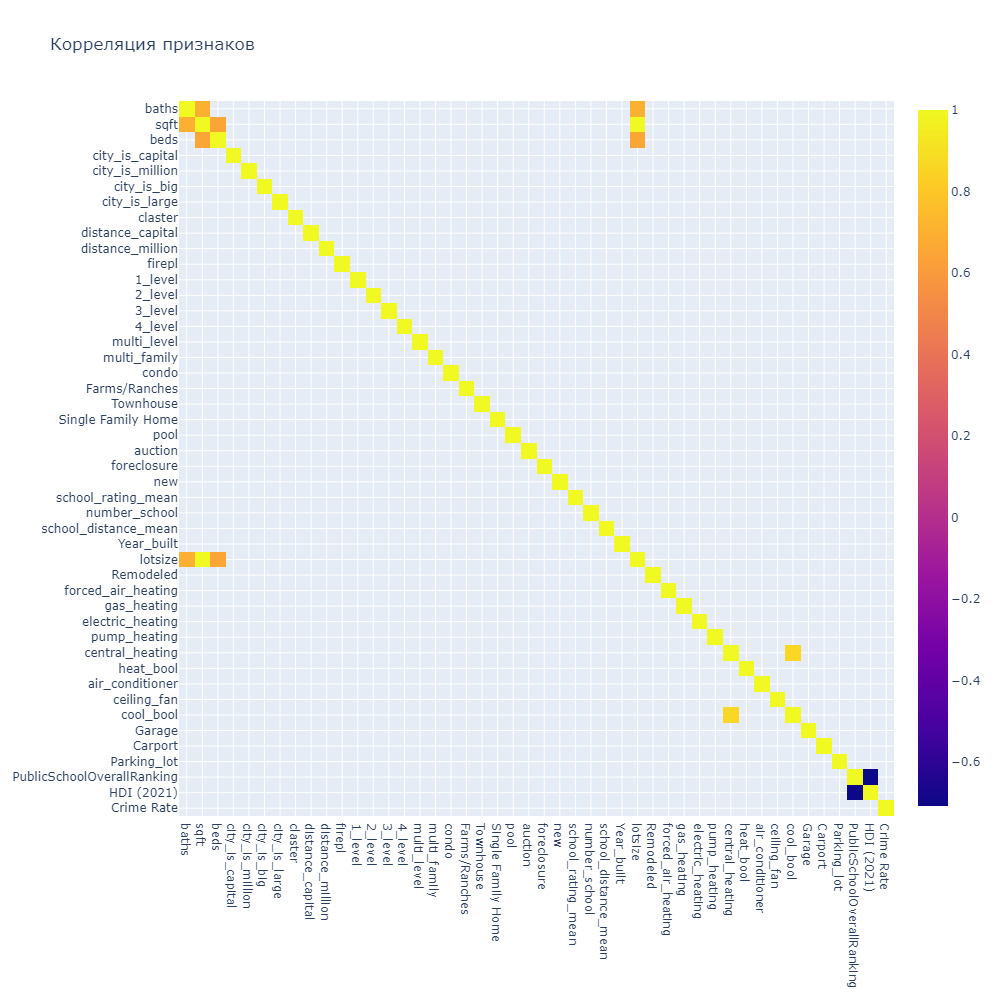

In [248]:
# object_bool_columns = [s for s in df.columns if df[s].dtypes == 'object' or df[s].dtypes == 'bool']
# temp = df.drop(object_bool_columns, axis = 1).corr()

object_columns = [s for s in df.columns if df[s].dtypes == 'object']
temp = df.drop(object_columns, axis = 1).drop('target', axis = 1).corr()

px.imshow(temp[abs(temp)>0.6],
                width = 1000,
                height  = 1000,
                title = 'Корреляция признаков',
                # text_auto=True
                ).show('png')